In [1]:
import ultralytics

pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.3/41.3 kB 3.0 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.

In [ ]:
import cv2
import torch
import torchvision.transforms as transforms
from PIL import Image
from ultralytics import YOLO
from torch.nn import Module
from torchvision import models
import torch.nn as nn
from google.colab.patches import cv2_imshow
import numpy as np

In [3]:
# Dictionary of index and labels from the ResNet model
index_to_class_items = ([('aerosol_cans_garbage', 0), ('aluminum_food_cans_recycling', 1), ('aluminum_soda_cans_recycling', 2),
('cardboard_boxes_recycling', 3), ('cardboard_packaging_recycling', 4), ('clothing_garbage', 5),
('coffee_grounds_organic', 6), ('disposable_plastic_cutlery_garbage', 7), ('eggshells_organic', 8),
('food_waste_organic', 9), ('glass_beverage_bottles_recycling', 10), ('glass_cosmetic_containers_recycling', 11),
('glass_food_jars_recycling', 12), ('magazines_recycling', 13), ('newspaper_recycling', 14),
('office_paper_recycling', 15), ('paper_cups_recycling', 16), ('plastic_cup_lids_recycling', 17),
('plastic_detergent_bottles_recycling', 18), ('plastic_food_containers_recycling', 19), ('plastic_shopping_bags_recycling', 20),
('plastic_soda_bottles_recycling', 21), ('plastic_straws_garbage', 22), ('plastic_trash_bags_garbage', 23),
('plastic_water_bottles_recycling', 24), ('shoes_garbage', 25), ('steel_food_cans_recycling', 26),
('styrofoam_cups_garbage', 27), ('styrofoam_food_containers_garbage', 28), ('tea_bags_organic', 29)])

index_to_class = {v: k for k, v in index_to_class_items}

In [4]:
# Function for Calcualating IOU

def calculate_iou(box1, box2):
    x1, y1, x2, y2 = box1
    x1_p, y1_p, x2_p, y2_p = box2

    # Calculate the intersection coordinates
    xi1 = max(x1, x1_p)
    yi1 = max(y1, y1_p)
    xi2 = min(x2, x2_p)
    yi2 = min(y2, y2_p)

    # Calculate the area of intersection
    inter_area = max(0, xi2 - xi1) * max(0, yi2 - yi1)

    # Calculate the area of both bounding boxes
    box1_area = (x2 - x1) * (y2 - y1)
    box2_area = (x2_p - x1_p) * (y2_p - y1_p)

    # Calculate the union area
    union_area = box1_area + box2_area - inter_area

    # Calculate the IoU
    iou = inter_area / union_area

    return iou

In [5]:
# Function to extract category from the label
def get_category(label):
    return label.split('_')[-1]

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)



0: 384x640 1 bottle, 1 toothbrush, 11.0ms
Speed: 2.1ms preprocess, 11.0ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     268.32      44.877      356.89      428.39]
Predicted category: garbage


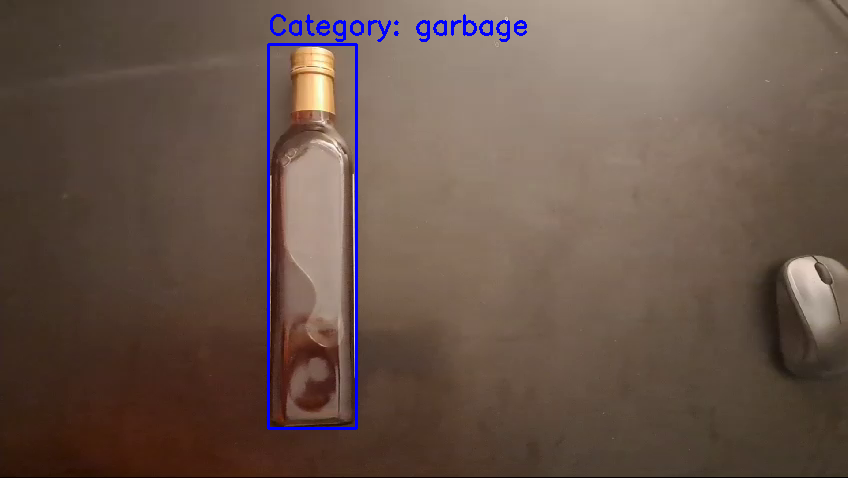


0: 384x640 1 bottle, 1 toothbrush, 9.7ms
Speed: 2.7ms preprocess, 9.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     267.16      45.285      356.01      429.21]
Predicted category: garbage


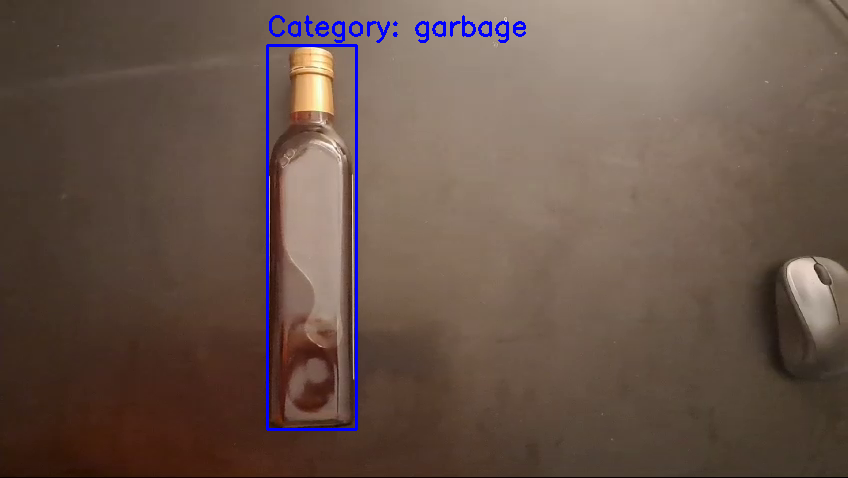


0: 384x640 1 bottle, 1 toothbrush, 11.9ms
Speed: 3.0ms preprocess, 11.9ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     264.79      46.826      355.06      433.28]
Predicted category: garbage


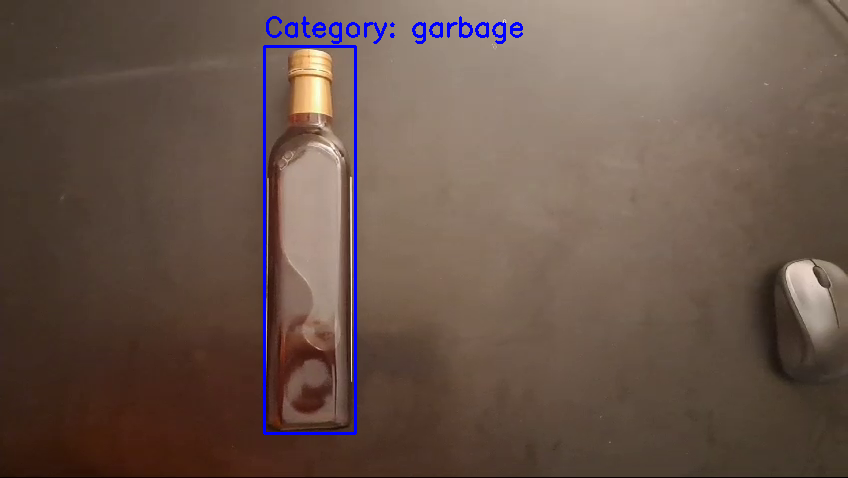


0: 384x640 1 bottle, 1 toothbrush, 9.8ms
Speed: 2.6ms preprocess, 9.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     263.77      47.748      354.27      432.22]
Predicted category: garbage


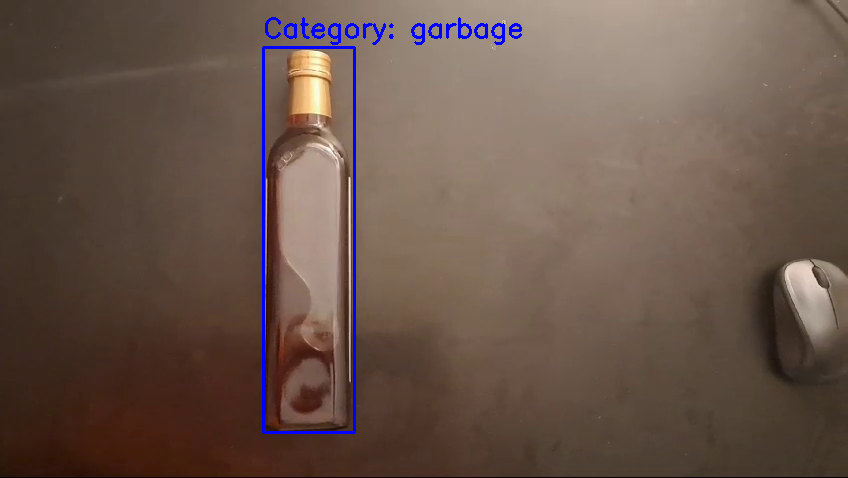


0: 384x640 1 bottle, 1 toothbrush, 10.4ms
Speed: 2.5ms preprocess, 10.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     262.59      47.593       353.5      432.43]
Predicted category: garbage


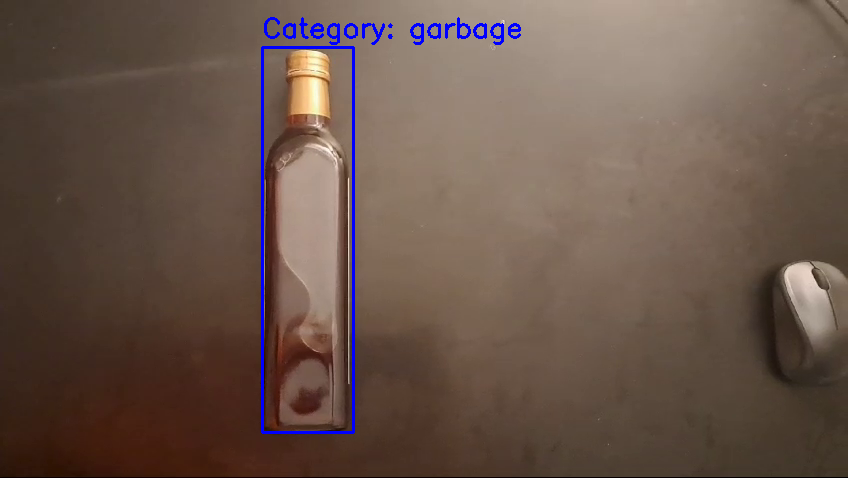


0: 384x640 1 bottle, 1 toothbrush, 9.3ms
Speed: 2.6ms preprocess, 9.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: glass_cosmetic_containers_recycling
Detected box: [     261.97      48.937      352.36      434.05]
Predicted category: recycling


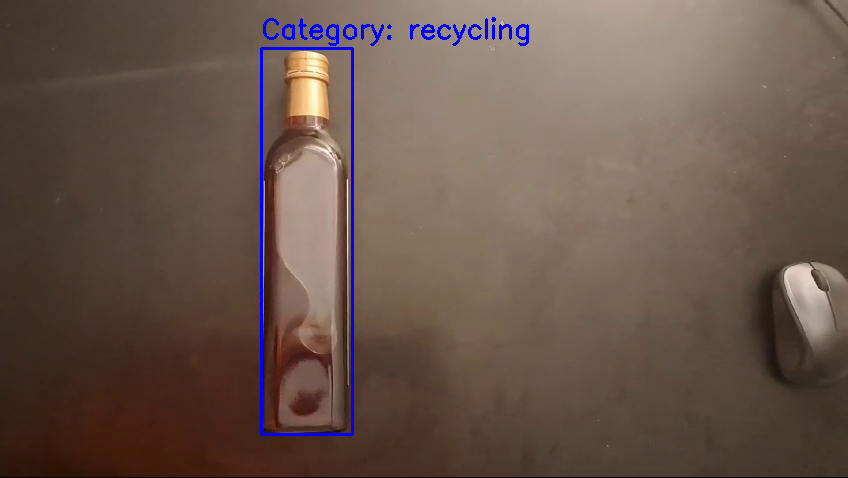


0: 384x640 1 bottle, 1 toothbrush, 10.6ms
Speed: 2.7ms preprocess, 10.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     261.98      50.436      352.36      436.16]
Predicted category: garbage


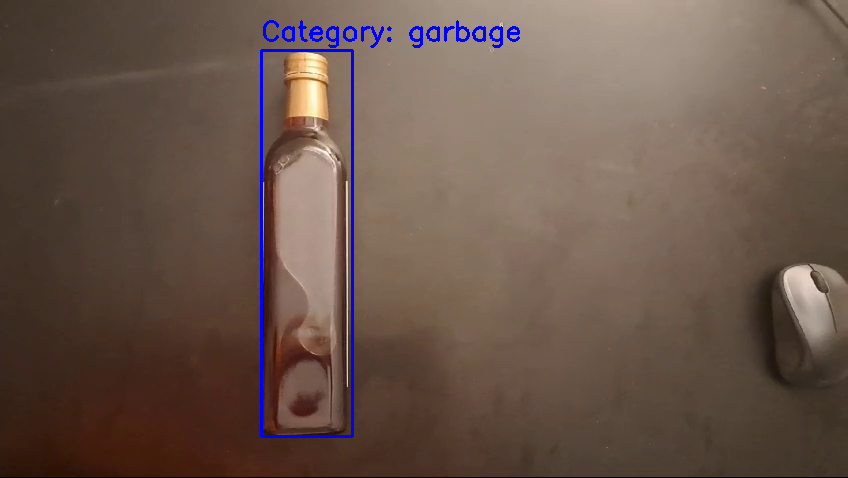


0: 384x640 1 bottle, 1 toothbrush, 14.9ms
Speed: 2.7ms preprocess, 14.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     261.43      51.707       351.6      436.53]
Predicted category: garbage


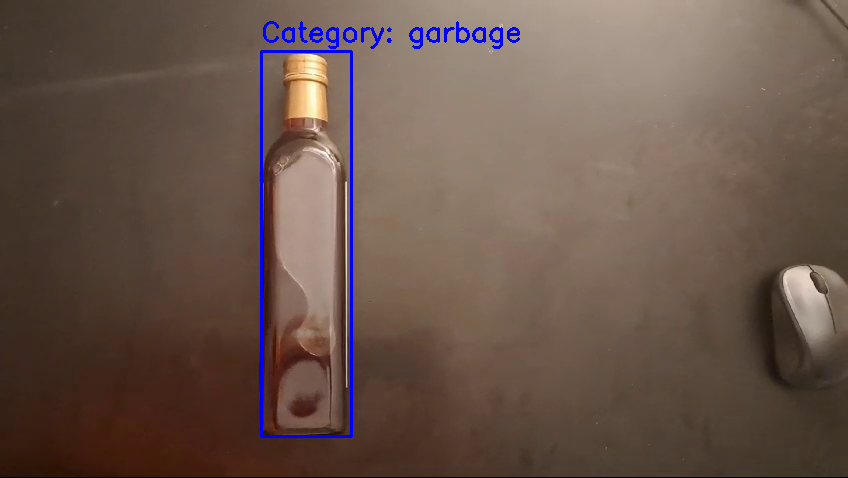


0: 384x640 1 bottle, 1 toothbrush, 10.7ms
Speed: 2.8ms preprocess, 10.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     260.31      52.403      350.84       436.4]
Predicted category: garbage


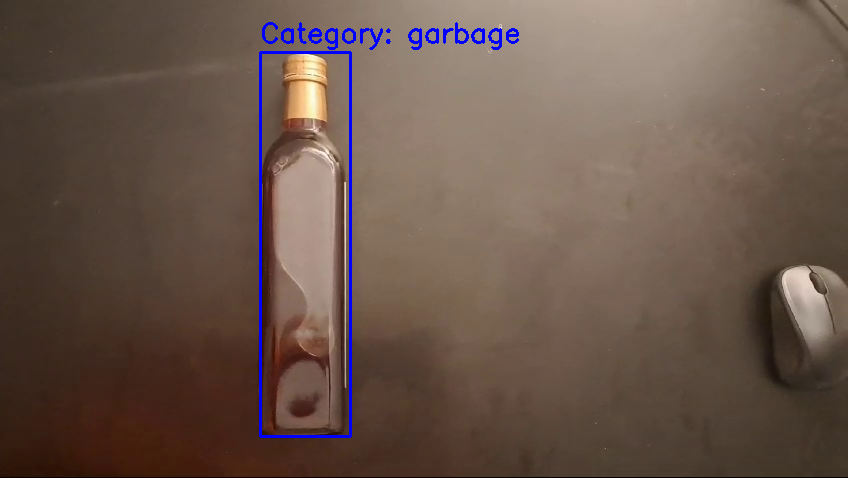


0: 384x640 1 bottle, 1 mouse, 1 toothbrush, 10.2ms
Speed: 2.6ms preprocess, 10.2ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     259.61      52.941      351.12      437.31]
Predicted category: garbage
Predicted classes: plastic_detergent_bottles_recycling
Detected box: [     766.24      264.19       847.6      389.64]
Predicted category: recycling


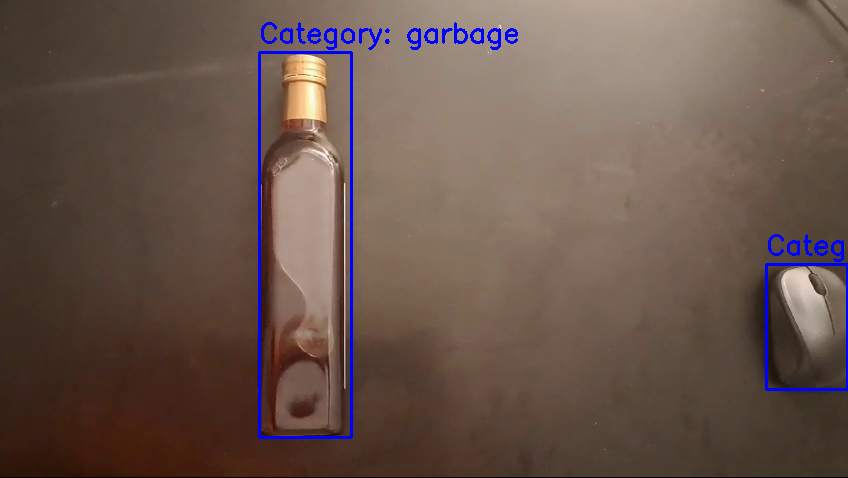


0: 384x640 1 bottle, 1 mouse, 1 toothbrush, 15.1ms
Speed: 2.8ms preprocess, 15.1ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [      258.9      53.405       349.6      437.46]
Predicted category: garbage
Predicted classes: plastic_detergent_bottles_recycling
Detected box: [     765.84      264.66      847.59      390.57]
Predicted category: recycling


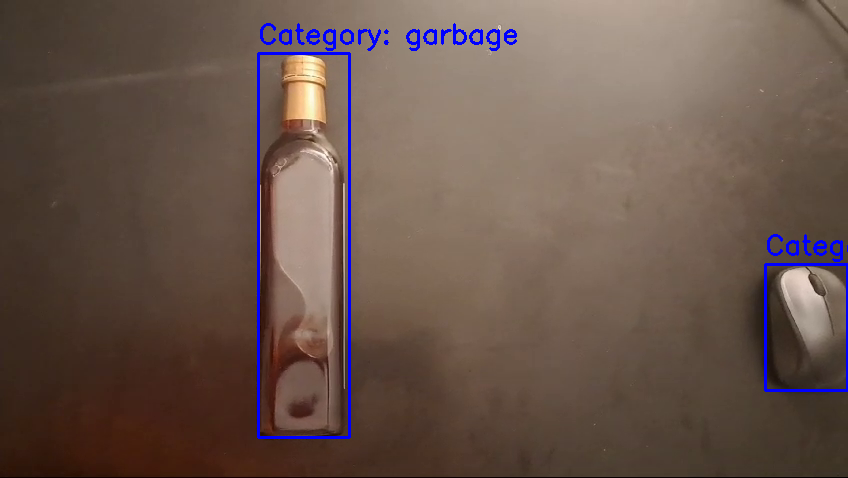


0: 384x640 1 bottle, 1 mouse, 1 toothbrush, 10.4ms
Speed: 2.8ms preprocess, 10.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     257.93      53.526      349.64       437.8]
Predicted category: garbage
Predicted classes: eggshells_organic
Detected box: [     765.62      264.88      847.58       391.7]
Predicted category: organic


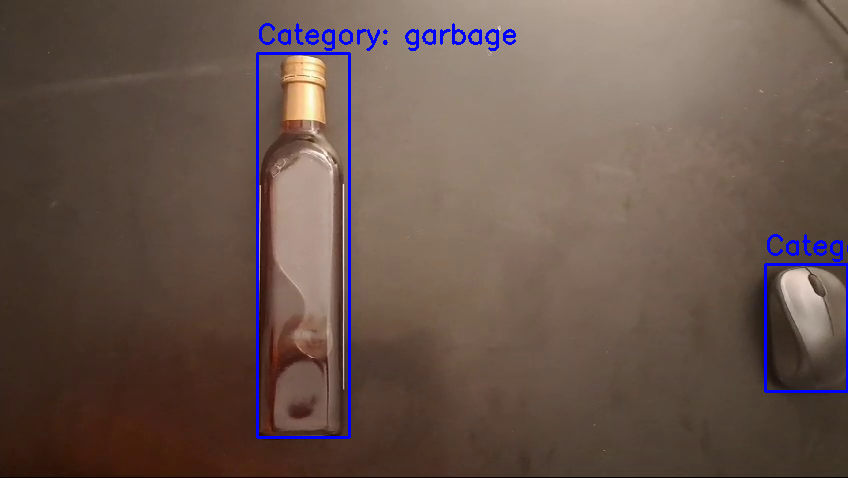


0: 384x640 1 bottle, 1 toothbrush, 9.6ms
Speed: 2.6ms preprocess, 9.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     257.12      53.993      349.26      439.97]
Predicted category: garbage


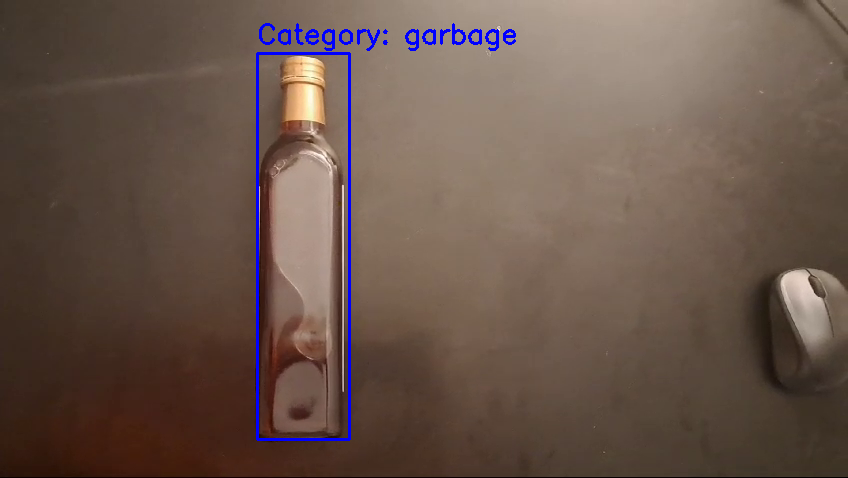


0: 384x640 1 bottle, 1 toothbrush, 9.9ms
Speed: 2.9ms preprocess, 9.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     256.93      53.991       349.5      440.04]
Predicted category: garbage


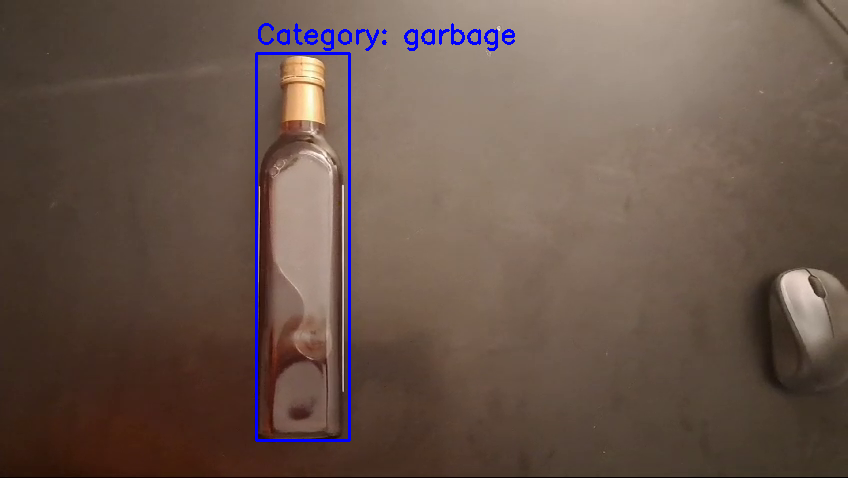


0: 384x640 1 bottle, 1 mouse, 1 vase, 1 toothbrush, 12.6ms
Speed: 2.7ms preprocess, 12.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     254.31      56.765      349.27      445.11]
Predicted category: garbage
Predicted classes: plastic_detergent_bottles_recycling
Detected box: [     763.64      269.37      847.63      395.92]
Predicted category: recycling


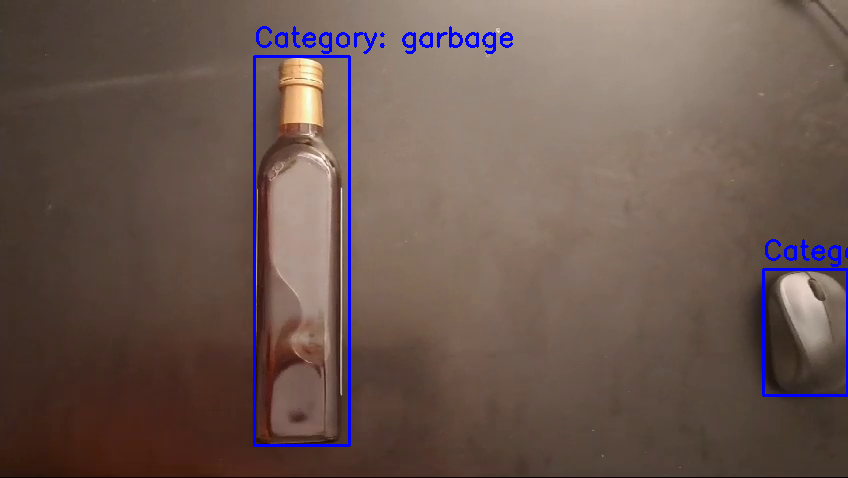


0: 384x640 1 bottle, 1 mouse, 1 vase, 1 toothbrush, 9.4ms
Speed: 2.8ms preprocess, 9.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     252.06      57.284      347.96      444.93]
Predicted category: garbage
Predicted classes: plastic_detergent_bottles_recycling
Detected box: [     763.53      271.44      847.62      399.16]
Predicted category: recycling


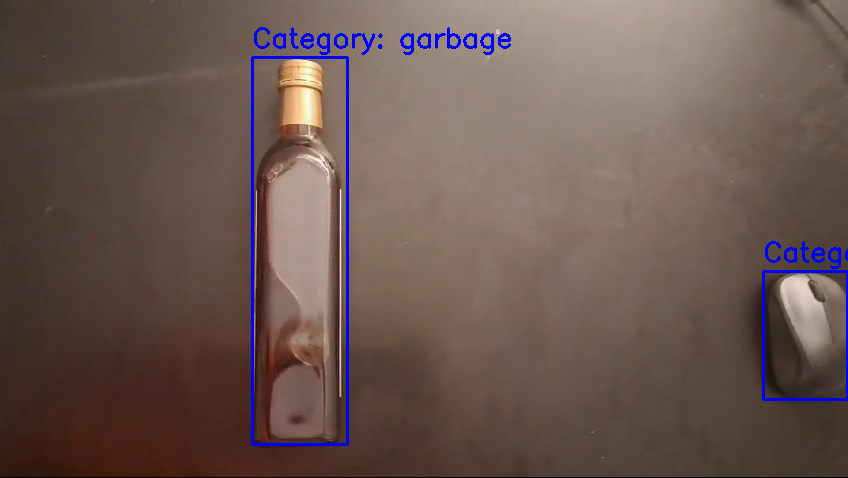


0: 384x640 1 bottle, 1 mouse, 1 vase, 1 toothbrush, 20.1ms
Speed: 2.9ms preprocess, 20.1ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     250.45      58.853      347.65      445.12]
Predicted category: garbage
Predicted classes: plastic_detergent_bottles_recycling
Detected box: [      763.5      272.62      847.62      398.16]
Predicted category: recycling


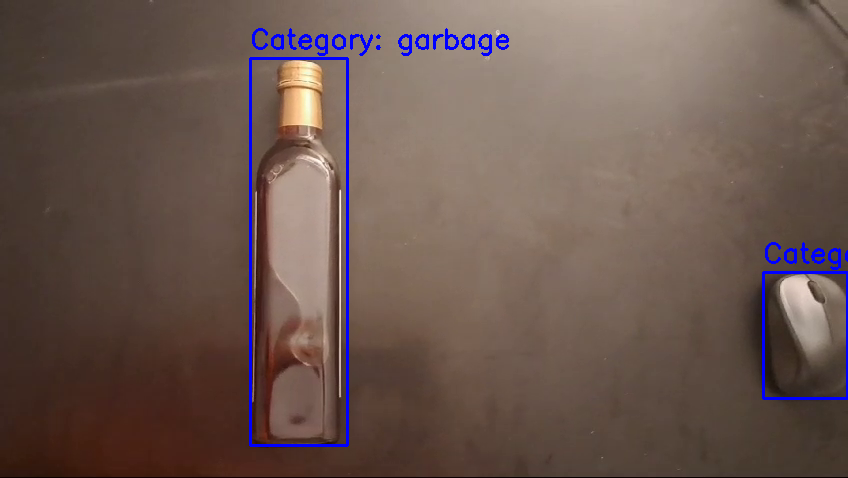


0: 384x640 1 bottle, 1 mouse, 1 vase, 1 toothbrush, 13.0ms
Speed: 3.1ms preprocess, 13.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     248.89      59.365      348.05      445.06]
Predicted category: garbage
Predicted classes: plastic_detergent_bottles_recycling
Detected box: [      763.2      273.04      847.61      399.39]
Predicted category: recycling


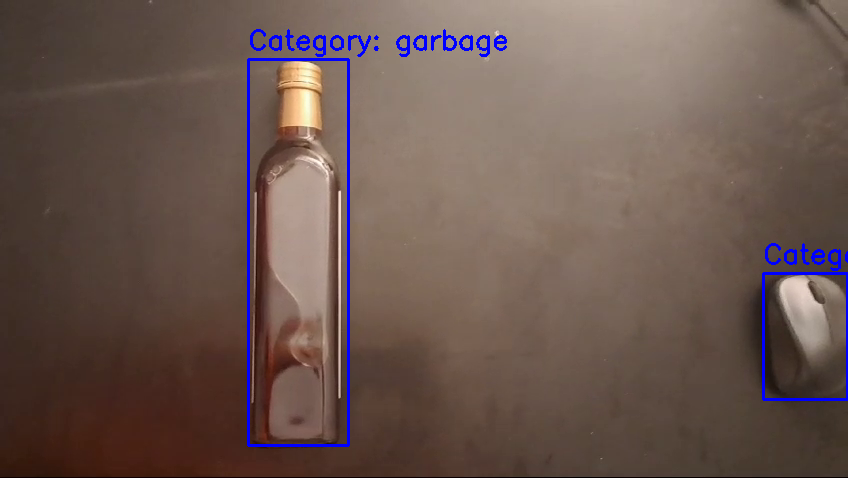


0: 384x640 1 bottle, 1 mouse, 1 vase, 1 toothbrush, 14.2ms
Speed: 4.7ms preprocess, 14.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     248.88      59.326      348.87      445.49]
Predicted category: garbage
Predicted classes: plastic_detergent_bottles_recycling
Detected box: [     762.91      273.02      847.61      399.72]
Predicted category: recycling


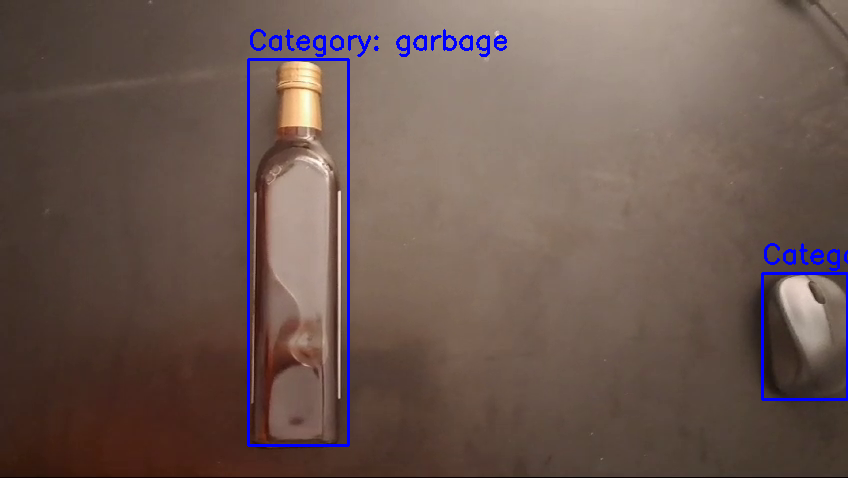


0: 384x640 1 bottle, 1 mouse, 1 vase, 1 toothbrush, 12.3ms
Speed: 2.5ms preprocess, 12.3ms inference, 4.4ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [      248.8      59.774      347.93      446.64]
Predicted category: garbage
Predicted classes: plastic_detergent_bottles_recycling
Detected box: [      763.7      273.92       847.6      401.11]
Predicted category: recycling


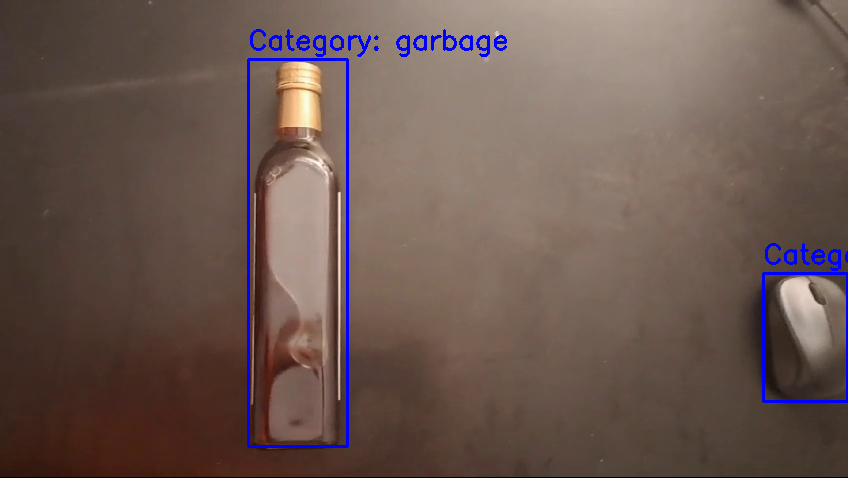


0: 384x640 1 bottle, 1 vase, 1 toothbrush, 10.3ms
Speed: 2.7ms preprocess, 10.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     248.66      60.169      347.78      448.75]
Predicted category: garbage


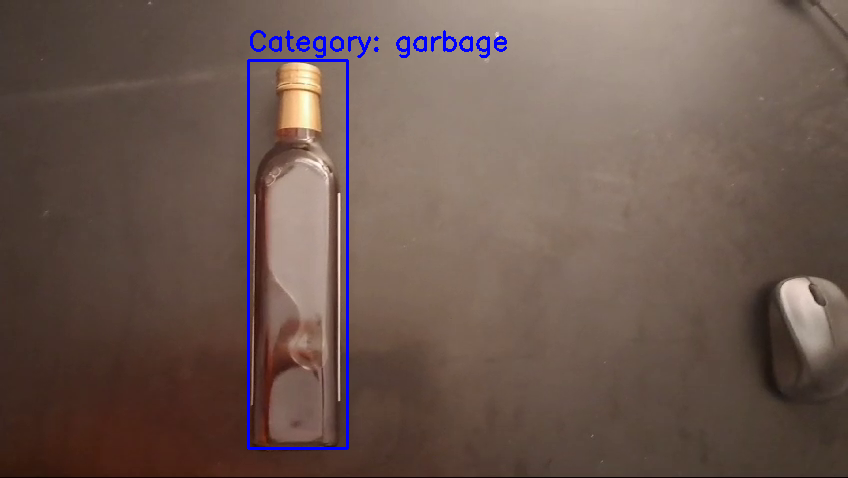


0: 384x640 1 bottle, 1 vase, 10.2ms
Speed: 2.6ms preprocess, 10.2ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     249.29       61.05      347.34      449.54]
Predicted category: garbage


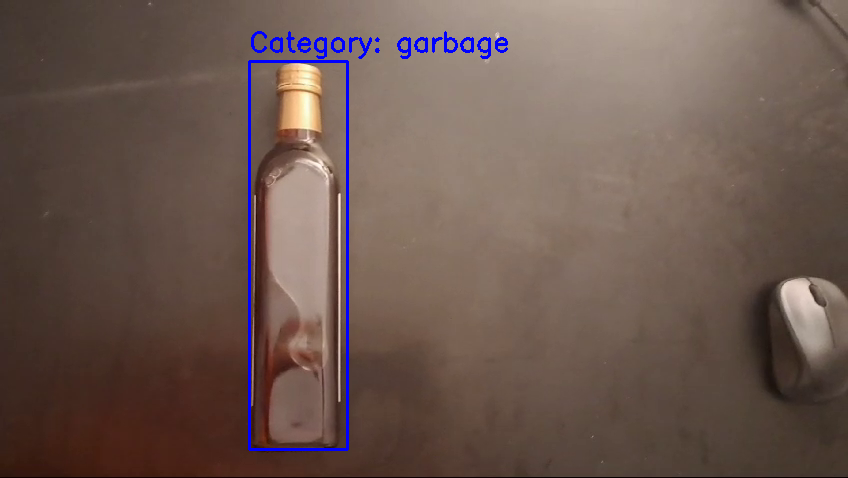


0: 384x640 1 bottle, 1 vase, 12.2ms
Speed: 2.7ms preprocess, 12.2ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     249.52      62.102       347.6      450.56]
Predicted category: garbage


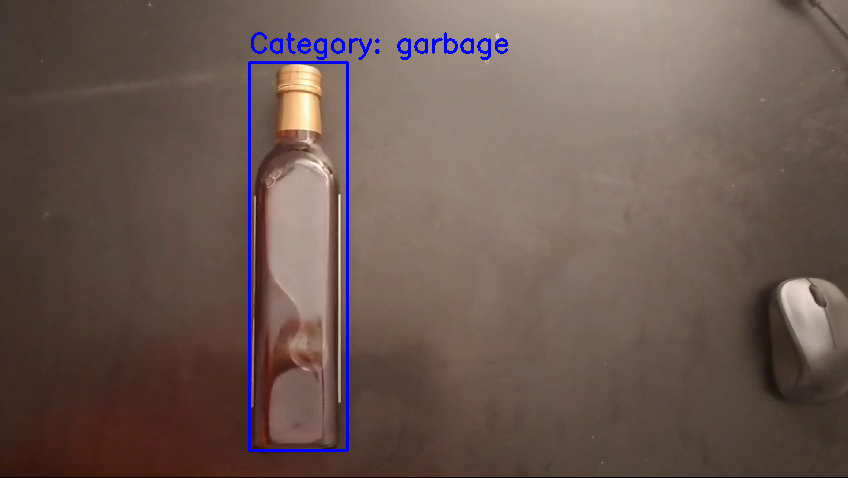


0: 384x640 1 bottle, 1 vase, 1 toothbrush, 9.6ms
Speed: 2.7ms preprocess, 9.6ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     249.93      62.794      347.53      450.76]
Predicted category: garbage


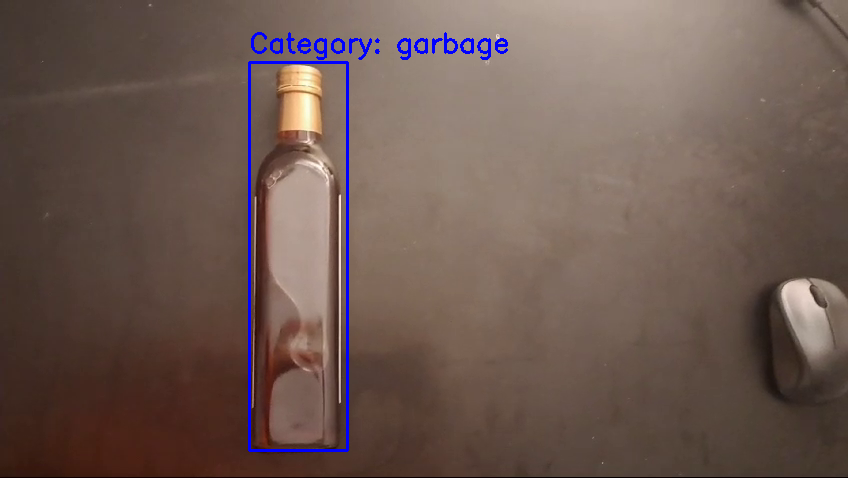


0: 384x640 1 bottle, 1 vase, 1 toothbrush, 9.5ms
Speed: 2.7ms preprocess, 9.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     250.28      63.264      347.37      452.04]
Predicted category: garbage


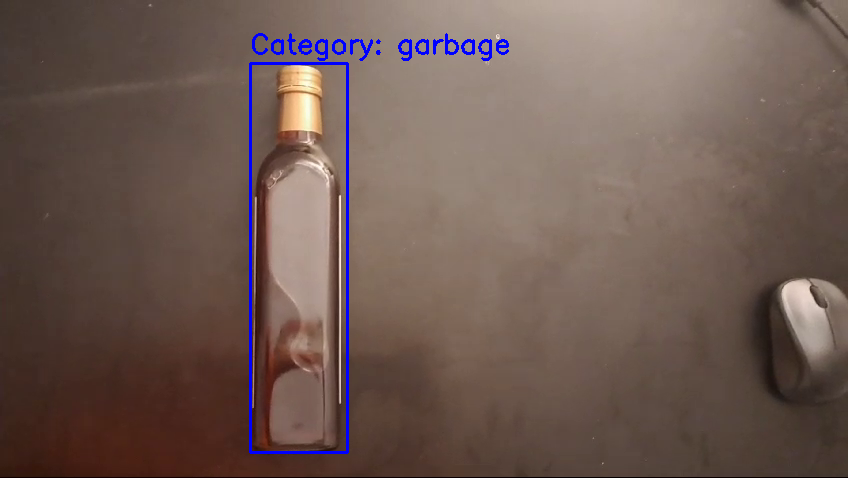


0: 384x640 1 bottle, 1 vase, 10.2ms
Speed: 2.6ms preprocess, 10.2ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [      251.4      63.627         347      453.81]
Predicted category: garbage


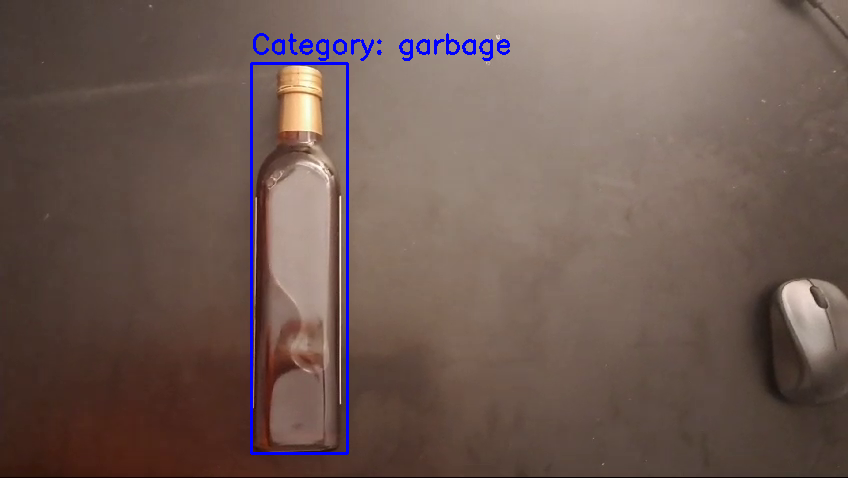


0: 384x640 1 bottle, 1 vase, 1 toothbrush, 64.5ms
Speed: 18.7ms preprocess, 64.5ms inference, 11.6ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     251.96      63.655      347.13      454.66]
Predicted category: garbage


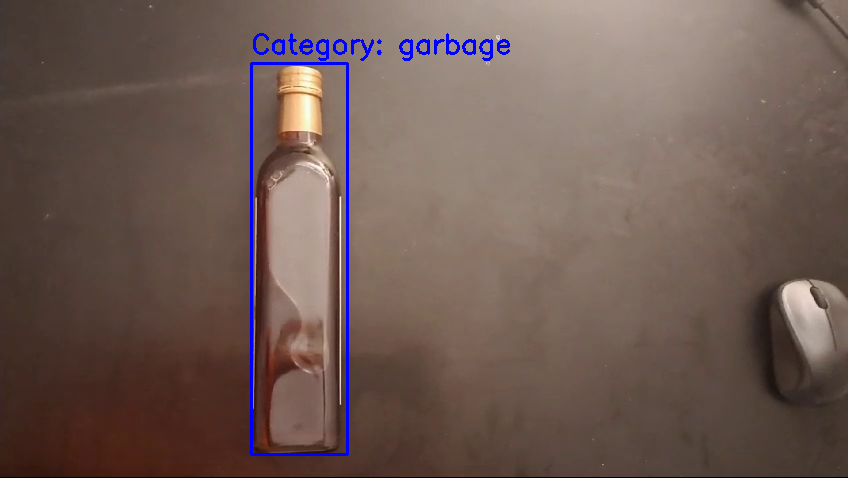


0: 384x640 1 bottle, 1 vase, 1 toothbrush, 20.2ms
Speed: 2.8ms preprocess, 20.2ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     252.62      63.814       347.8      455.92]
Predicted category: garbage


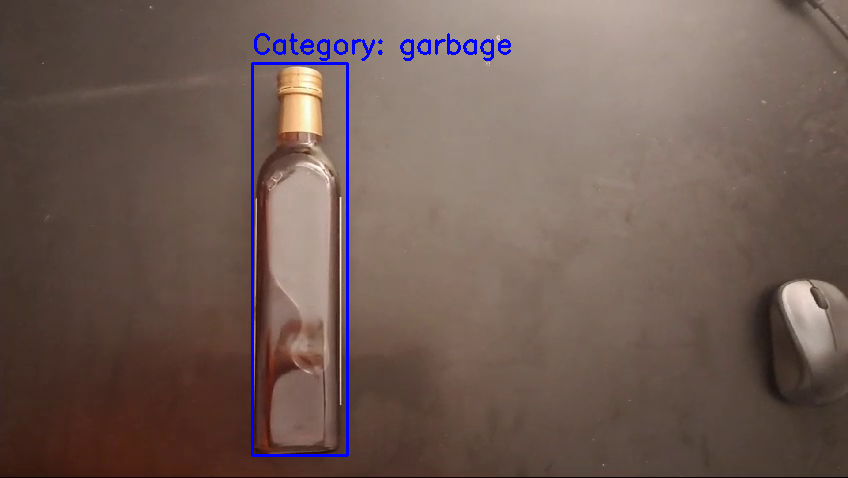


0: 384x640 1 bottle, 1 vase, 1 toothbrush, 9.4ms
Speed: 2.7ms preprocess, 9.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     254.05      64.211      348.93      455.64]
Predicted category: garbage


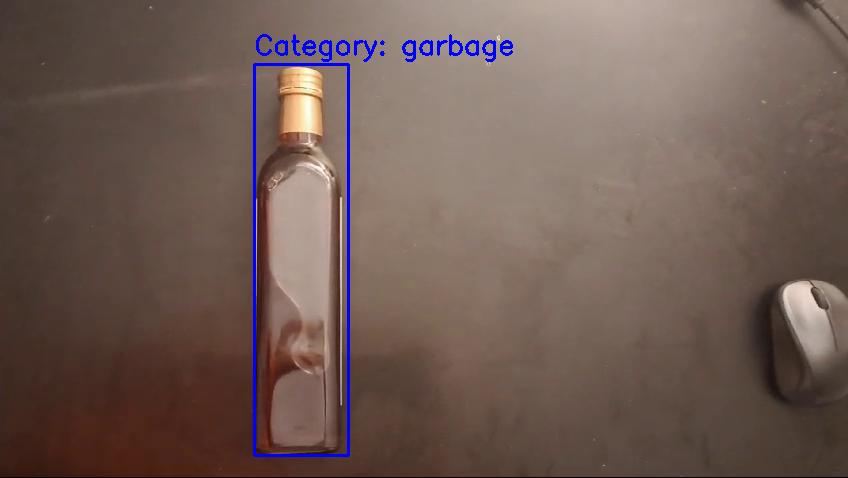


0: 384x640 1 bottle, 1 vase, 1 toothbrush, 11.8ms
Speed: 2.7ms preprocess, 11.8ms inference, 4.1ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     255.02      65.105      349.33      454.95]
Predicted category: garbage


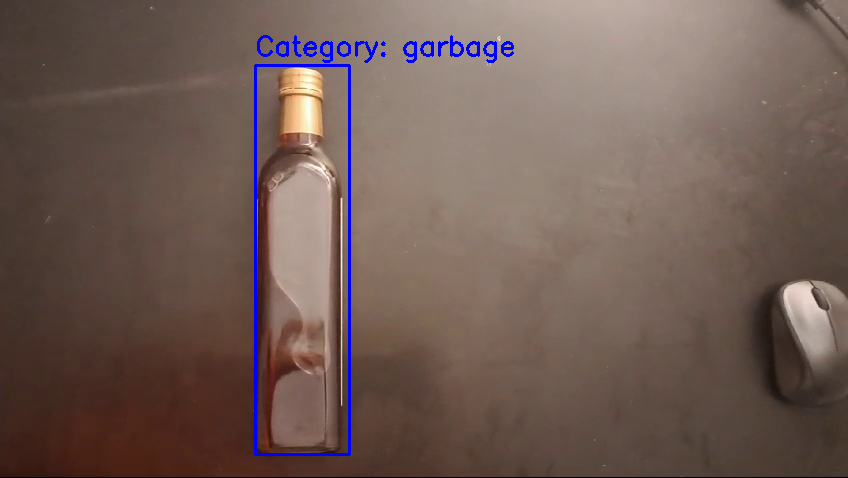


0: 384x640 1 bottle, 1 vase, 1 toothbrush, 33.3ms
Speed: 2.8ms preprocess, 33.3ms inference, 6.7ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: glass_cosmetic_containers_recycling
Detected box: [     254.59      65.392      349.64      458.34]
Predicted category: recycling


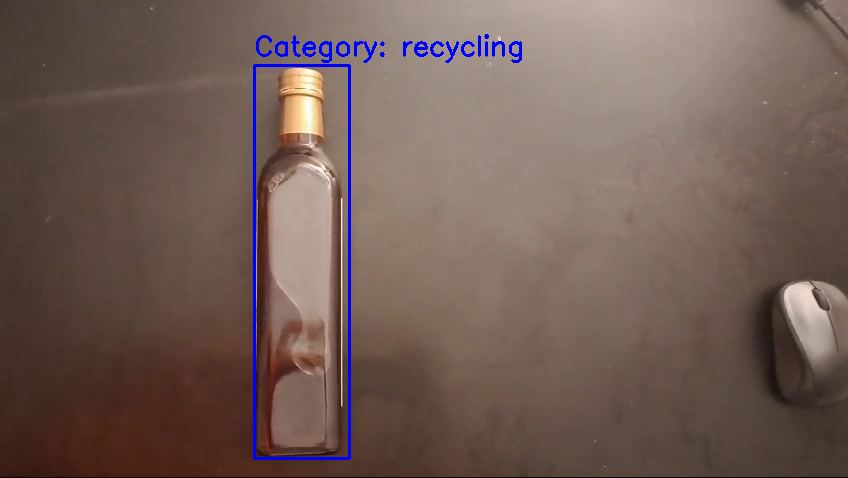


0: 384x640 1 bottle, 1 vase, 1 toothbrush, 10.9ms
Speed: 2.7ms preprocess, 10.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     254.56      65.543       349.4       458.2]
Predicted category: garbage


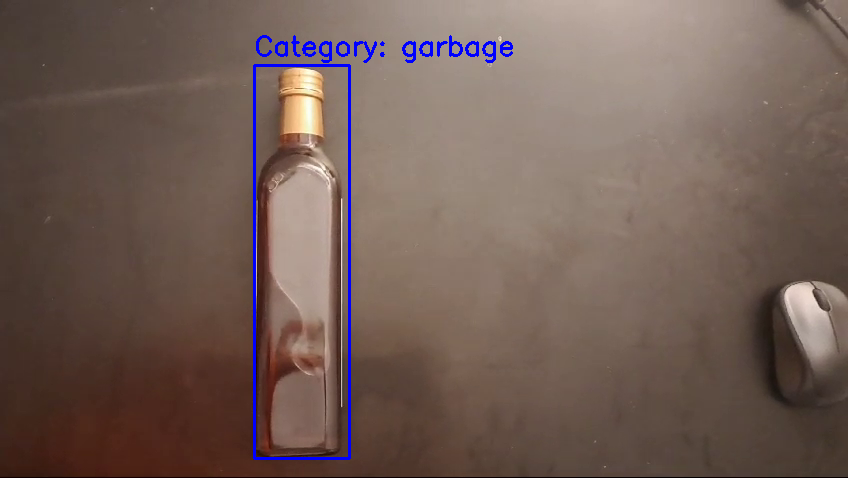


0: 384x640 1 bottle, 1 vase, 14.5ms
Speed: 2.8ms preprocess, 14.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     254.18      65.178      349.25      458.26]
Predicted category: garbage


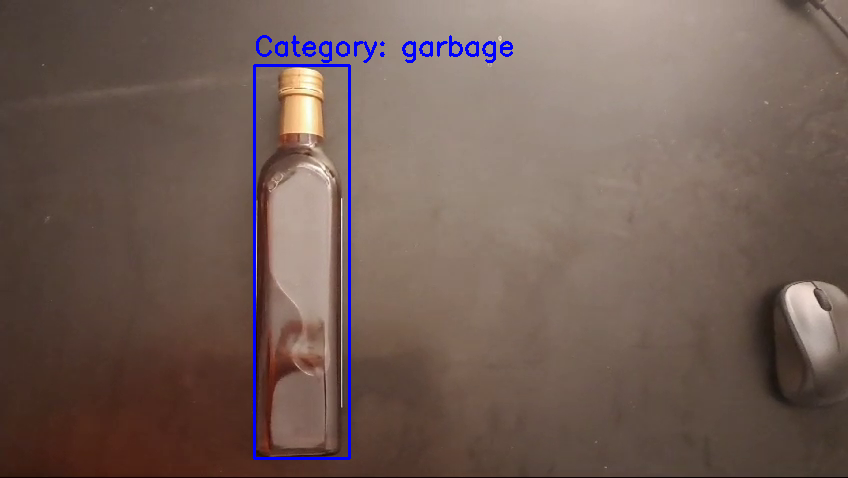


0: 384x640 1 bottle, 1 vase, 1 toothbrush, 17.7ms
Speed: 3.4ms preprocess, 17.7ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [      254.3      64.834      349.23      457.46]
Predicted category: garbage


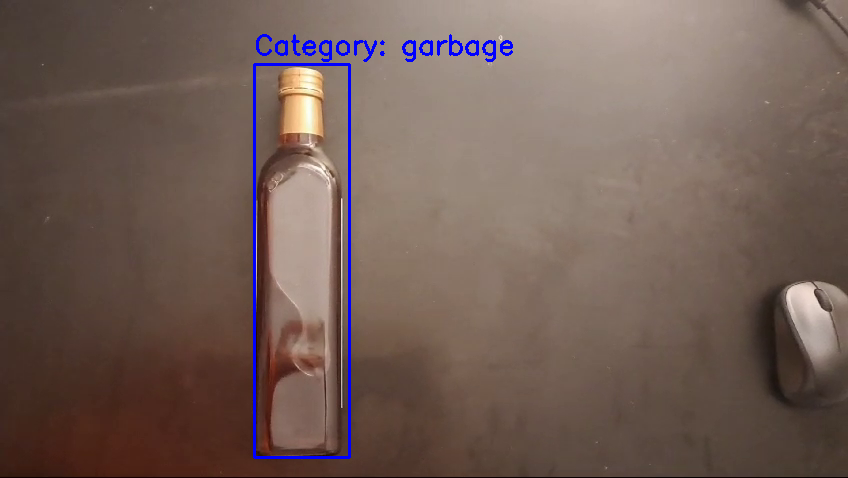


0: 384x640 1 bottle, 1 vase, 12.6ms
Speed: 2.6ms preprocess, 12.6ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     254.43      64.923      349.35       458.6]
Predicted category: garbage


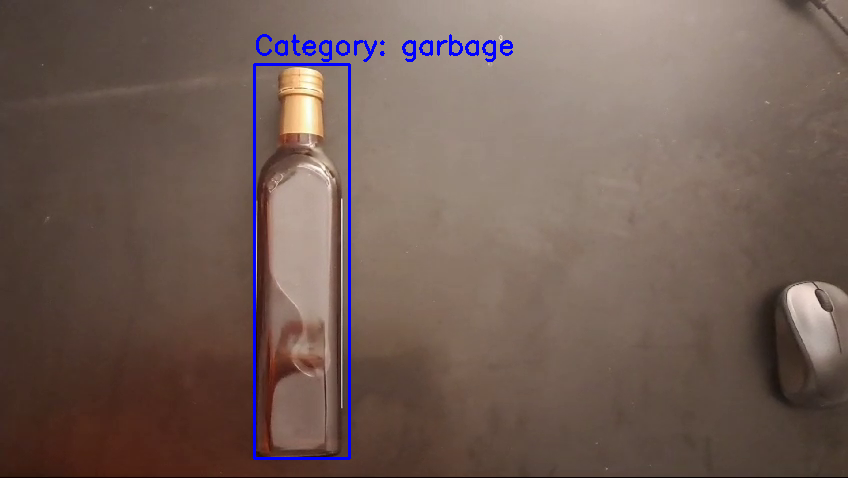


0: 384x640 1 bottle, 1 vase, 8.9ms
Speed: 2.6ms preprocess, 8.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     253.54      64.473      349.11      460.84]
Predicted category: garbage


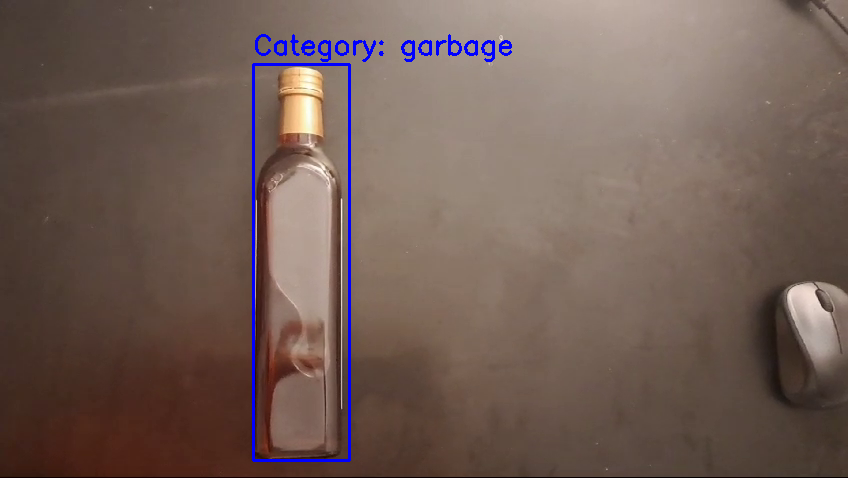


0: 384x640 1 bottle, 1 vase, 10.0ms
Speed: 2.9ms preprocess, 10.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     252.49      64.052      348.73      460.43]
Predicted category: garbage


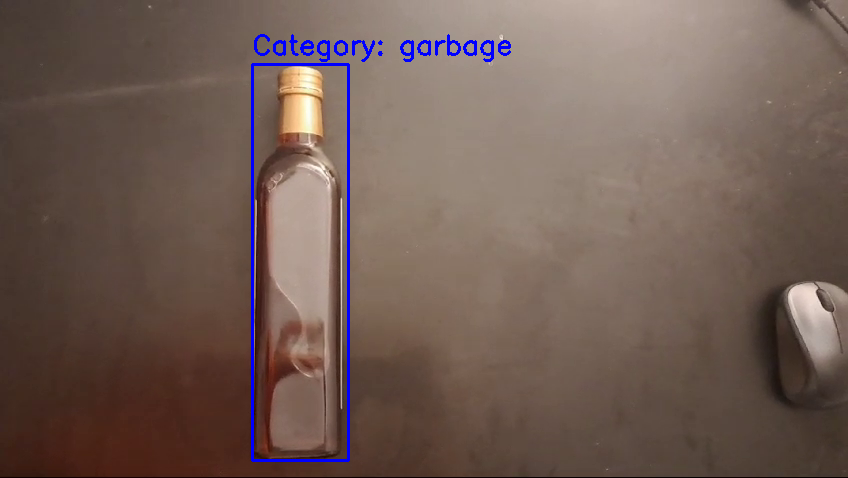


0: 384x640 1 bottle, 1 vase, 18.5ms
Speed: 4.7ms preprocess, 18.5ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     253.74      63.591      348.52       458.2]
Predicted category: garbage


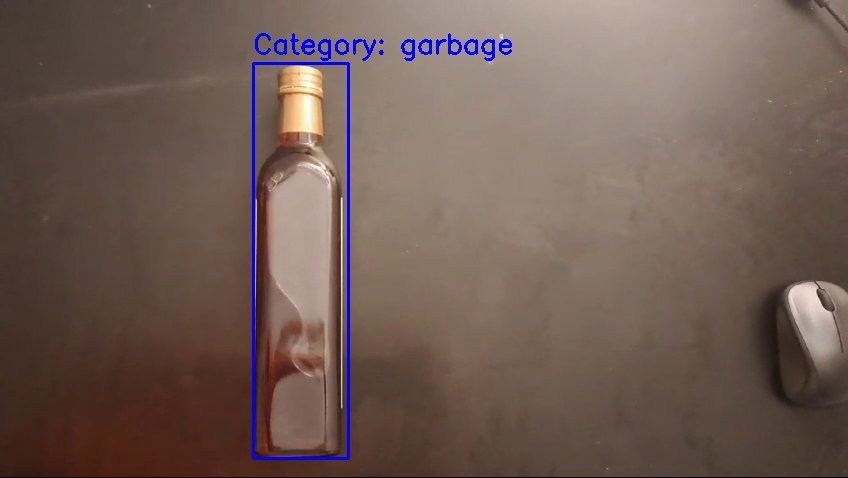


0: 384x640 1 bottle, 1 vase, 11.0ms
Speed: 2.7ms preprocess, 11.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: aerosol_cans_garbage
Detected box: [     253.77      63.647      348.47       457.4]
Predicted category: garbage


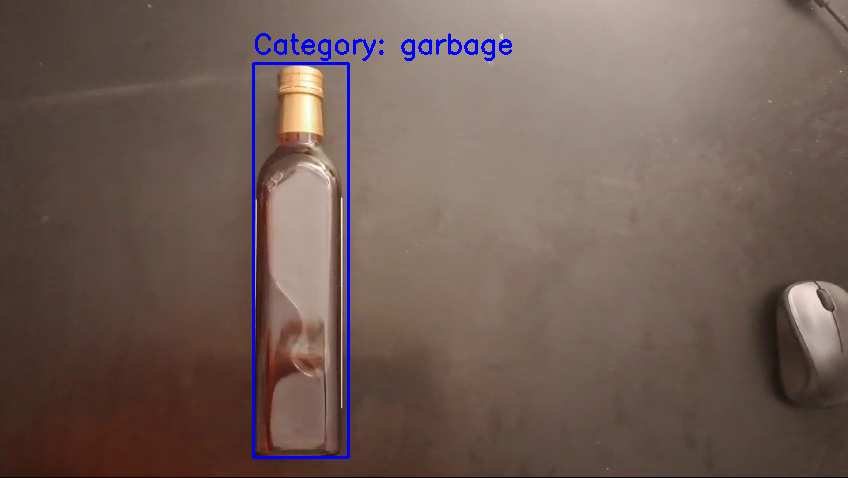


0: 384x640 1 bottle, 13.9ms
Speed: 2.8ms preprocess, 13.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: plastic_food_containers_recycling
Detected box: [     282.74       83.01      405.74      440.48]
Predicted category: recycling


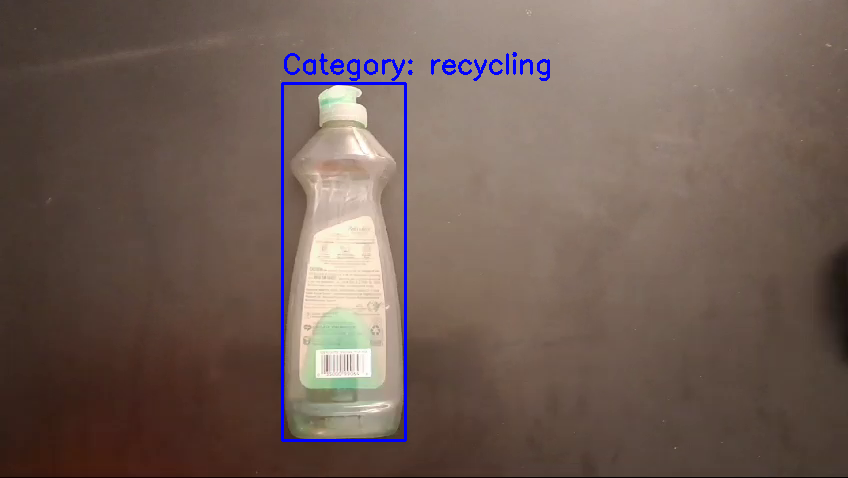


0: 384x640 1 bottle, 9.0ms
Speed: 2.8ms preprocess, 9.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: plastic_food_containers_recycling
Detected box: [     281.96      81.957       405.6      441.81]
Predicted category: recycling


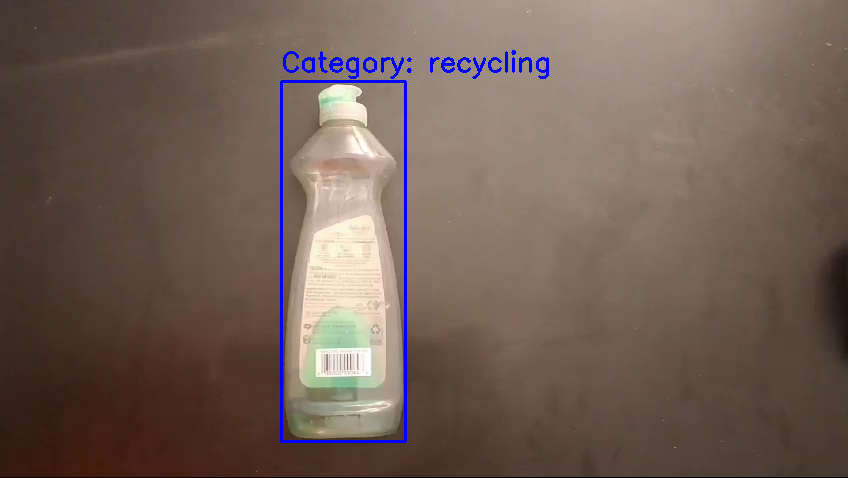


0: 384x640 1 bottle, 8.6ms
Speed: 2.8ms preprocess, 8.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: plastic_food_containers_recycling
Detected box: [     281.88      81.487      405.63      441.32]
Predicted category: recycling


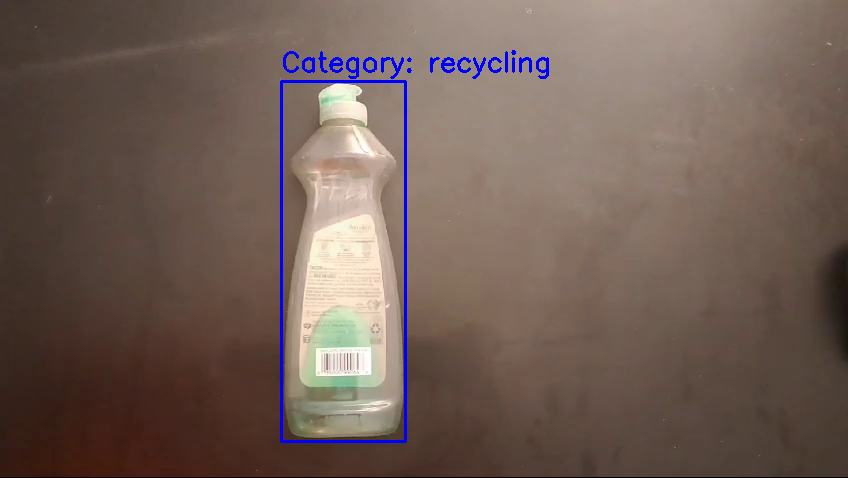


0: 384x640 1 bottle, 10.4ms
Speed: 2.8ms preprocess, 10.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: plastic_food_containers_recycling
Detected box: [      282.1      81.239      405.72      440.89]
Predicted category: recycling


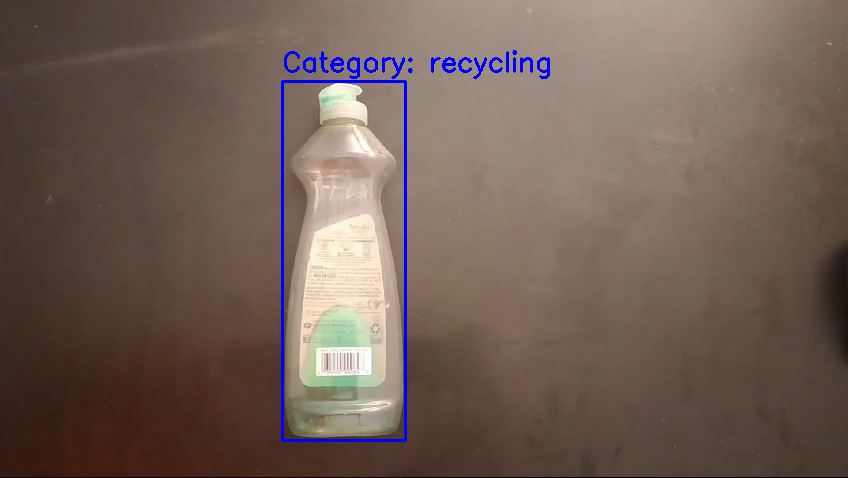


0: 384x640 1 bottle, 8.4ms
Speed: 2.5ms preprocess, 8.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: glass_food_jars_recycling
Detected box: [     282.35      80.979      405.92      440.14]
Predicted category: recycling


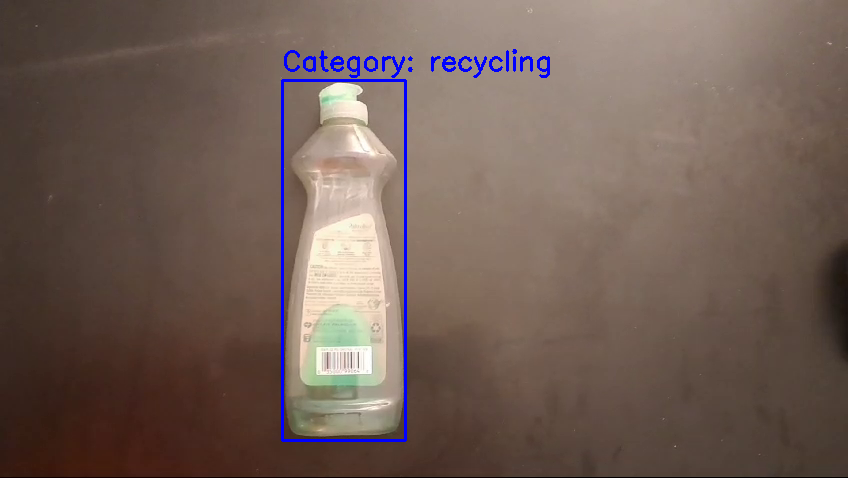


0: 384x640 1 bottle, 9.4ms
Speed: 2.9ms preprocess, 9.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: glass_beverage_bottles_recycling
Detected box: [      282.6      80.319      405.93      439.91]
Predicted category: recycling


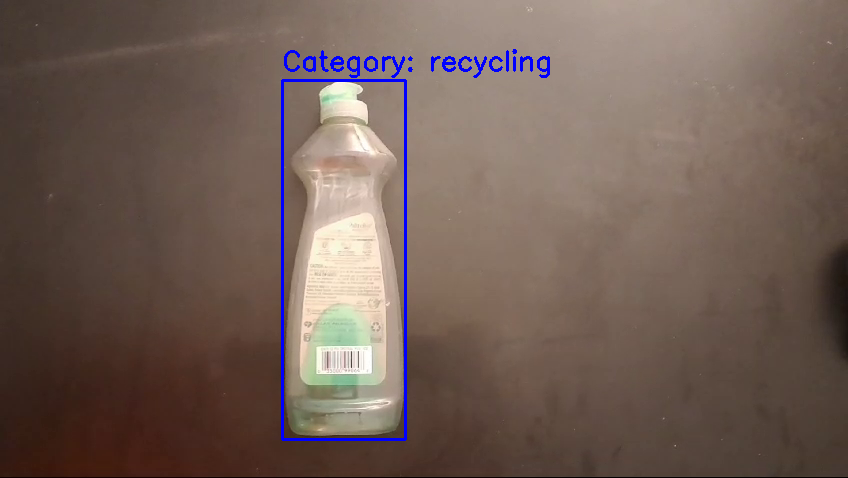


0: 384x640 1 bottle, 9.0ms
Speed: 2.6ms preprocess, 9.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: glass_beverage_bottles_recycling
Detected box: [     282.67      80.231      406.01      439.66]
Predicted category: recycling


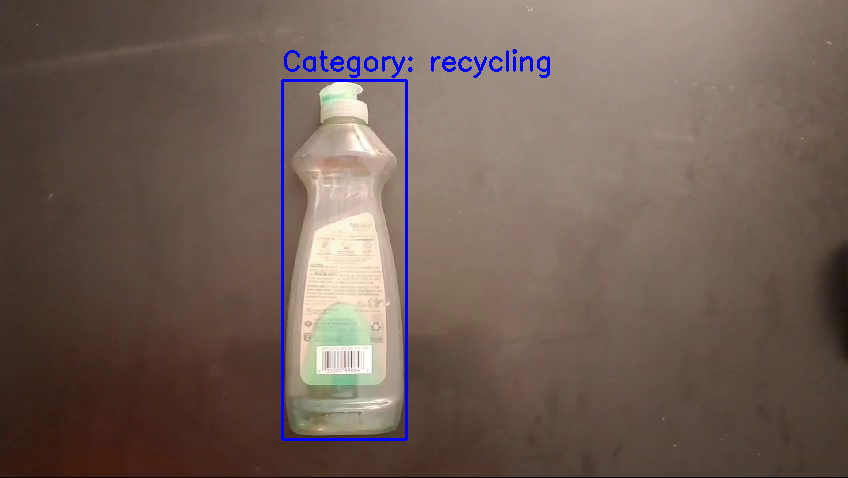


0: 384x640 1 bottle, 8.7ms
Speed: 2.6ms preprocess, 8.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: glass_food_jars_recycling
Detected box: [     282.48      79.724      406.06      438.64]
Predicted category: recycling


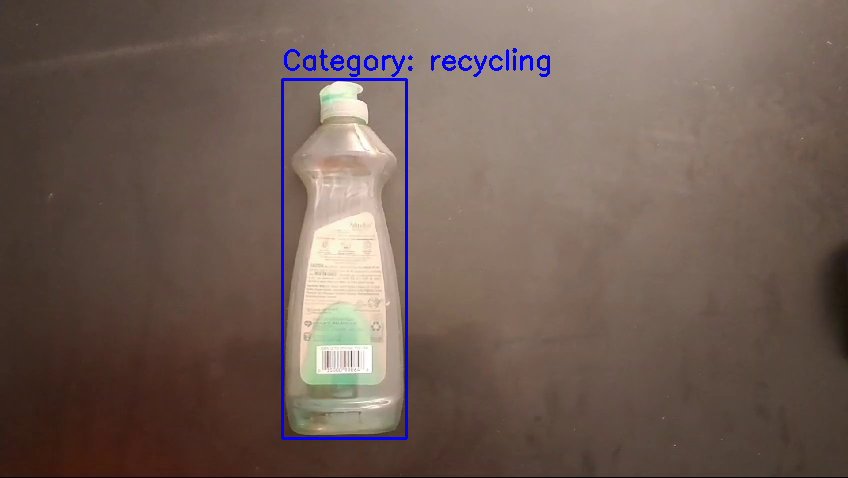


0: 384x640 1 bottle, 9.3ms
Speed: 2.7ms preprocess, 9.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: glass_beverage_bottles_recycling
Detected box: [     282.62      79.059      406.15      437.88]
Predicted category: recycling


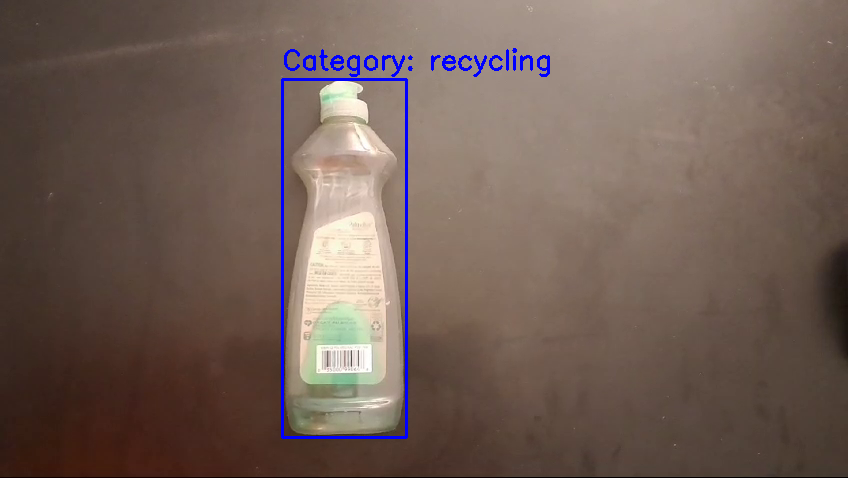


0: 384x640 1 bottle, 9.1ms
Speed: 2.7ms preprocess, 9.1ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: glass_beverage_bottles_recycling
Detected box: [     282.35      79.218      405.97       437.6]
Predicted category: recycling


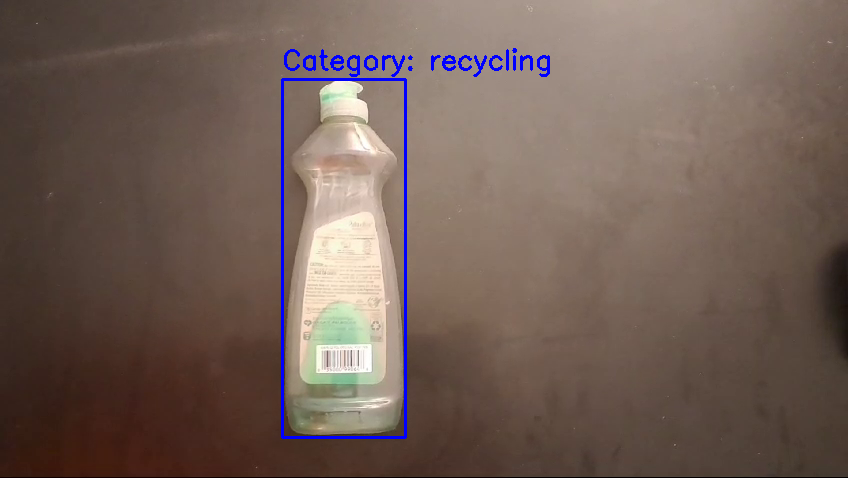


0: 384x640 1 bottle, 9.3ms
Speed: 2.7ms preprocess, 9.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: glass_food_jars_recycling
Detected box: [     282.53      78.773      406.07      437.21]
Predicted category: recycling


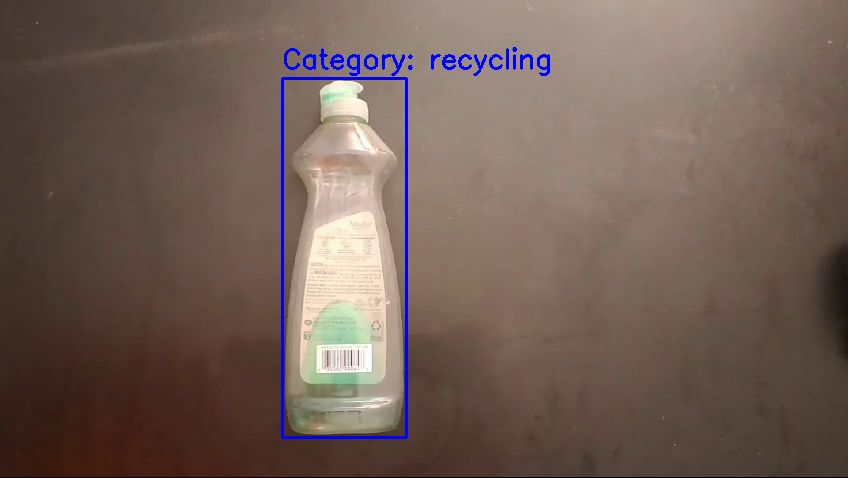


0: 384x640 1 bottle, 9.4ms
Speed: 2.8ms preprocess, 9.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: glass_beverage_bottles_recycling
Detected box: [     282.47      78.556      406.01      437.45]
Predicted category: recycling


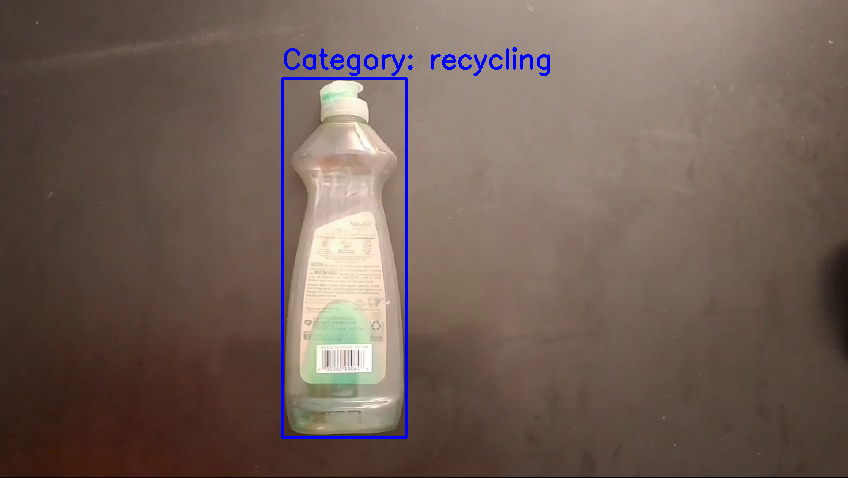


0: 384x640 1 bottle, 9.7ms
Speed: 2.6ms preprocess, 9.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: glass_beverage_bottles_recycling
Detected box: [     282.59      78.089      406.27      437.11]
Predicted category: recycling


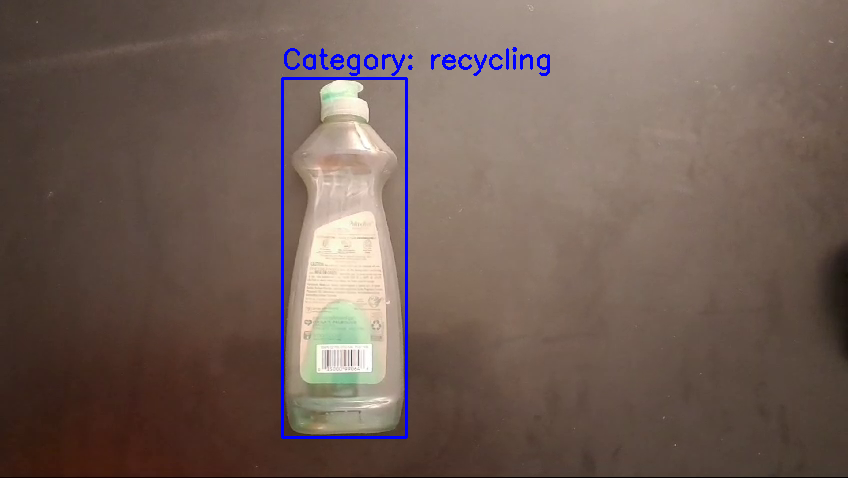


0: 384x640 1 bottle, 13.0ms
Speed: 2.8ms preprocess, 13.0ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: glass_beverage_bottles_recycling
Detected box: [     282.51      77.984      406.28       437.1]
Predicted category: recycling


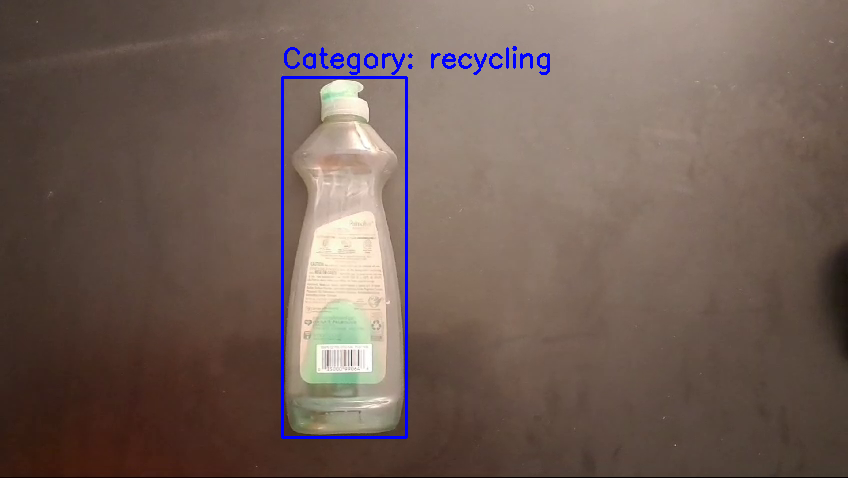


0: 384x640 1 bottle, 10.2ms
Speed: 2.7ms preprocess, 10.2ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: glass_beverage_bottles_recycling
Detected box: [     282.41      77.948      406.24      437.36]
Predicted category: recycling


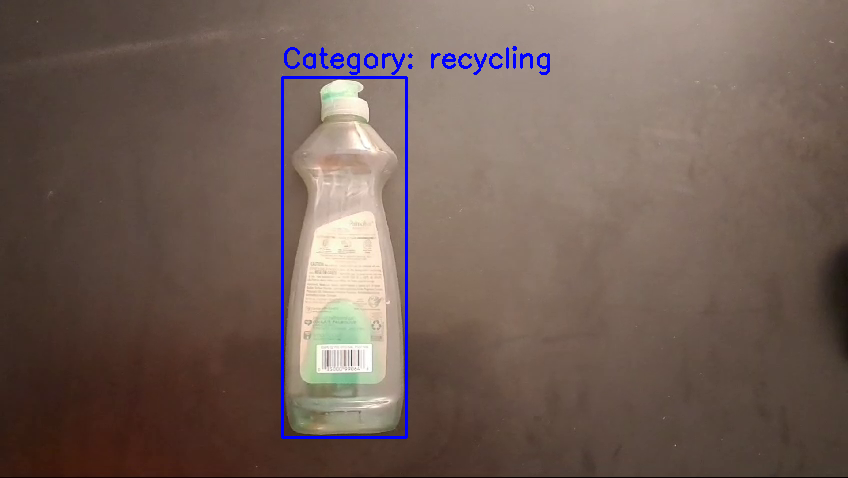


0: 384x640 1 bottle, 9.5ms
Speed: 2.7ms preprocess, 9.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: glass_beverage_bottles_recycling
Detected box: [     282.38      77.926      406.18      437.46]
Predicted category: recycling


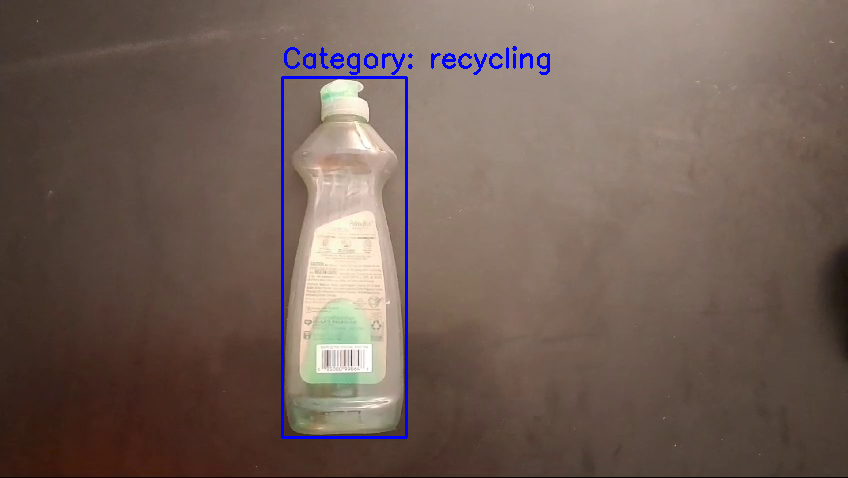


0: 384x640 1 bottle, 9.7ms
Speed: 2.6ms preprocess, 9.7ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: glass_beverage_bottles_recycling
Detected box: [     282.32      77.957      406.18      437.42]
Predicted category: recycling


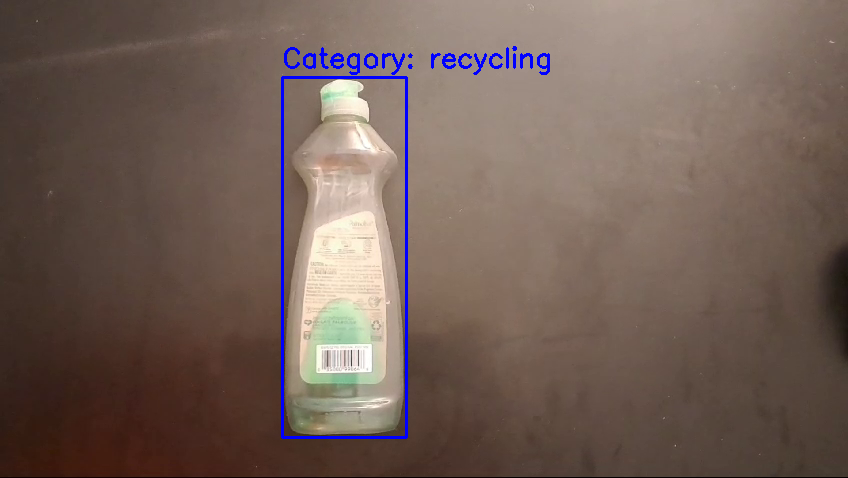


0: 384x640 1 bottle, 11.1ms
Speed: 2.6ms preprocess, 11.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: glass_beverage_bottles_recycling
Detected box: [     282.26      77.812      406.07      437.54]
Predicted category: recycling


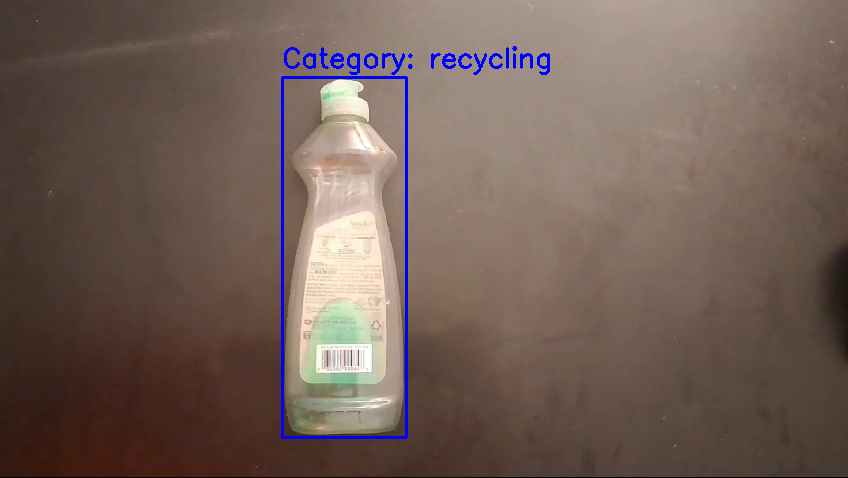


0: 384x640 1 bottle, 11.7ms
Speed: 2.7ms preprocess, 11.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: glass_beverage_bottles_recycling
Detected box: [     282.28      77.743      406.04      437.12]
Predicted category: recycling


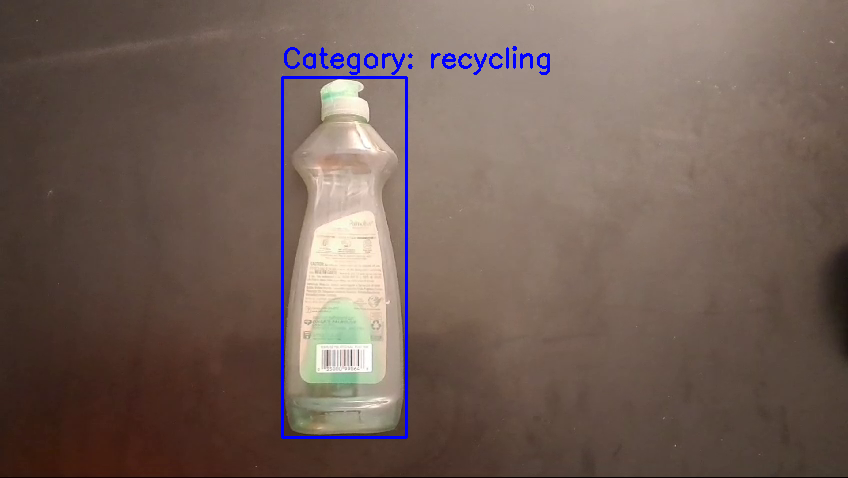


0: 384x640 1 bottle, 10.9ms
Speed: 2.8ms preprocess, 10.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: glass_beverage_bottles_recycling
Detected box: [     282.28       77.59       406.1      437.55]
Predicted category: recycling


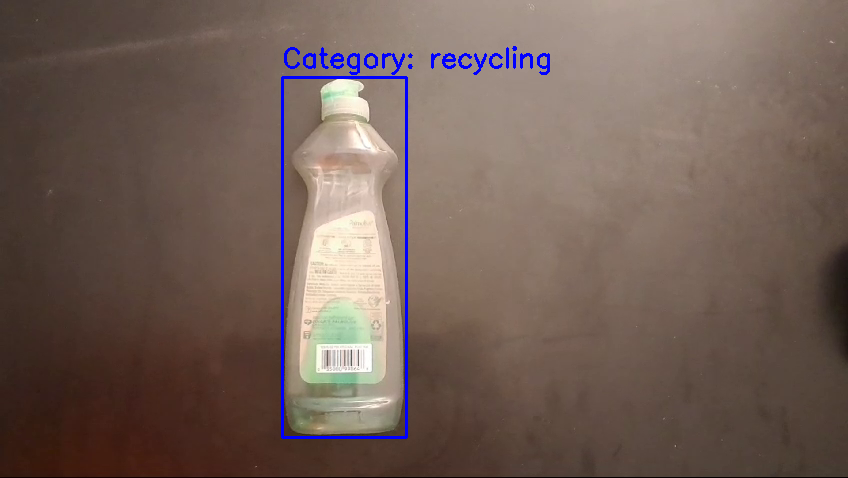


0: 384x640 1 bottle, 9.1ms
Speed: 2.7ms preprocess, 9.1ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: glass_beverage_bottles_recycling
Detected box: [     282.28      77.822      406.06      436.31]
Predicted category: recycling


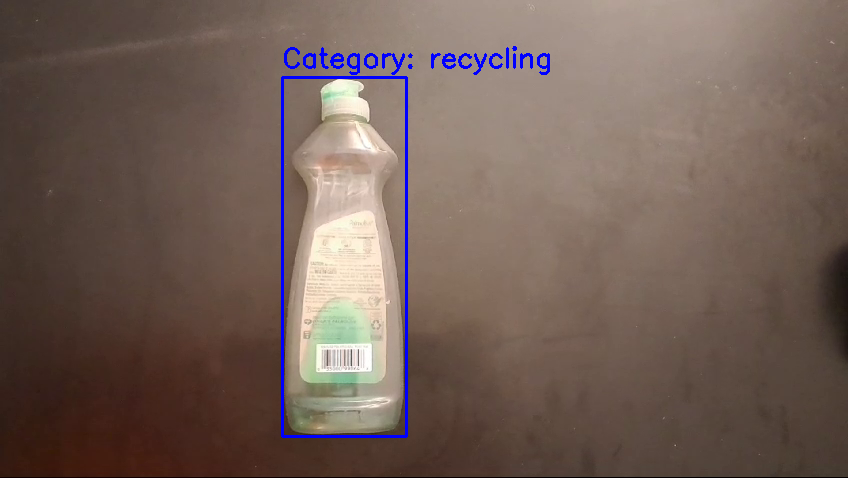


0: 384x640 1 bottle, 9.1ms
Speed: 2.7ms preprocess, 9.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: glass_beverage_bottles_recycling
Detected box: [     282.11       77.19      405.92      436.19]
Predicted category: recycling


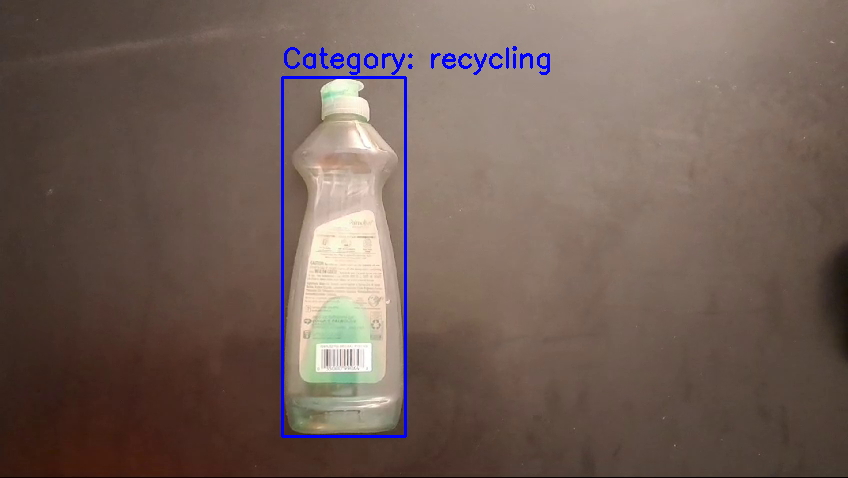


0: 384x640 1 bottle, 9.4ms
Speed: 2.7ms preprocess, 9.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: glass_beverage_bottles_recycling
Detected box: [     282.14      77.113      405.98      434.48]
Predicted category: recycling


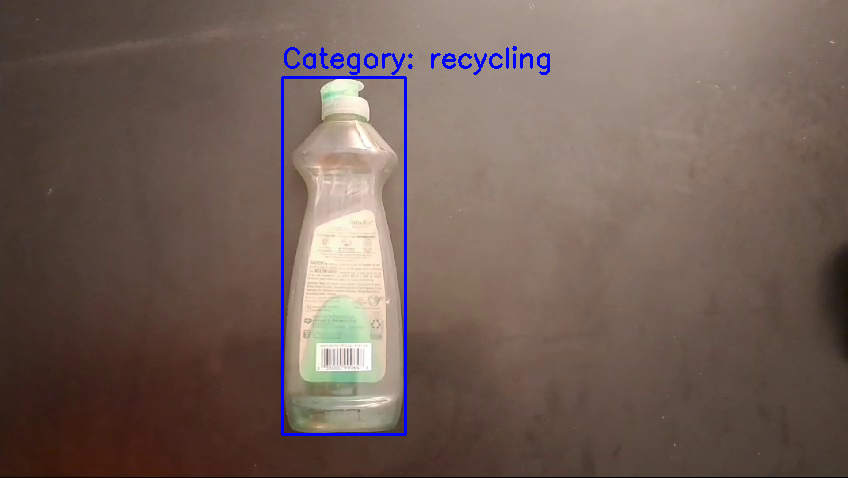


0: 384x640 1 bottle, 9.4ms
Speed: 2.7ms preprocess, 9.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: glass_beverage_bottles_recycling
Detected box: [     281.87      76.207      405.61      434.64]
Predicted category: recycling


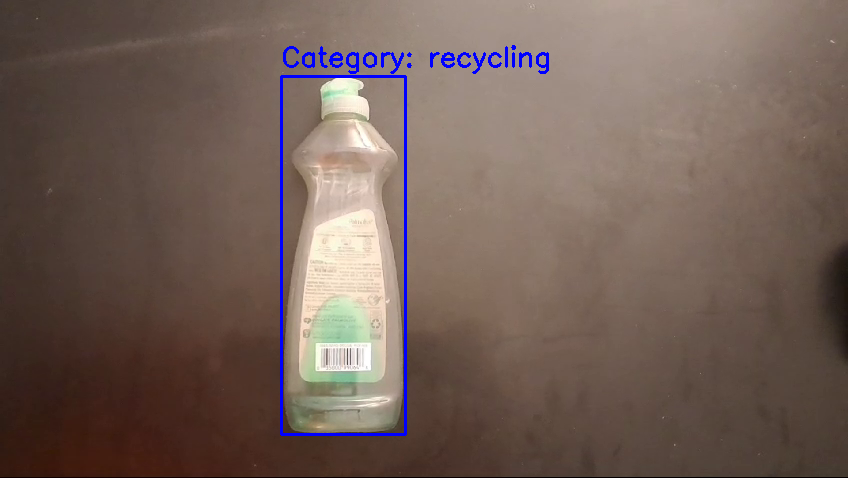


0: 384x640 1 bottle, 9.9ms
Speed: 2.6ms preprocess, 9.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: glass_beverage_bottles_recycling
Detected box: [     281.64      76.414      405.48      435.09]
Predicted category: recycling


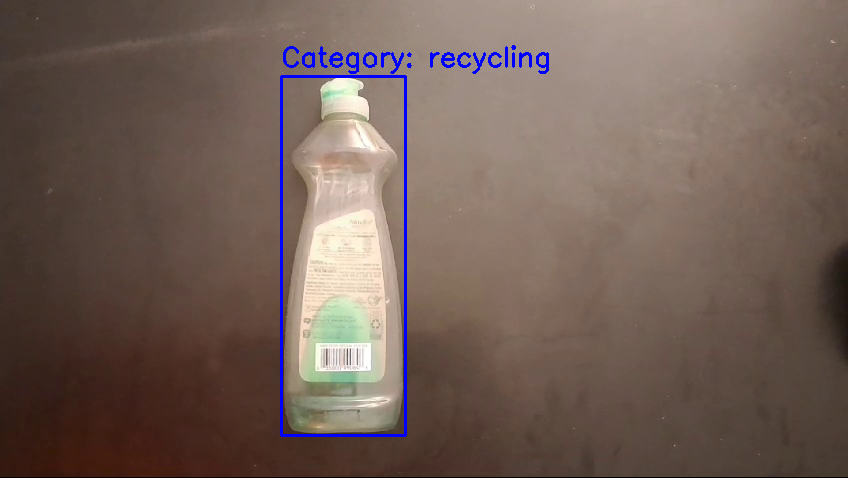


0: 384x640 1 bottle, 9.8ms
Speed: 2.8ms preprocess, 9.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: glass_beverage_bottles_recycling
Detected box: [     281.75      76.057      405.62      433.31]
Predicted category: recycling


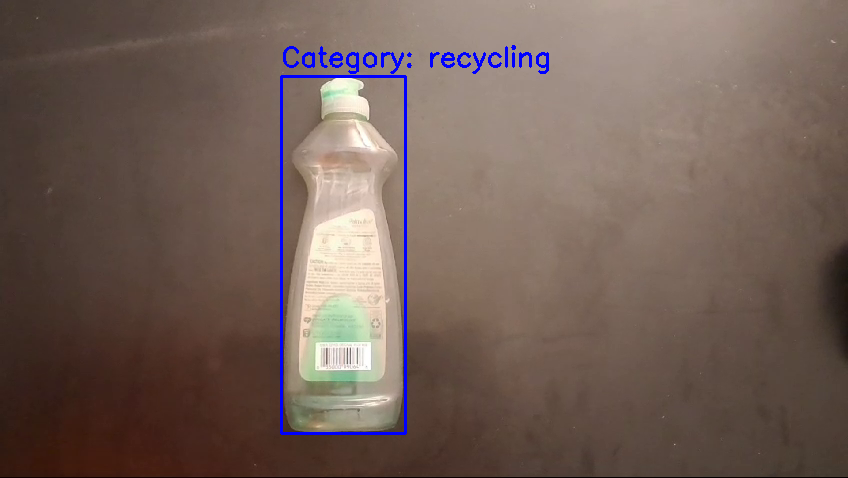


0: 384x640 1 bottle, 8.6ms
Speed: 2.8ms preprocess, 8.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: plastic_food_containers_recycling
Detected box: [     281.29      75.686      405.43      432.49]
Predicted category: recycling


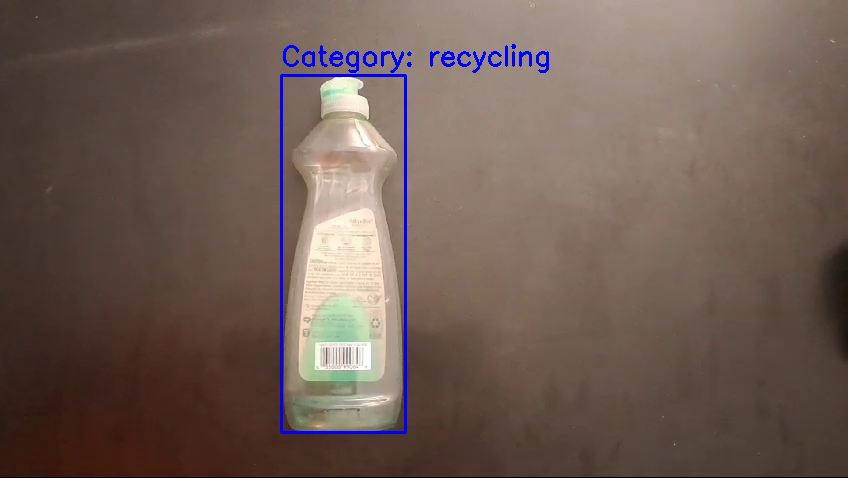


0: 384x640 (no detections), 10.6ms
Speed: 2.9ms preprocess, 10.6ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


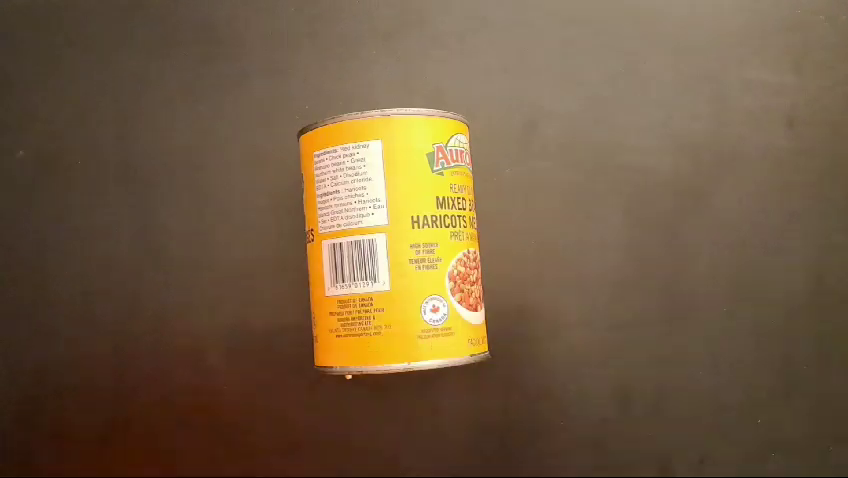


0: 384x640 (no detections), 10.2ms
Speed: 2.9ms preprocess, 10.2ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)


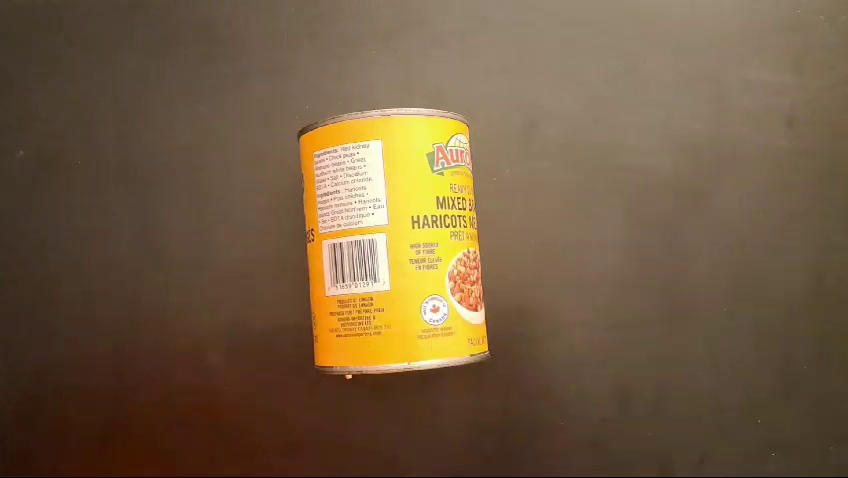


0: 384x640 (no detections), 9.3ms
Speed: 3.0ms preprocess, 9.3ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


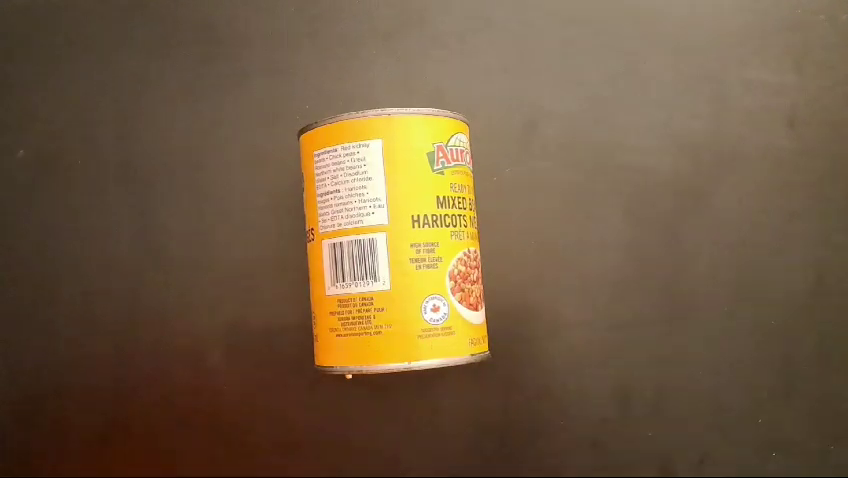


0: 384x640 (no detections), 9.3ms
Speed: 2.9ms preprocess, 9.3ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)


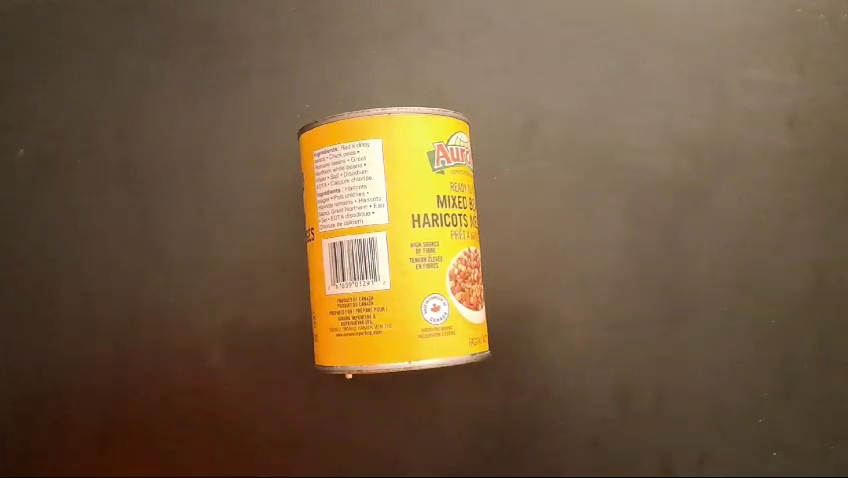


0: 384x640 (no detections), 9.4ms
Speed: 3.0ms preprocess, 9.4ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)


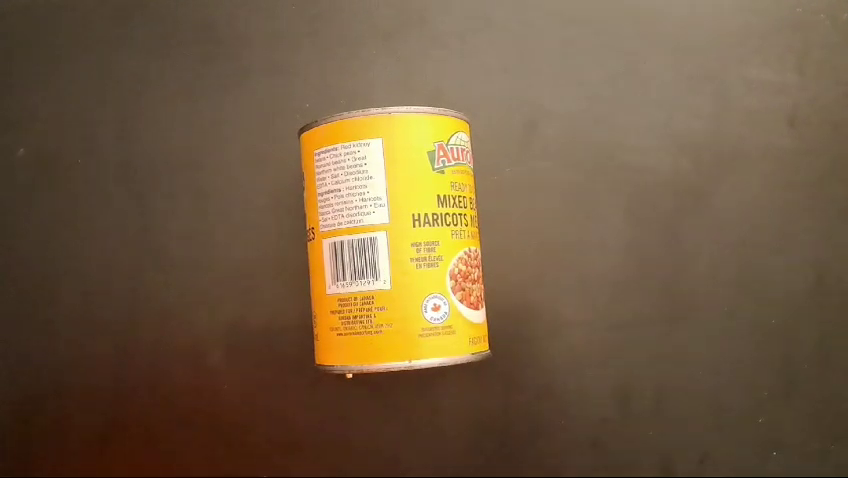


0: 384x640 (no detections), 9.5ms
Speed: 2.8ms preprocess, 9.5ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


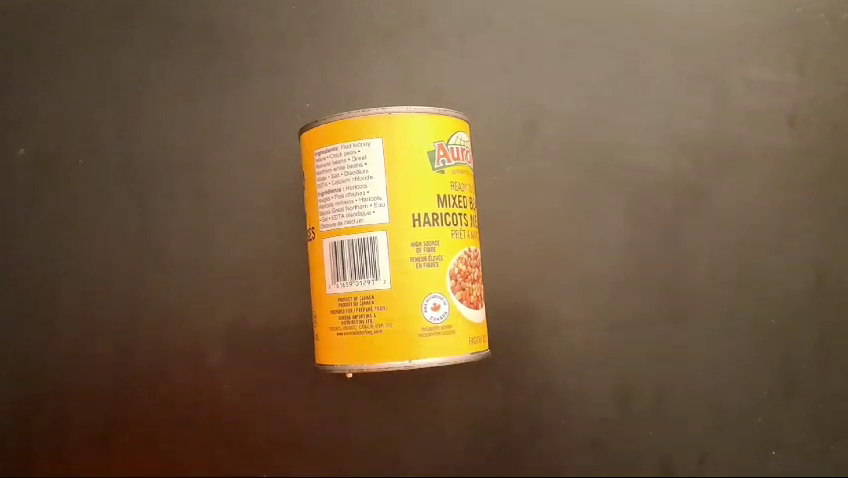


0: 384x640 (no detections), 8.6ms
Speed: 3.1ms preprocess, 8.6ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)


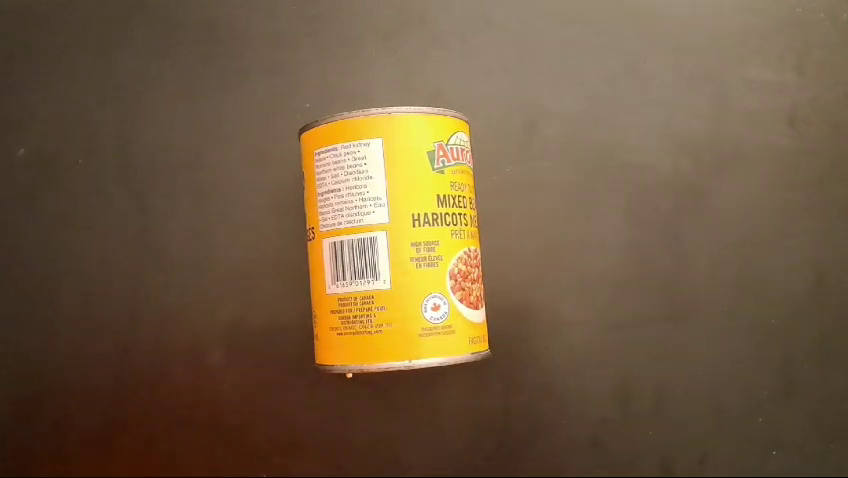


0: 384x640 (no detections), 10.3ms
Speed: 2.9ms preprocess, 10.3ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)


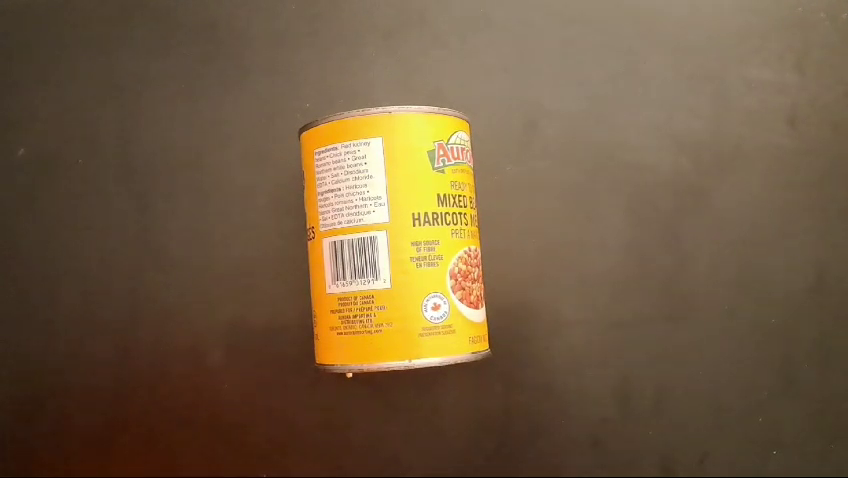


0: 384x640 (no detections), 10.8ms
Speed: 2.7ms preprocess, 10.8ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


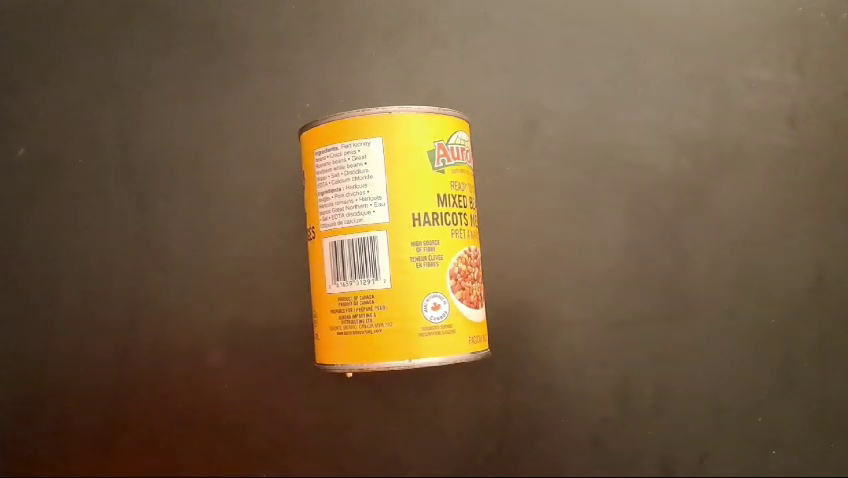


0: 384x640 (no detections), 10.4ms
Speed: 3.0ms preprocess, 10.4ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


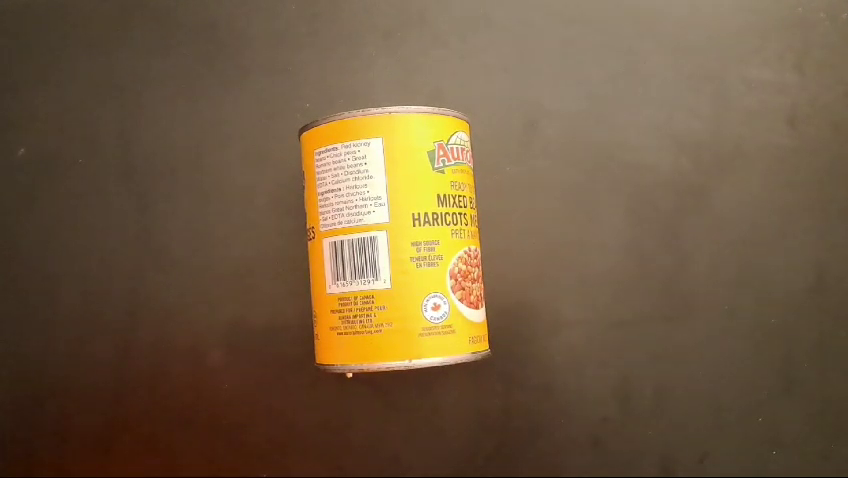


0: 384x640 (no detections), 9.2ms
Speed: 2.8ms preprocess, 9.2ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


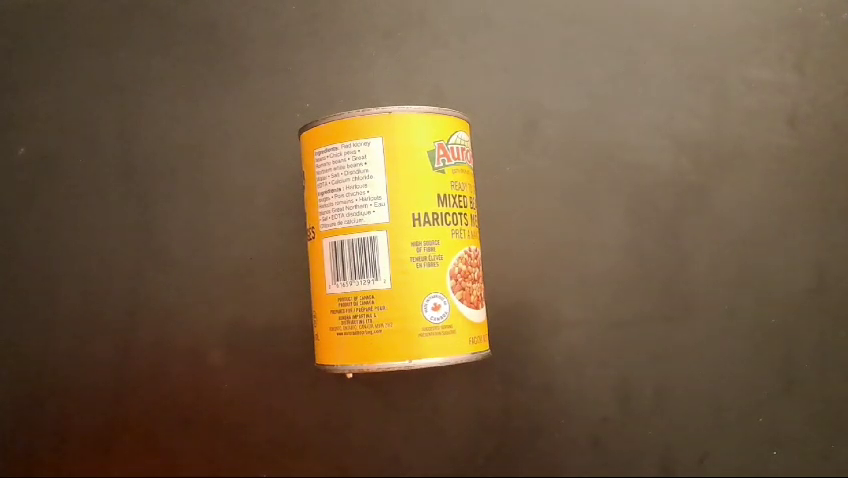


0: 384x640 (no detections), 9.5ms
Speed: 2.8ms preprocess, 9.5ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)


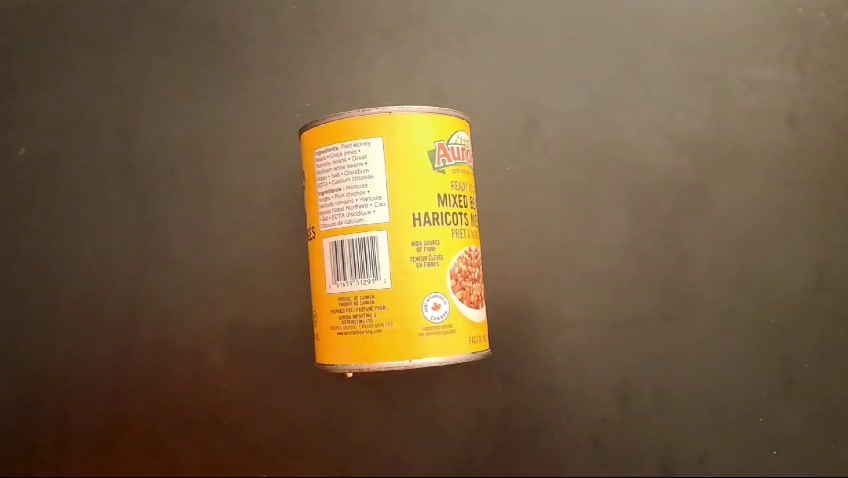


0: 384x640 (no detections), 9.6ms
Speed: 3.0ms preprocess, 9.6ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


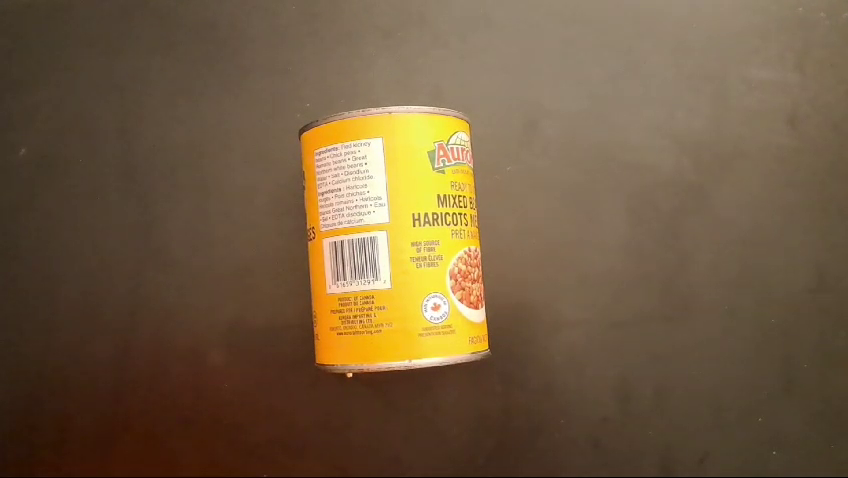


0: 384x640 (no detections), 10.1ms
Speed: 2.7ms preprocess, 10.1ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


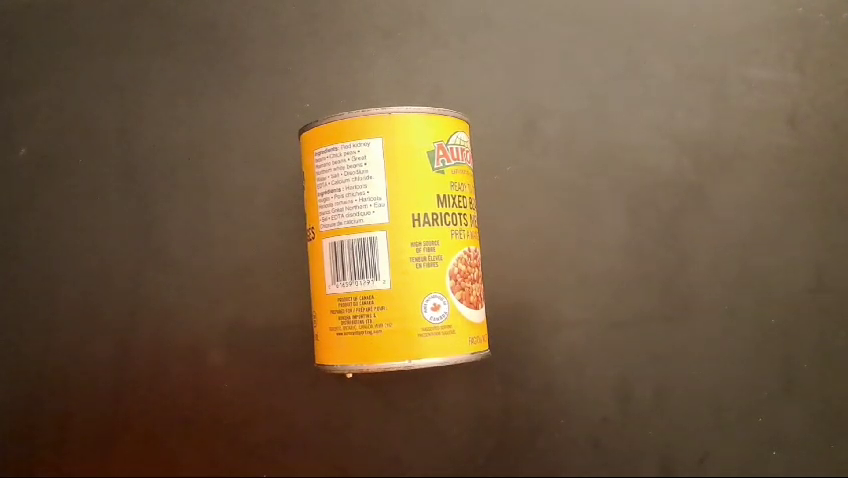


0: 384x640 (no detections), 9.4ms
Speed: 2.6ms preprocess, 9.4ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


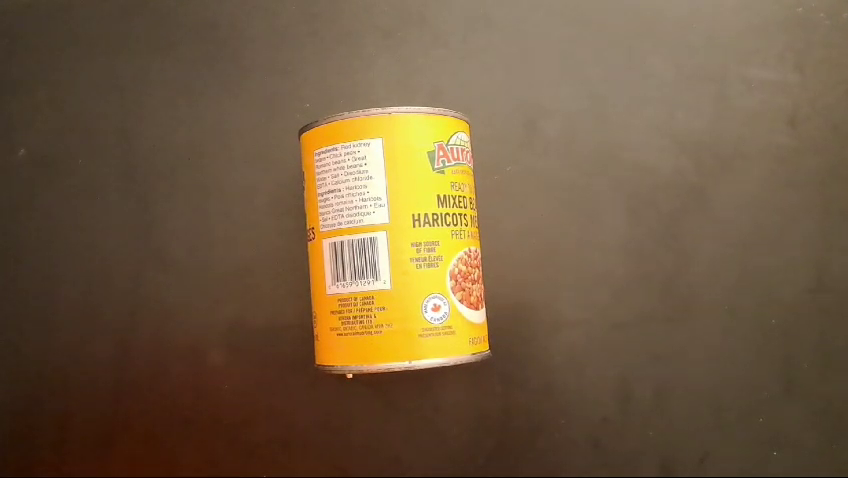


0: 384x640 (no detections), 8.7ms
Speed: 2.5ms preprocess, 8.7ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


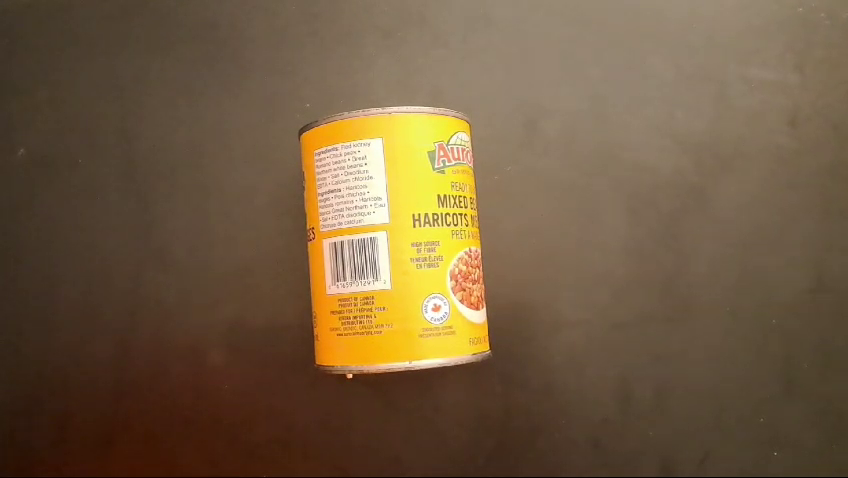


0: 384x640 (no detections), 11.6ms
Speed: 2.9ms preprocess, 11.6ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)


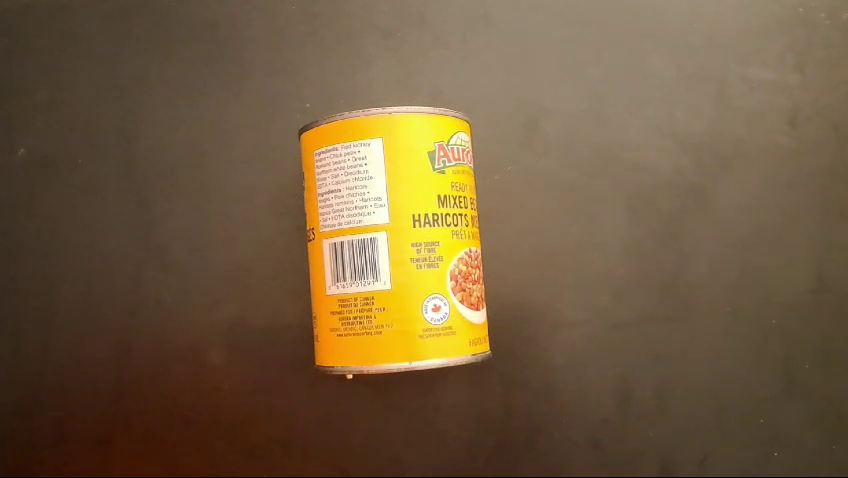


0: 384x640 (no detections), 8.6ms
Speed: 2.8ms preprocess, 8.6ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)


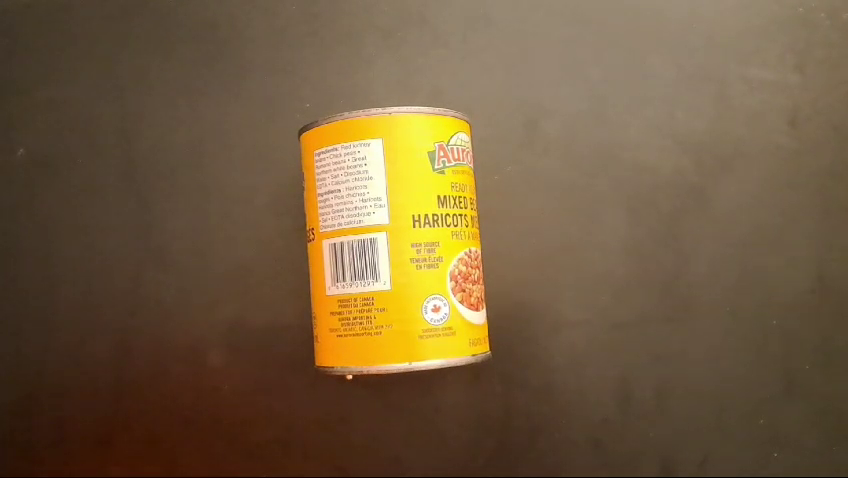


0: 384x640 (no detections), 9.0ms
Speed: 2.6ms preprocess, 9.0ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


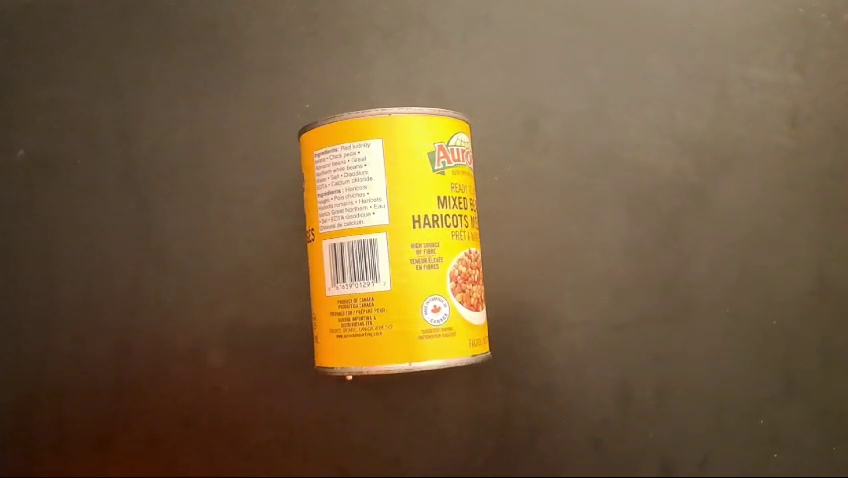


0: 384x640 (no detections), 9.8ms
Speed: 2.8ms preprocess, 9.8ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


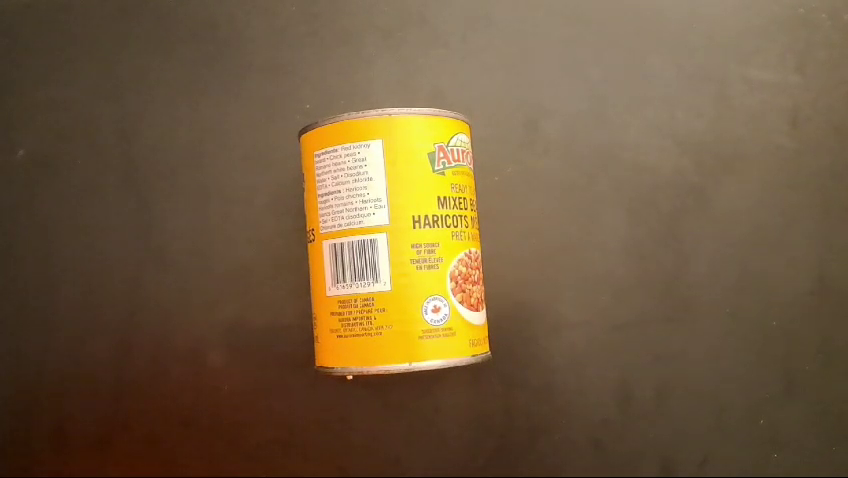


0: 384x640 (no detections), 11.9ms
Speed: 2.8ms preprocess, 11.9ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


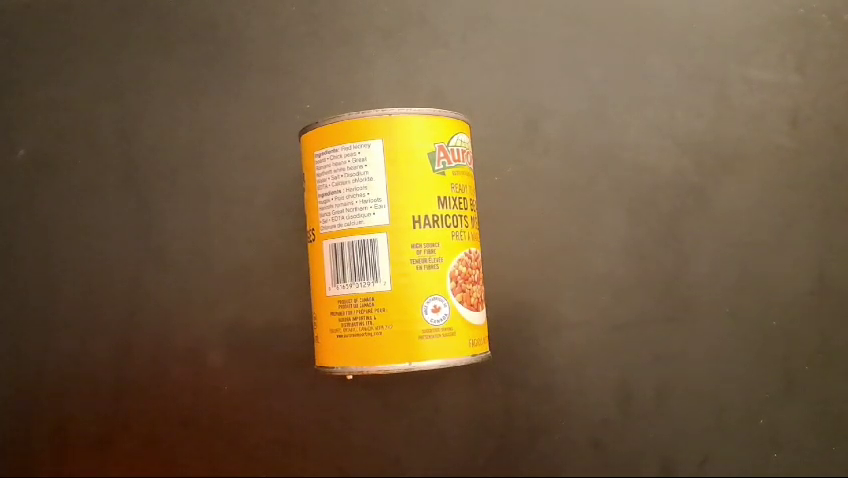


0: 384x640 (no detections), 9.4ms
Speed: 2.8ms preprocess, 9.4ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)


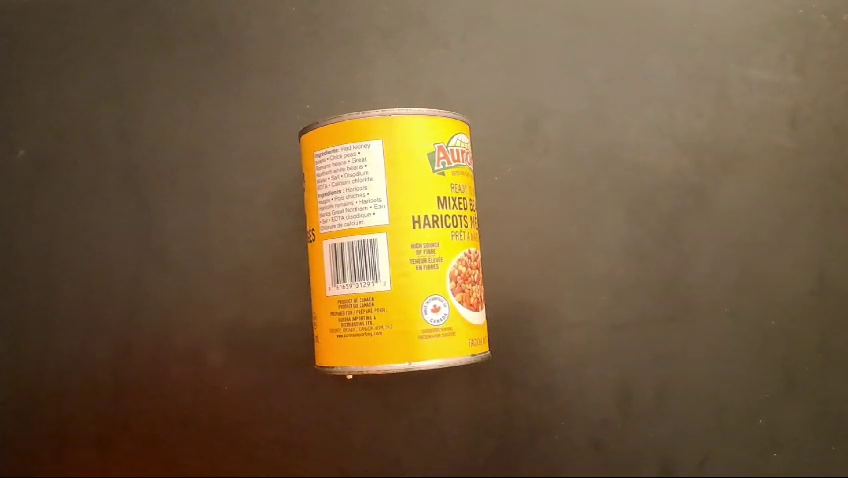


0: 384x640 (no detections), 9.8ms
Speed: 2.7ms preprocess, 9.8ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)


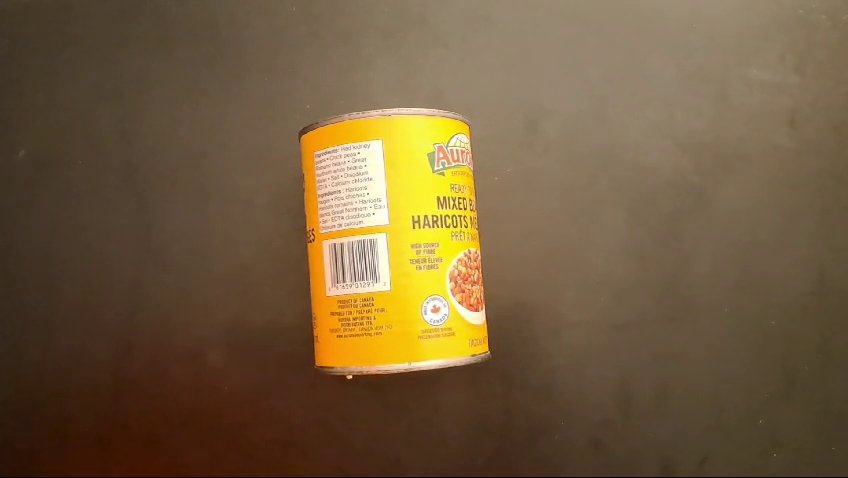


0: 384x640 (no detections), 8.9ms
Speed: 2.9ms preprocess, 8.9ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


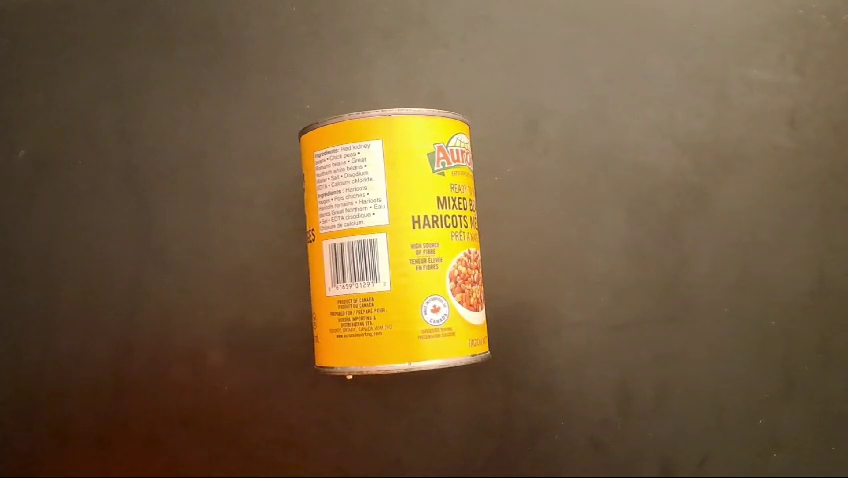


0: 384x640 (no detections), 11.9ms
Speed: 2.9ms preprocess, 11.9ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)


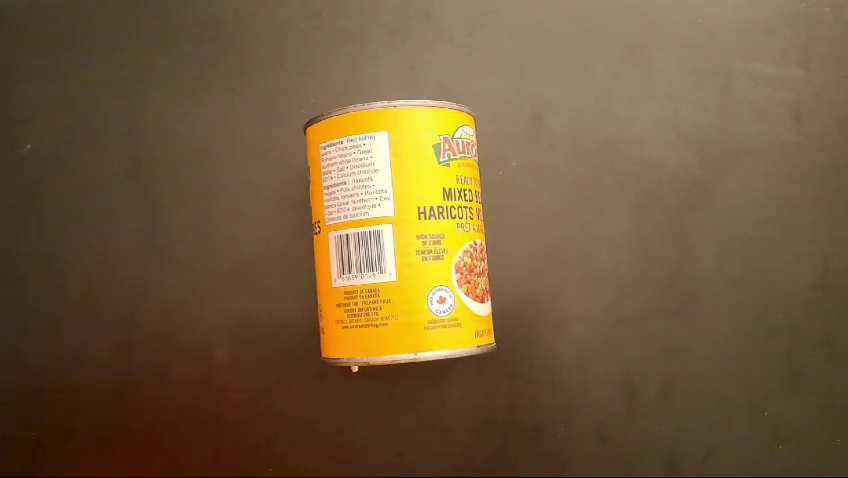


0: 384x640 (no detections), 10.6ms
Speed: 2.8ms preprocess, 10.6ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


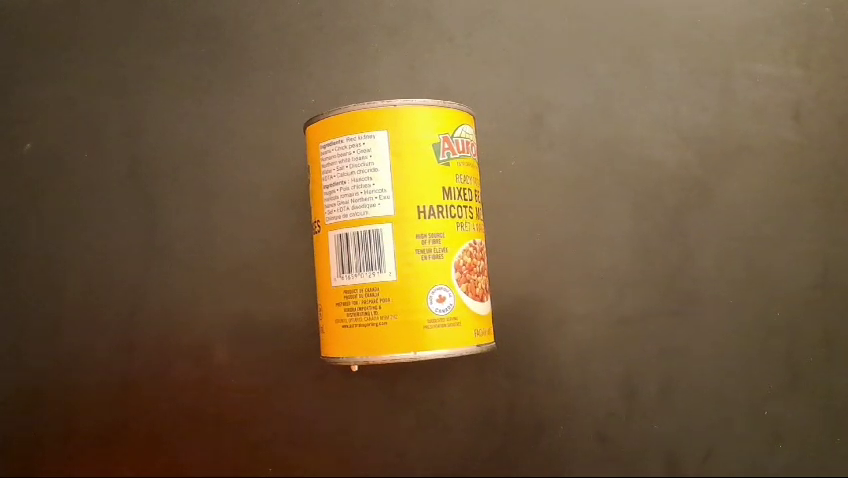


0: 384x640 (no detections), 9.3ms
Speed: 2.7ms preprocess, 9.3ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)


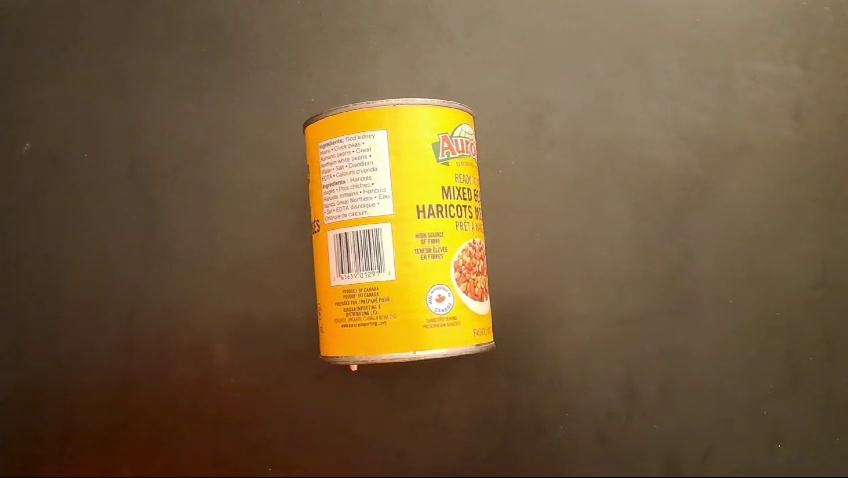


0: 384x640 (no detections), 9.3ms
Speed: 2.8ms preprocess, 9.3ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


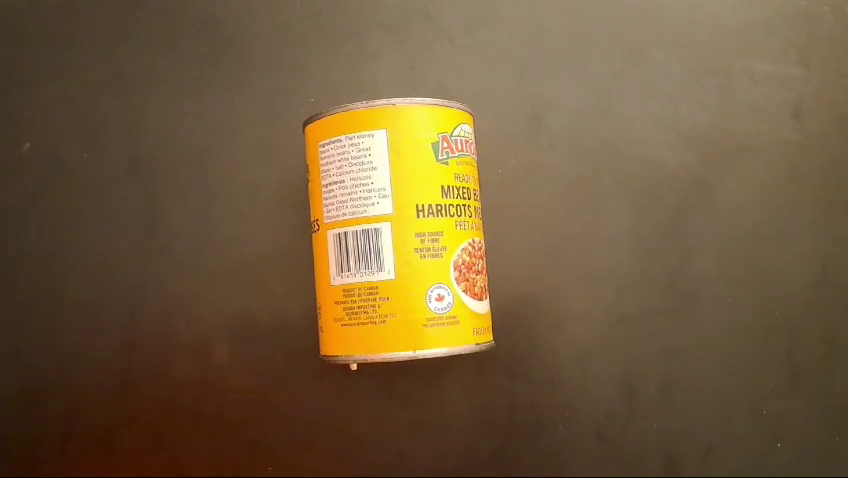


0: 384x640 (no detections), 10.9ms
Speed: 2.8ms preprocess, 10.9ms inference, 2.9ms postprocess per image at shape (1, 3, 384, 640)


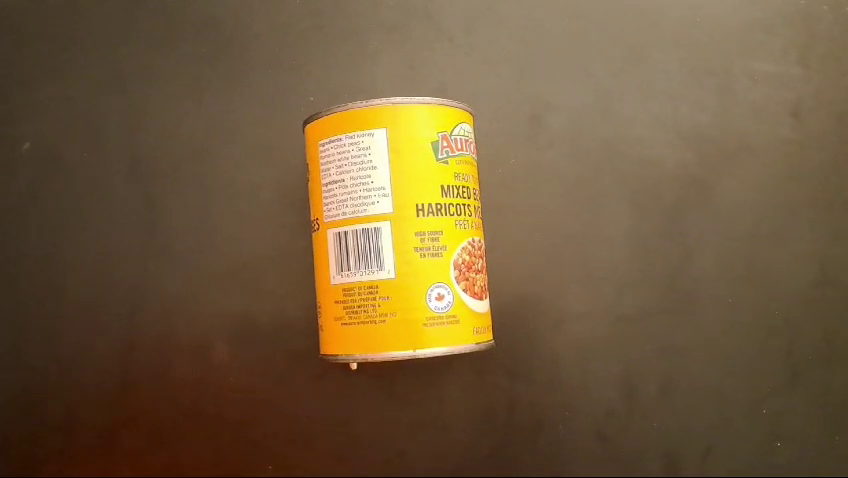


0: 384x640 (no detections), 9.2ms
Speed: 2.6ms preprocess, 9.2ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


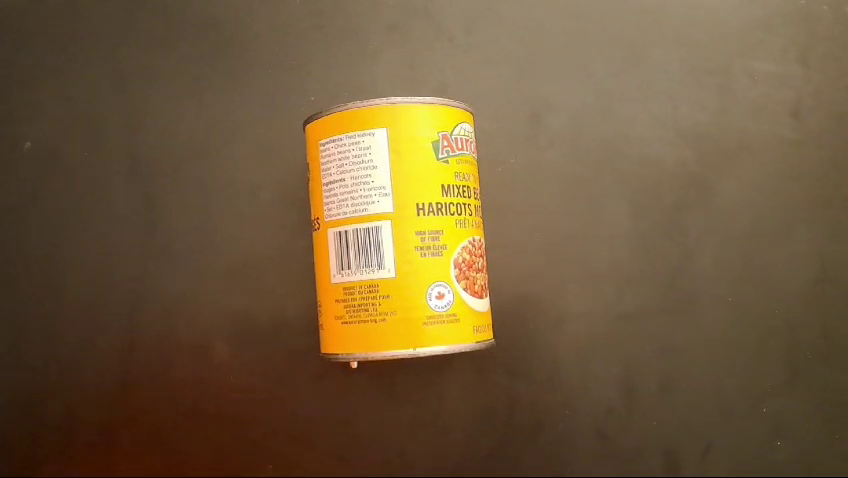


0: 384x640 (no detections), 10.8ms
Speed: 2.5ms preprocess, 10.8ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)


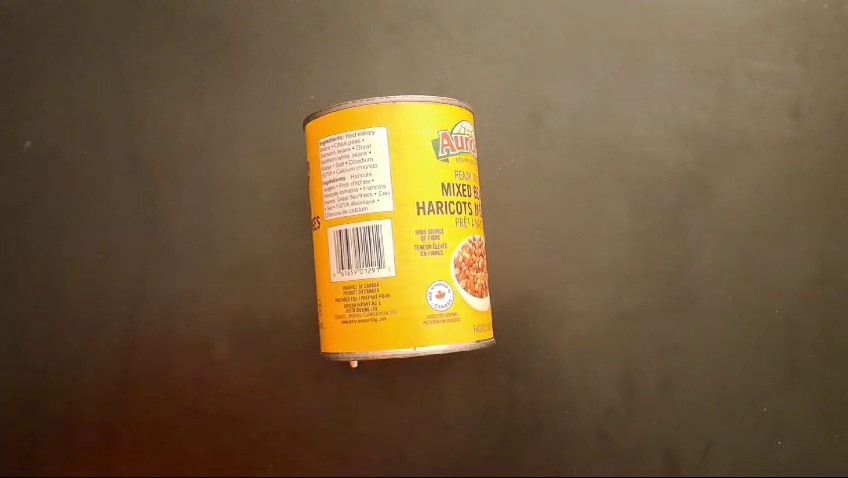


0: 384x640 (no detections), 8.4ms
Speed: 2.9ms preprocess, 8.4ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


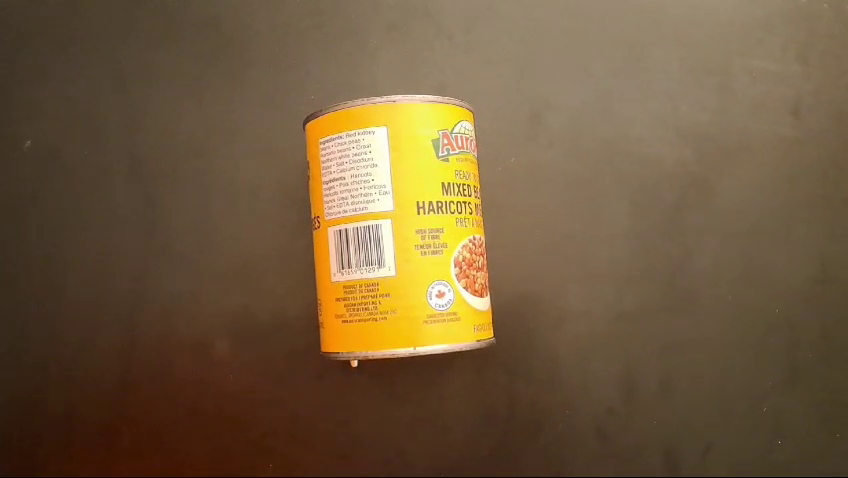


0: 384x640 (no detections), 11.7ms
Speed: 2.7ms preprocess, 11.7ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)


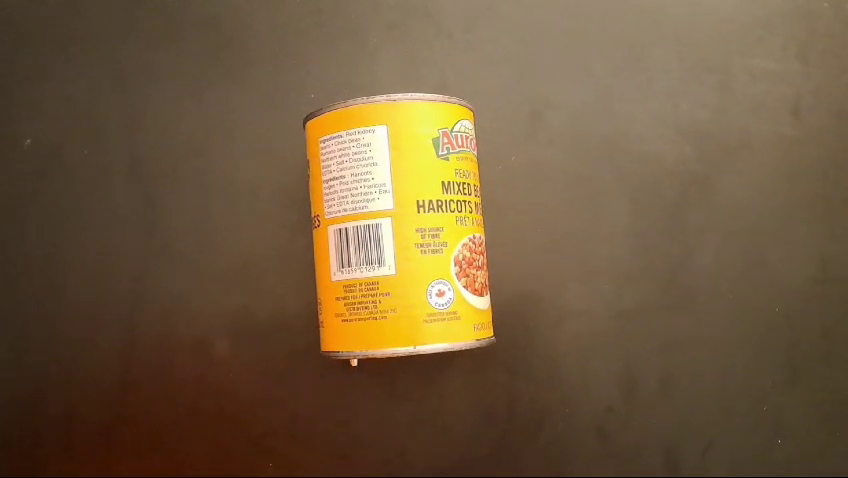


0: 384x640 (no detections), 9.2ms
Speed: 2.7ms preprocess, 9.2ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


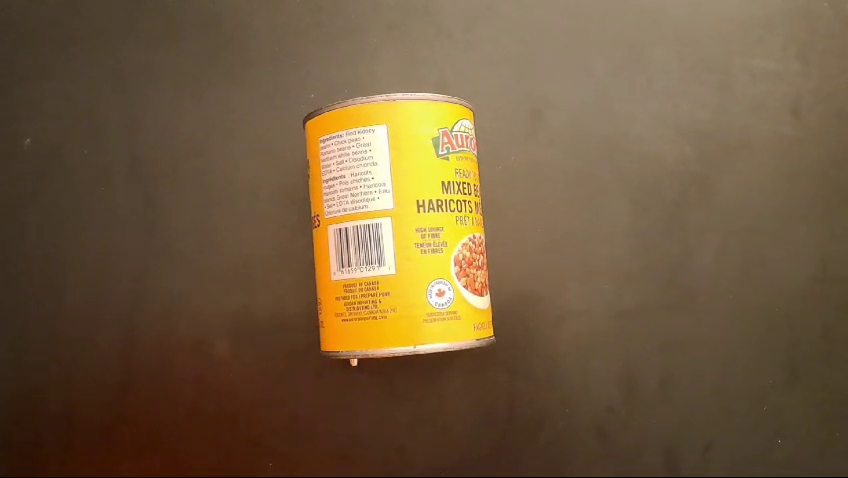


0: 384x640 (no detections), 9.2ms
Speed: 2.7ms preprocess, 9.2ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


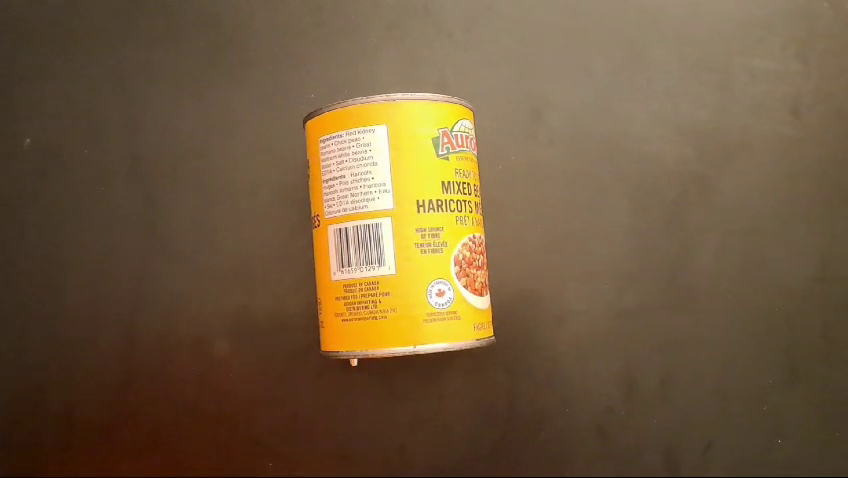


0: 384x640 2 laptops, 9.3ms
Speed: 2.6ms preprocess, 9.3ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: cardboard_boxes_recycling
Detected box: [     75.456           0      699.41      463.83]
Predicted category: recycling
Predicted classes: office_paper_recycling
Detected box: [     65.282           0      669.98       173.7]
Predicted category: recycling


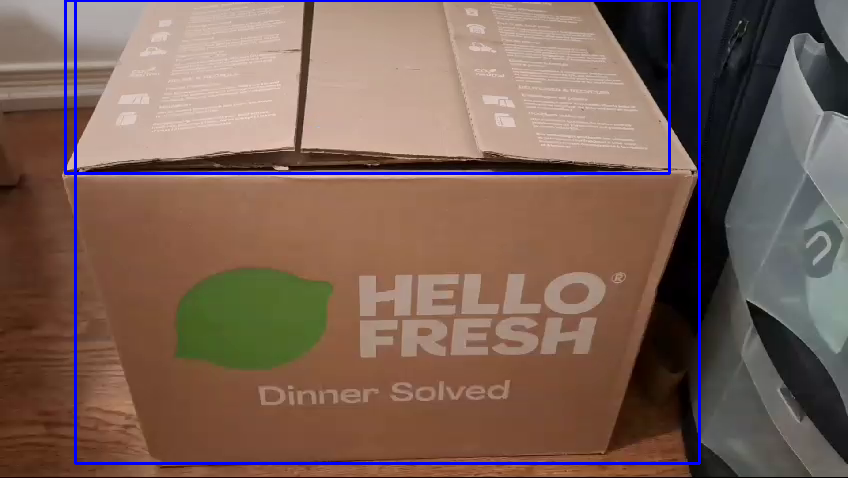


0: 384x640 2 laptops, 16.5ms
Speed: 2.7ms preprocess, 16.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: cardboard_boxes_recycling
Detected box: [     74.609           0      698.93       463.7]
Predicted category: recycling
Predicted classes: office_paper_recycling
Detected box: [     65.023           0      668.99      173.62]
Predicted category: recycling


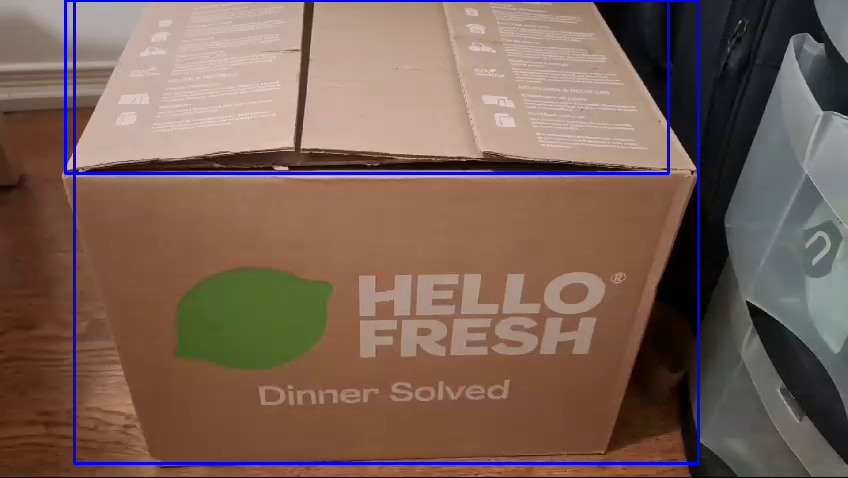


0: 384x640 2 laptops, 13.5ms
Speed: 2.7ms preprocess, 13.5ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: cardboard_boxes_recycling
Detected box: [     71.556           0      698.94      463.06]
Predicted category: recycling
Predicted classes: office_paper_recycling
Detected box: [     64.998           0      669.26      173.61]
Predicted category: recycling


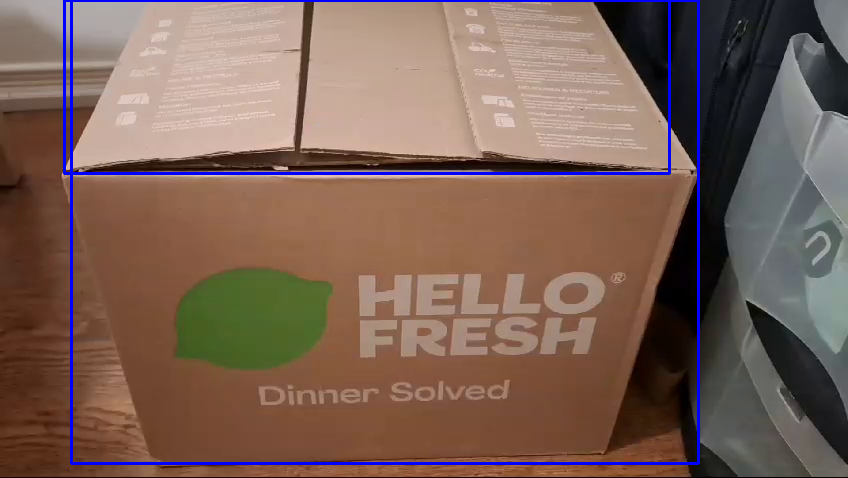


0: 384x640 2 laptops, 10.4ms
Speed: 2.9ms preprocess, 10.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: cardboard_boxes_recycling
Detected box: [     70.931           0      698.61      466.41]
Predicted category: recycling
Predicted classes: office_paper_recycling
Detected box: [     64.696           0      669.63      173.58]
Predicted category: recycling


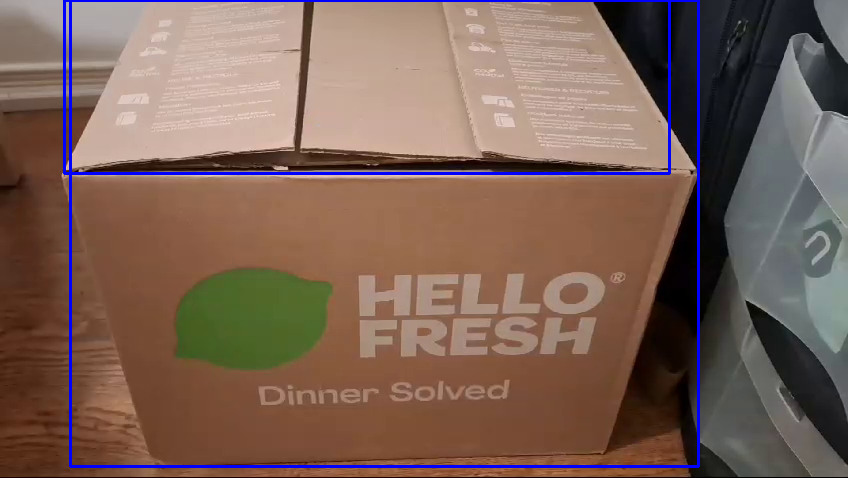


0: 384x640 2 laptops, 11.7ms
Speed: 2.9ms preprocess, 11.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: cardboard_boxes_recycling
Detected box: [     71.773           0      698.59      466.74]
Predicted category: recycling
Predicted classes: office_paper_recycling
Detected box: [     65.066           0      668.29      173.59]
Predicted category: recycling


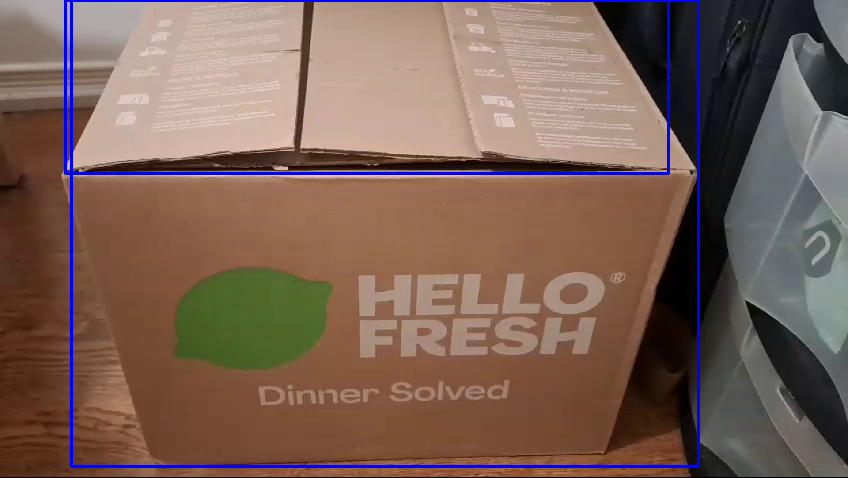


0: 384x640 2 laptops, 14.5ms
Speed: 2.7ms preprocess, 14.5ms inference, 4.6ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: cardboard_boxes_recycling
Detected box: [     70.949           0      698.55      466.63]
Predicted category: recycling
Predicted classes: office_paper_recycling
Detected box: [     64.643           0      668.52      173.62]
Predicted category: recycling


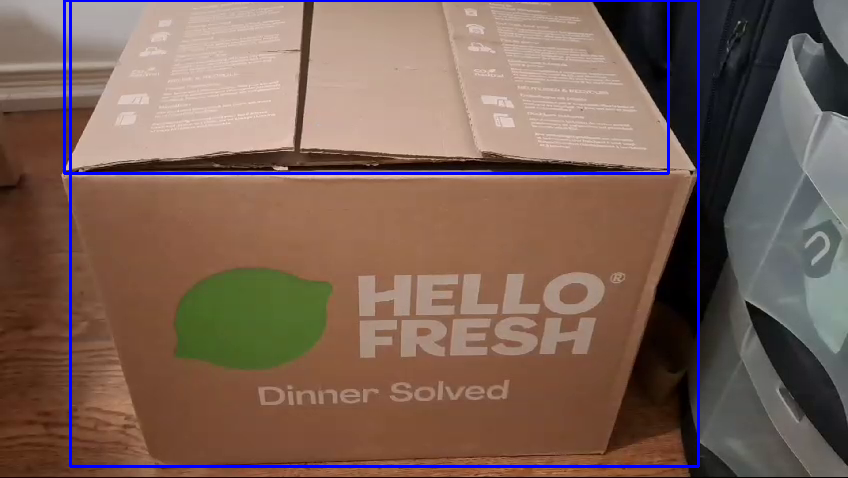


0: 384x640 2 laptops, 9.0ms
Speed: 2.6ms preprocess, 9.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: cardboard_boxes_recycling
Detected box: [     71.016           0      698.15       466.7]
Predicted category: recycling
Predicted classes: office_paper_recycling
Detected box: [     64.372           0      667.79      173.68]
Predicted category: recycling


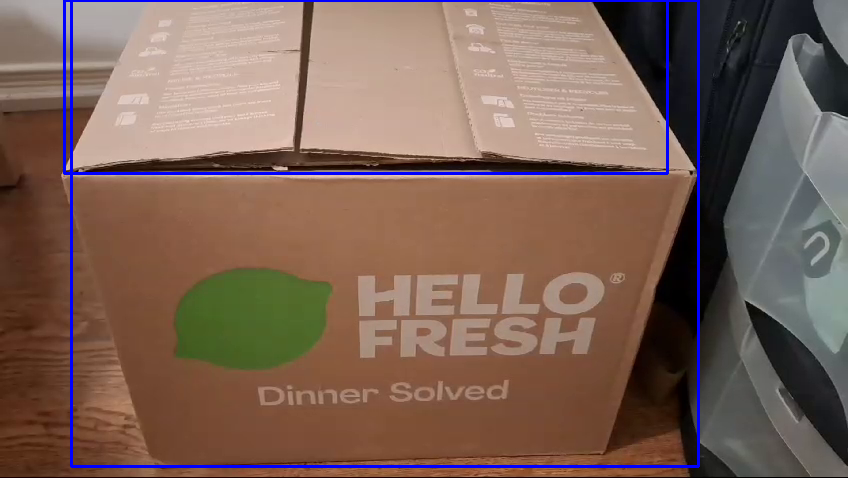


0: 384x640 2 laptops, 8.8ms
Speed: 2.9ms preprocess, 8.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: cardboard_boxes_recycling
Detected box: [     71.985           0      698.03      467.38]
Predicted category: recycling
Predicted classes: office_paper_recycling
Detected box: [     64.922           0      668.44       173.8]
Predicted category: recycling


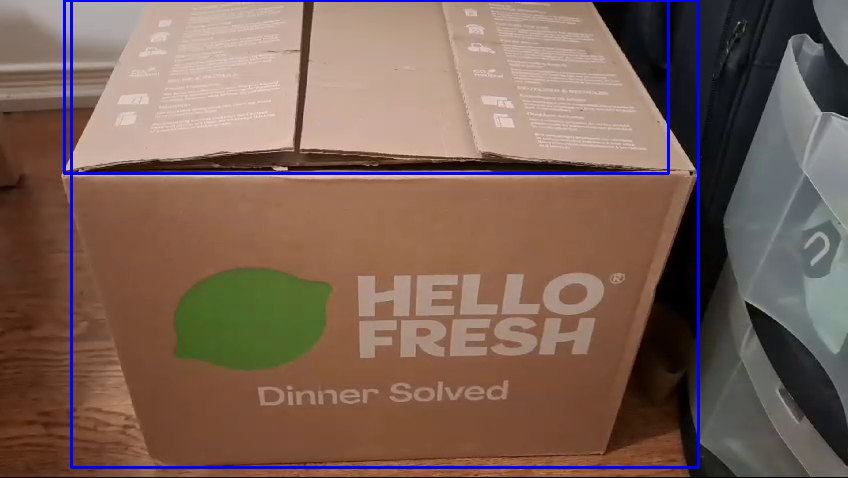


0: 384x640 2 laptops, 11.8ms
Speed: 2.7ms preprocess, 11.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: cardboard_boxes_recycling
Detected box: [      70.76           0      698.09      467.67]
Predicted category: recycling
Predicted classes: office_paper_recycling
Detected box: [     64.823           0      667.84      173.89]
Predicted category: recycling


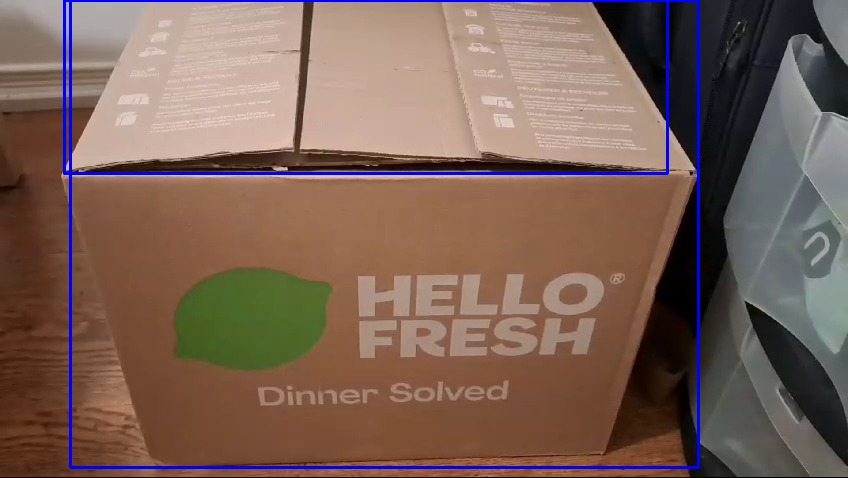


0: 384x640 2 laptops, 10.5ms
Speed: 2.8ms preprocess, 10.5ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: cardboard_boxes_recycling
Detected box: [     75.027           0      698.06      463.26]
Predicted category: recycling
Predicted classes: office_paper_recycling
Detected box: [     65.132           0      670.69      173.71]
Predicted category: recycling


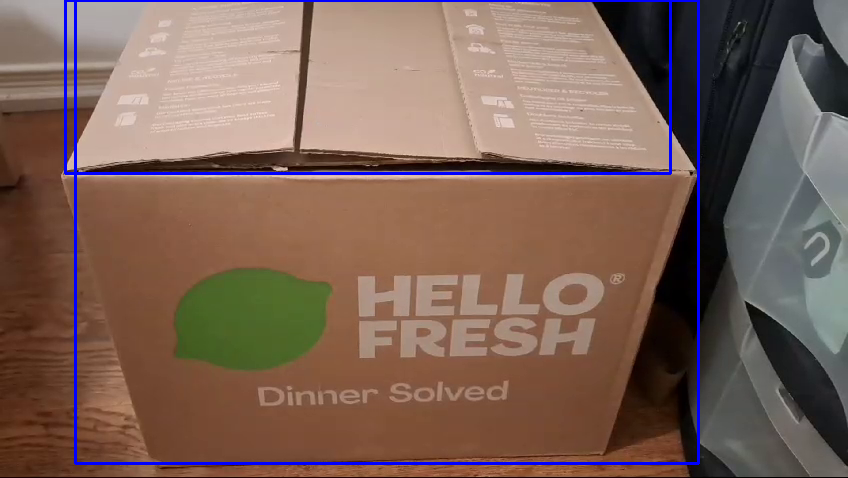


0: 384x640 1 laptop, 8.9ms
Speed: 2.9ms preprocess, 8.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: cardboard_boxes_recycling
Detected box: [     73.978           0       698.1      462.44]
Predicted category: recycling


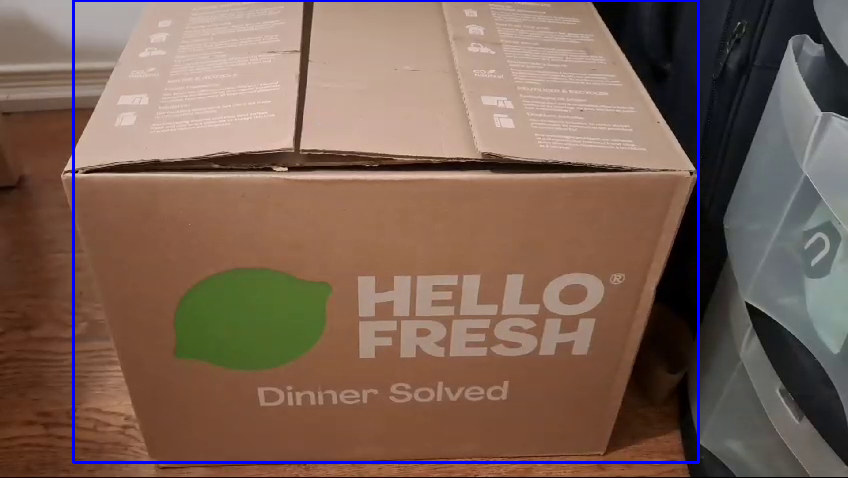


0: 384x640 1 laptop, 12.8ms
Speed: 4.4ms preprocess, 12.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: cardboard_boxes_recycling
Detected box: [     69.896           0      698.59      462.26]
Predicted category: recycling


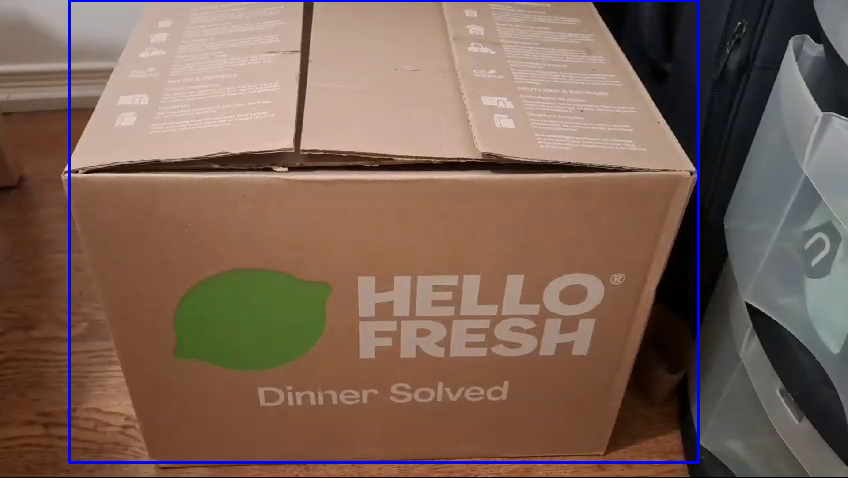


0: 384x640 1 laptop, 13.1ms
Speed: 2.7ms preprocess, 13.1ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: cardboard_boxes_recycling
Detected box: [     66.258           0      698.48      462.68]
Predicted category: recycling


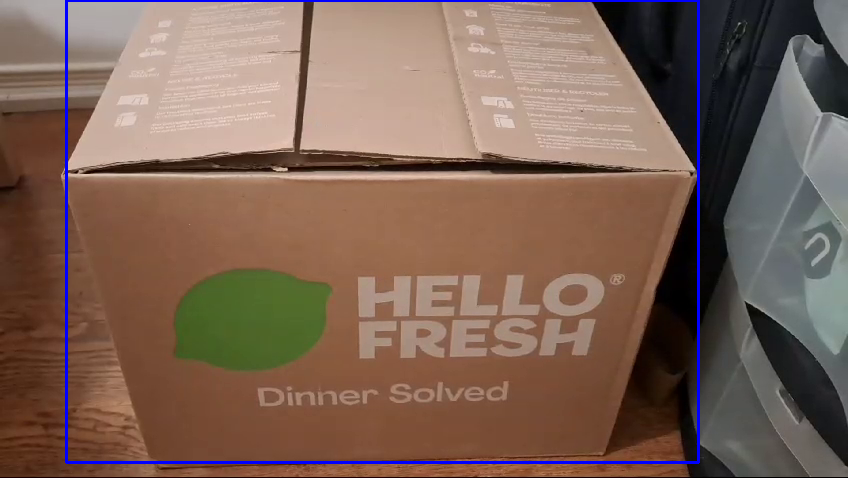


0: 384x640 1 laptop, 9.7ms
Speed: 2.7ms preprocess, 9.7ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: cardboard_boxes_recycling
Detected box: [     63.741     0.36501      698.38      467.74]
Predicted category: recycling


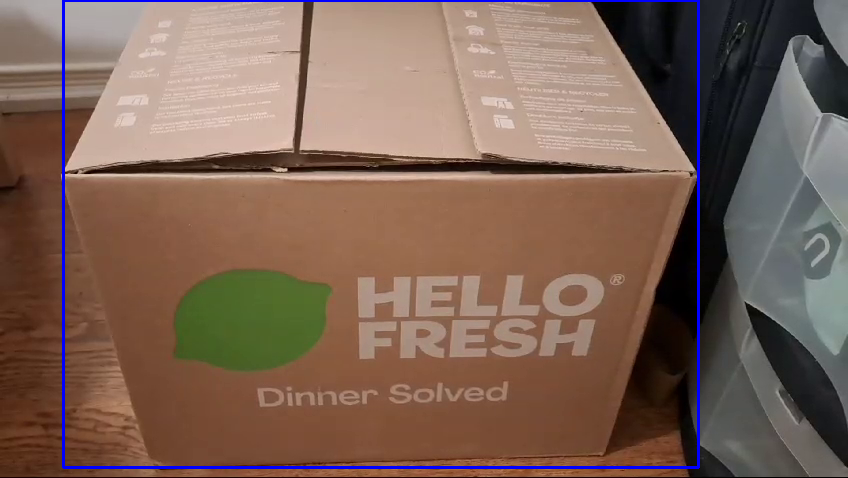


0: 384x640 (no detections), 13.4ms
Speed: 2.7ms preprocess, 13.4ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


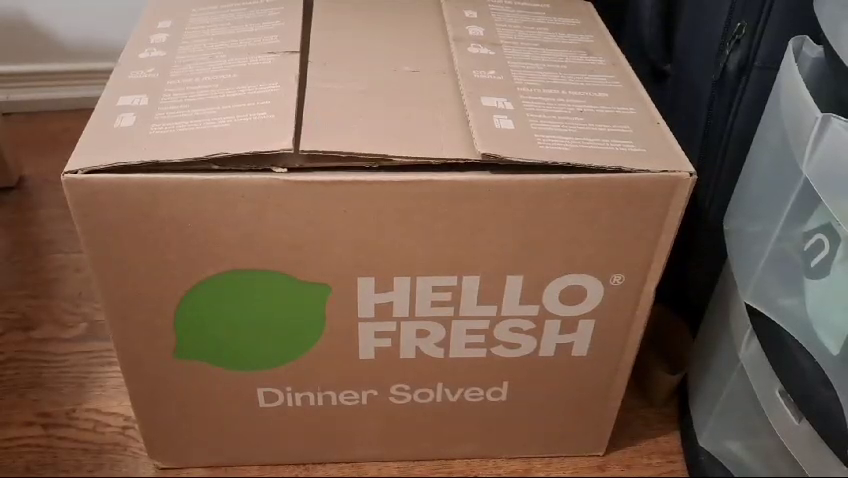


0: 384x640 1 laptop, 11.9ms
Speed: 2.6ms preprocess, 11.9ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: cardboard_boxes_recycling
Detected box: [     69.427           0      697.37      462.83]
Predicted category: recycling


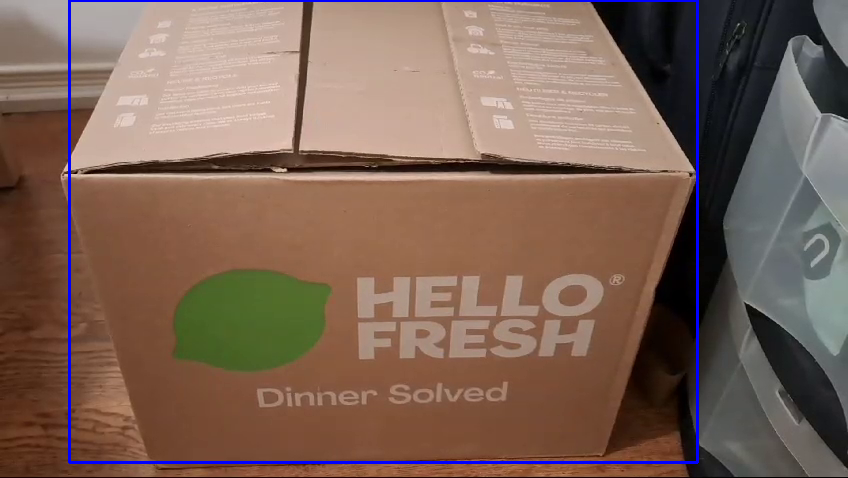


0: 384x640 1 laptop, 9.5ms
Speed: 2.6ms preprocess, 9.5ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: cardboard_boxes_recycling
Detected box: [      71.73           0      697.91      467.87]
Predicted category: recycling


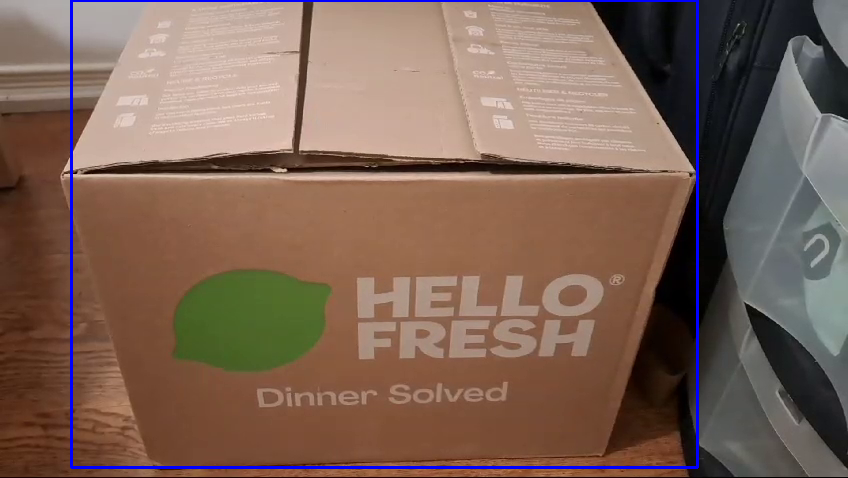


0: 384x640 1 laptop, 13.3ms
Speed: 5.0ms preprocess, 13.3ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: cardboard_boxes_recycling
Detected box: [     71.868           0      697.95      467.89]
Predicted category: recycling


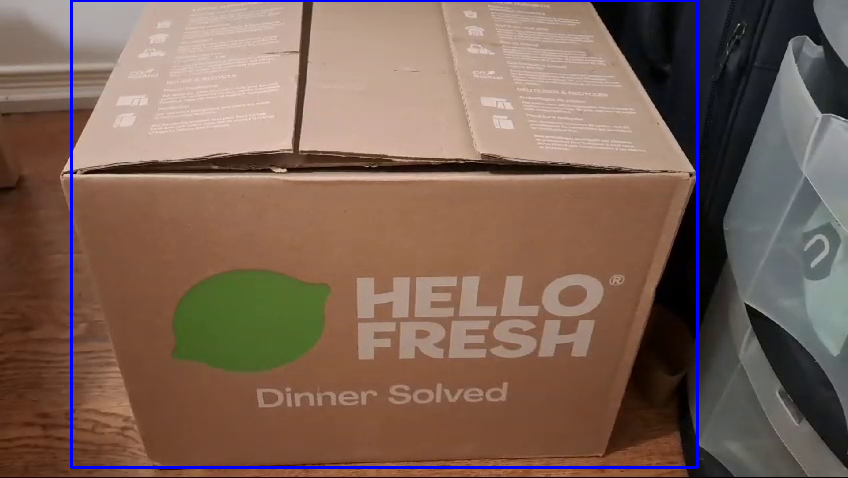


0: 384x640 1 laptop, 13.8ms
Speed: 2.7ms preprocess, 13.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: cardboard_boxes_recycling
Detected box: [     71.462           0      697.91      467.79]
Predicted category: recycling


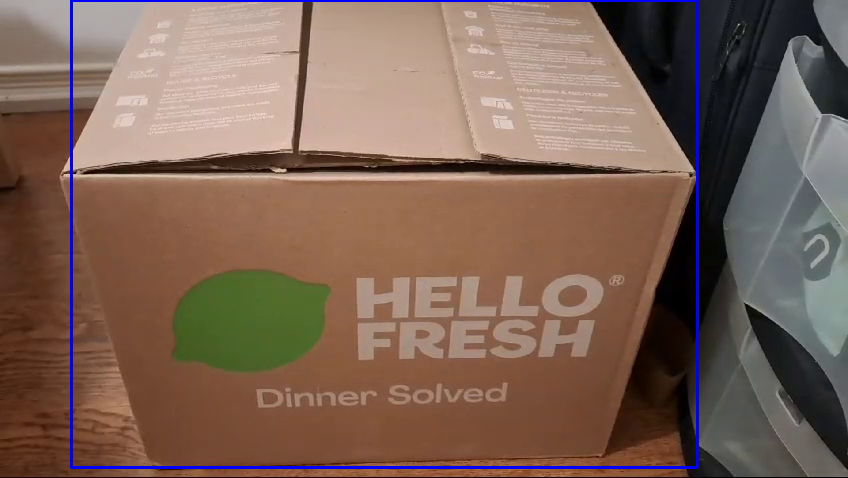


0: 384x640 1 laptop, 9.1ms
Speed: 2.6ms preprocess, 9.1ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: cardboard_boxes_recycling
Detected box: [     70.984           0      697.67       467.6]
Predicted category: recycling


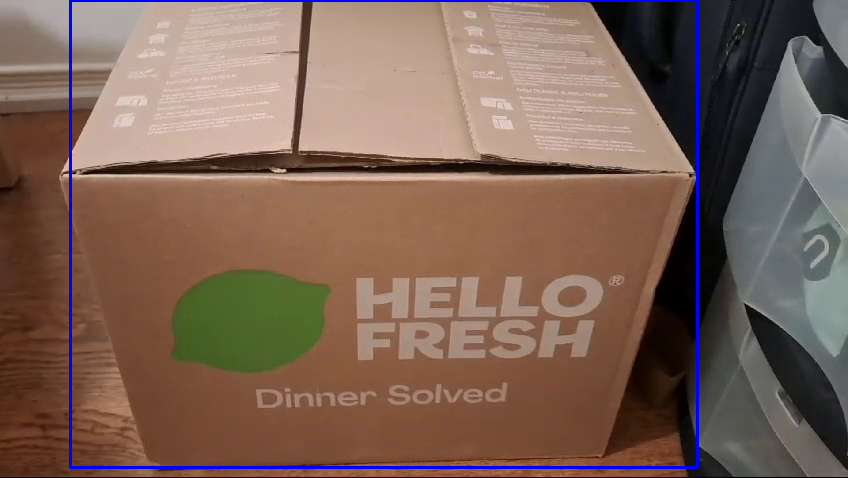


0: 384x640 1 laptop, 8.8ms
Speed: 2.6ms preprocess, 8.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: cardboard_boxes_recycling
Detected box: [     70.449           0      697.37      467.42]
Predicted category: recycling


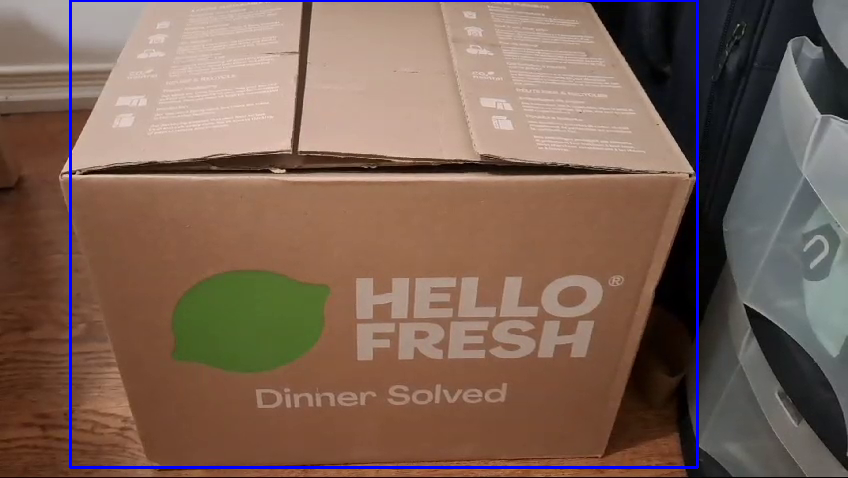


0: 384x640 2 laptops, 10.3ms
Speed: 2.7ms preprocess, 10.3ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: cardboard_boxes_recycling
Detected box: [     64.515           0      696.75      464.08]
Predicted category: recycling
Predicted classes: office_paper_recycling
Detected box: [     62.326           0      668.25      177.03]
Predicted category: recycling


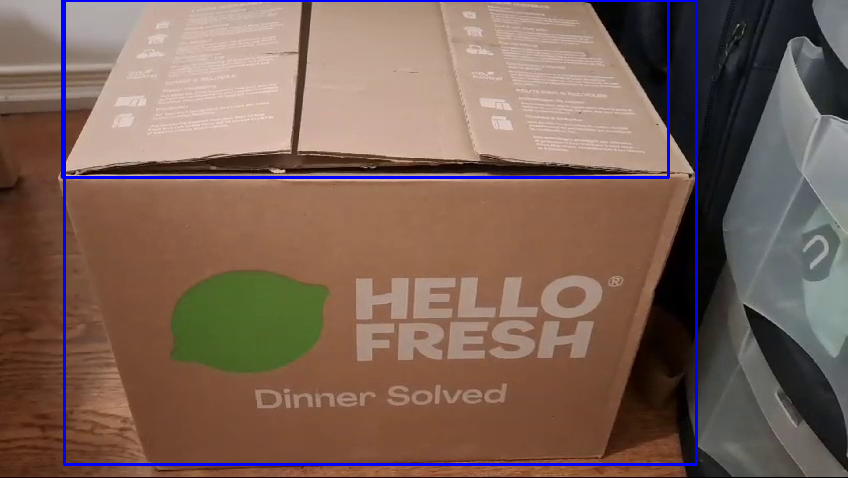


0: 384x640 1 laptop, 11.9ms
Speed: 2.8ms preprocess, 11.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: cardboard_boxes_recycling
Detected box: [     69.983           0      696.52      467.71]
Predicted category: recycling


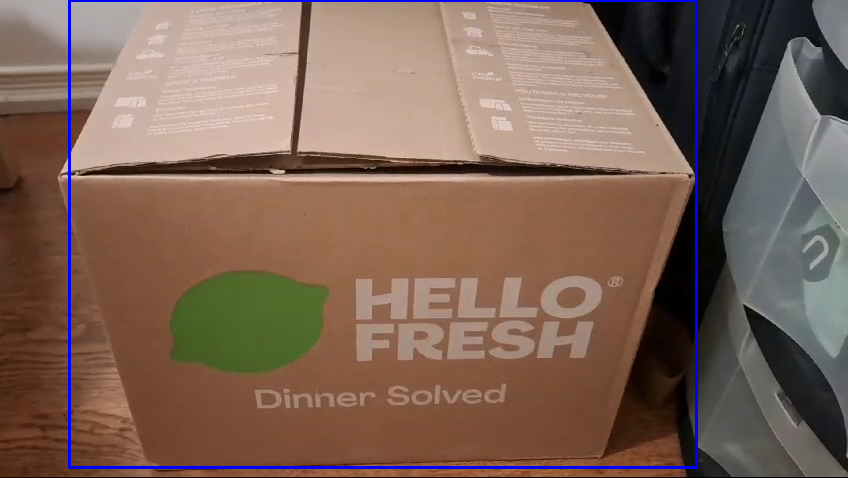


0: 384x640 1 laptop, 9.9ms
Speed: 2.7ms preprocess, 9.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: cardboard_boxes_recycling
Detected box: [      53.76           0      695.89      464.54]
Predicted category: recycling


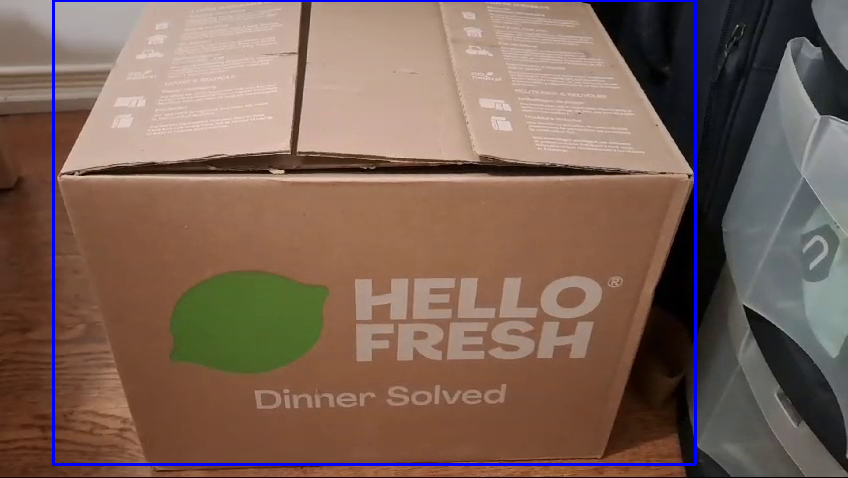


0: 384x640 2 laptops, 9.1ms
Speed: 2.6ms preprocess, 9.1ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: cardboard_boxes_recycling
Detected box: [     53.412           0      695.53      464.29]
Predicted category: recycling
Predicted classes: office_paper_recycling
Detected box: [     60.933           0      667.22      177.47]
Predicted category: recycling


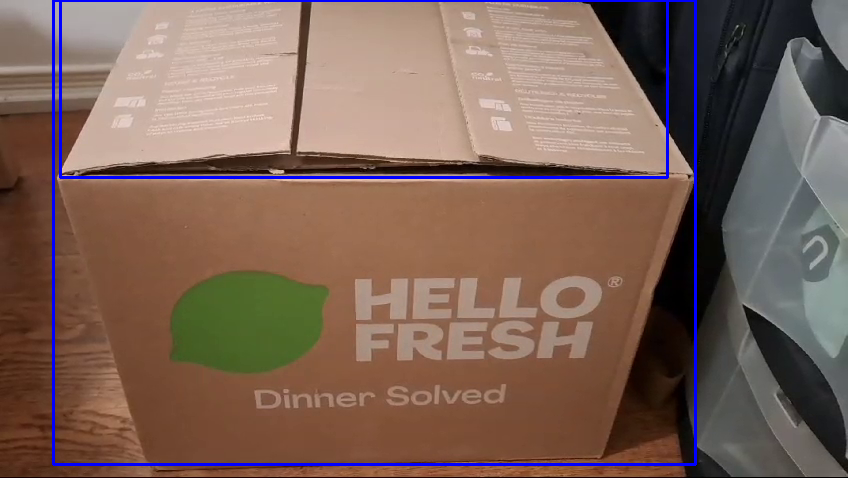


0: 384x640 1 laptop, 10.1ms
Speed: 2.7ms preprocess, 10.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: cardboard_boxes_recycling
Detected box: [     66.212           0      694.83      468.17]
Predicted category: recycling


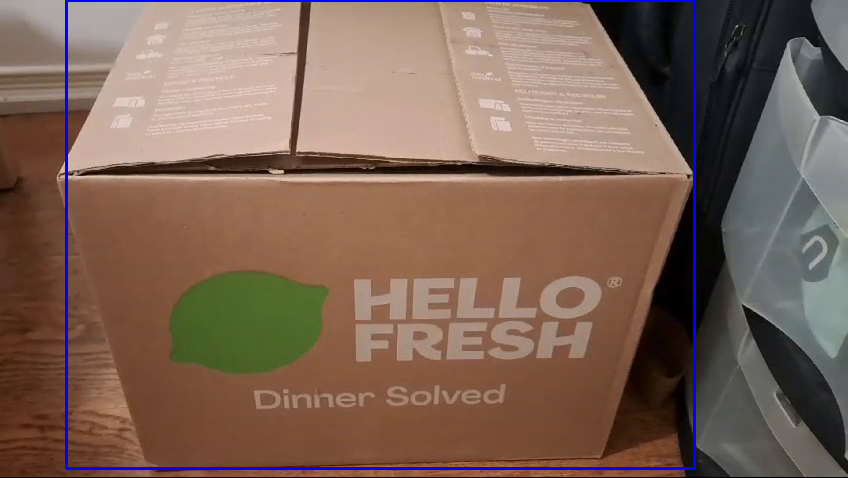


0: 384x640 1 laptop, 10.1ms
Speed: 2.5ms preprocess, 10.1ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: cardboard_boxes_recycling
Detected box: [     65.532           0      694.16      468.18]
Predicted category: recycling


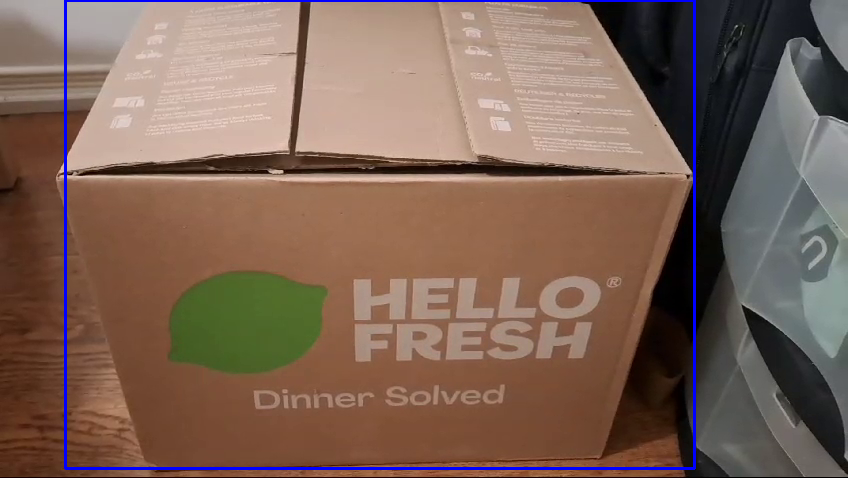


0: 384x640 1 laptop, 9.3ms
Speed: 2.7ms preprocess, 9.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: cardboard_boxes_recycling
Detected box: [      65.62           0      694.43      468.19]
Predicted category: recycling


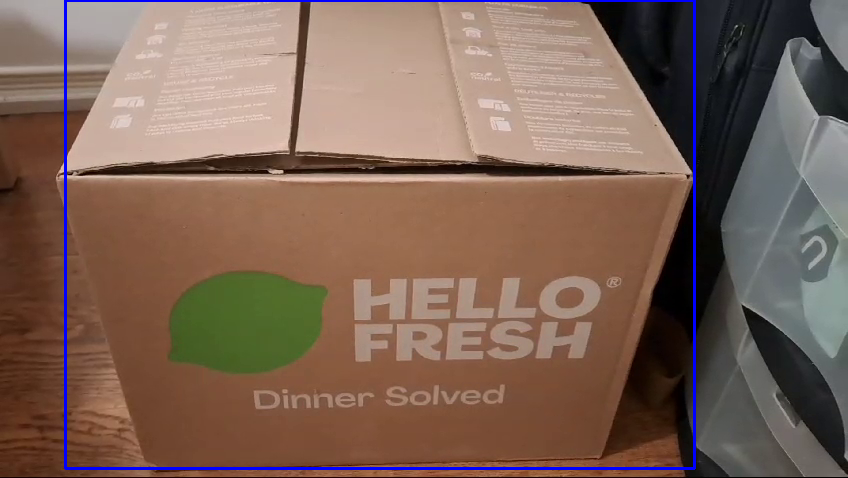


0: 384x640 1 cup, 11.9ms
Speed: 2.8ms preprocess, 11.9ms inference, 3.7ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     239.84      72.522      484.65       393.7]
Predicted category: recycling


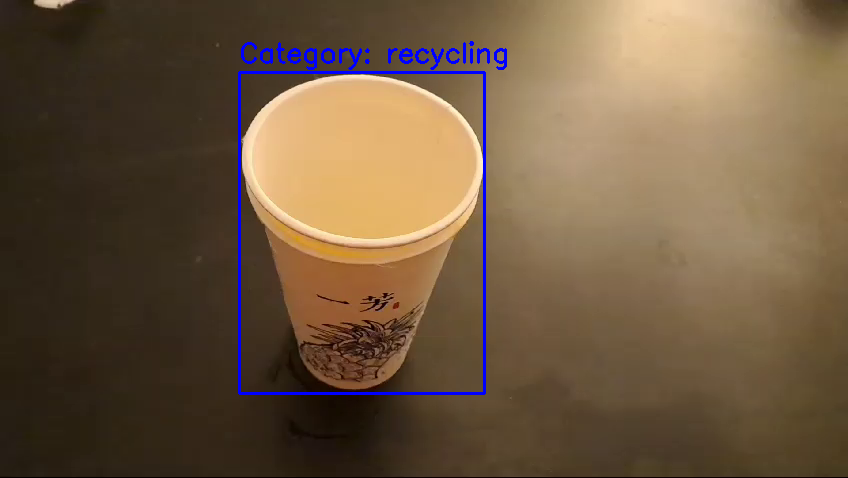


0: 384x640 1 cup, 1 dining table, 10.4ms
Speed: 2.8ms preprocess, 10.4ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     240.06      72.413      485.21      393.27]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     35.466     0.74301      841.63      466.83]
Predicted category: recycling


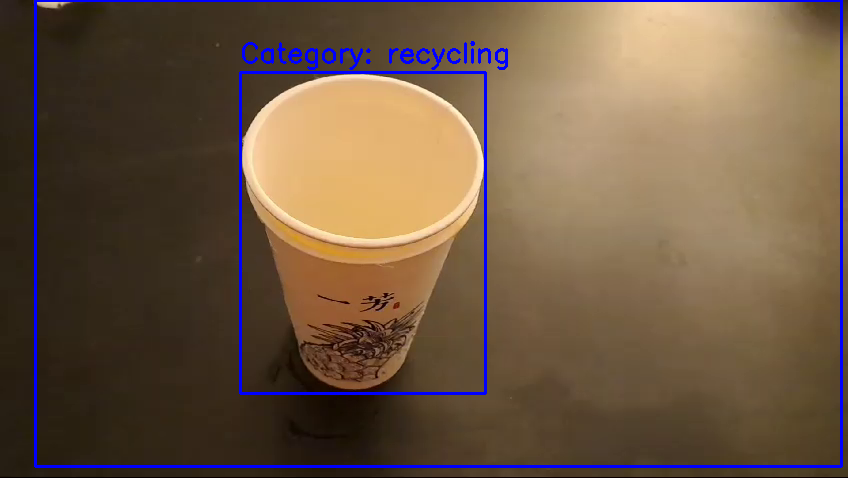


0: 384x640 1 cup, 1 dining table, 13.9ms
Speed: 2.6ms preprocess, 13.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     240.29      72.106      486.31      392.52]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     35.442      0.8667      841.89       466.1]
Predicted category: recycling


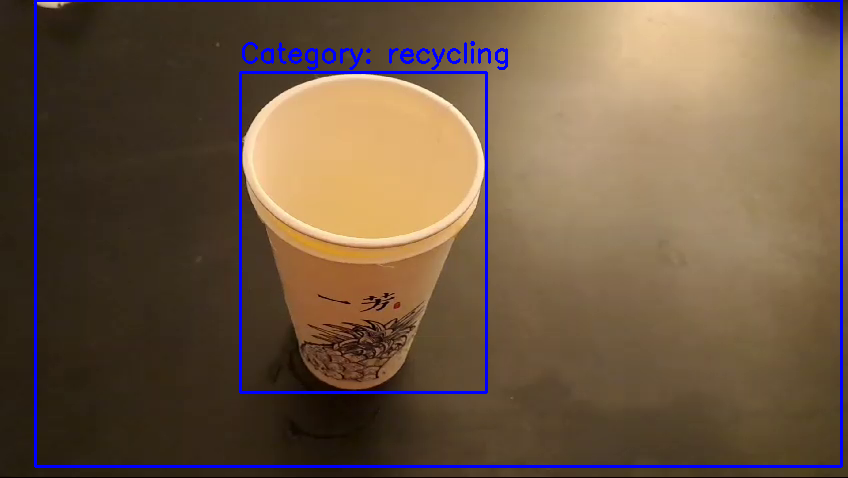


0: 384x640 1 cup, 1 dining table, 11.1ms
Speed: 4.6ms preprocess, 11.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     240.46      72.196      486.55      392.49]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     34.995     0.86233      841.24      466.03]
Predicted category: recycling


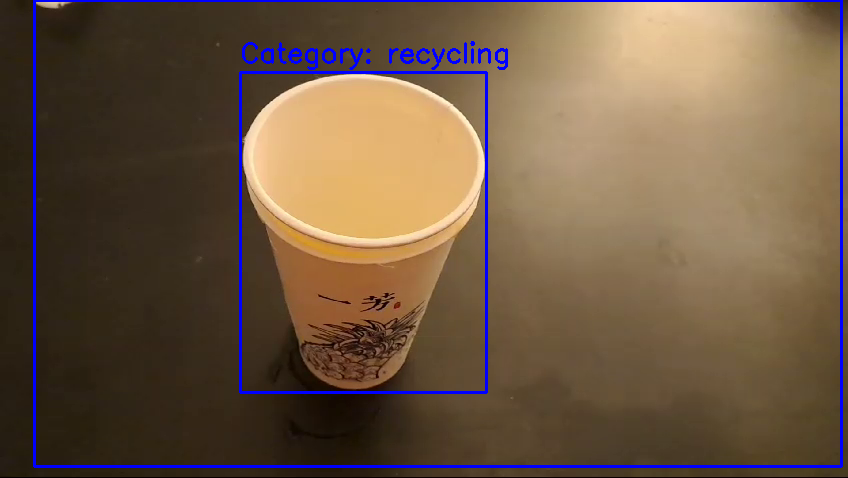


0: 384x640 1 cup, 1 dining table, 11.9ms
Speed: 2.7ms preprocess, 11.9ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     240.35      72.045      486.65      392.58]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     30.764     0.75433      841.34       465.8]
Predicted category: recycling


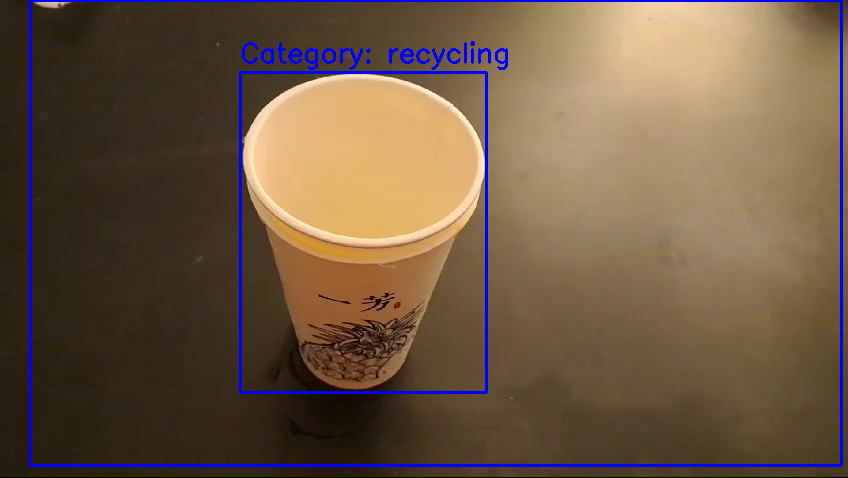


0: 384x640 1 cup, 1 dining table, 12.5ms
Speed: 2.7ms preprocess, 12.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [      240.3      72.239      486.44      391.95]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [      32.96     0.84664      841.12       465.6]
Predicted category: recycling


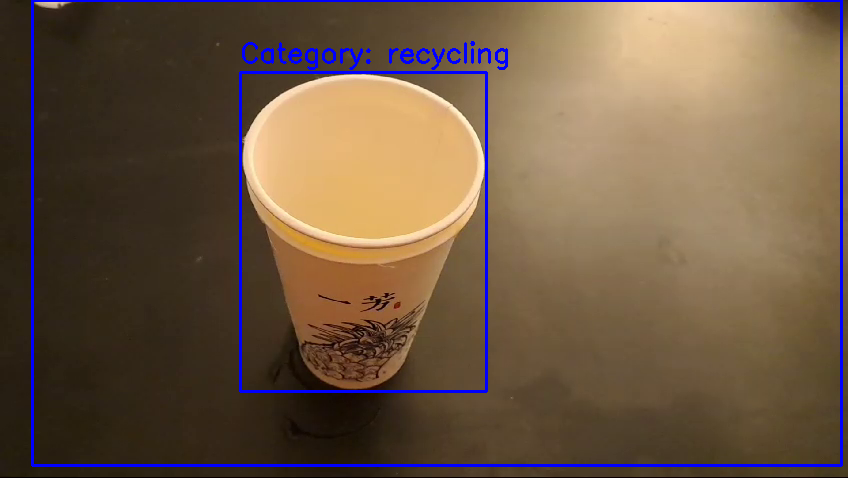


0: 384x640 1 cup, 1 dining table, 12.8ms
Speed: 2.7ms preprocess, 12.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     240.39      72.073      486.11       392.1]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     31.911     0.81664      841.35      465.53]
Predicted category: recycling


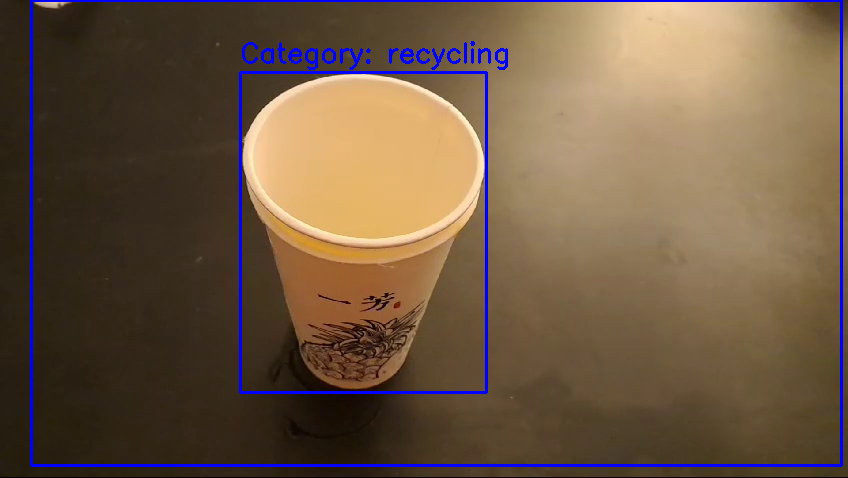


0: 384x640 1 cup, 1 dining table, 12.7ms
Speed: 2.8ms preprocess, 12.7ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [      240.6      72.059      486.53      392.82]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     31.935     0.84673      841.31      465.85]
Predicted category: recycling


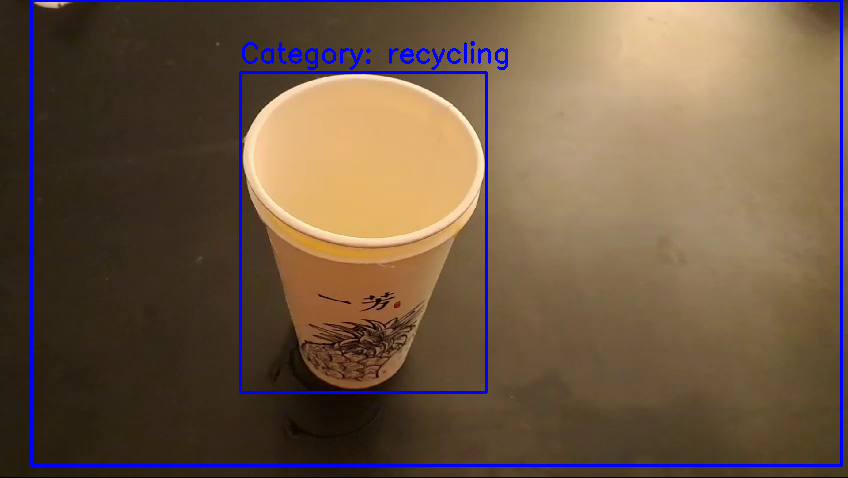


0: 384x640 1 cup, 1 dining table, 9.9ms
Speed: 2.7ms preprocess, 9.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     240.68      71.862      486.56      391.81]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     31.168     0.92432      841.03      465.86]
Predicted category: recycling


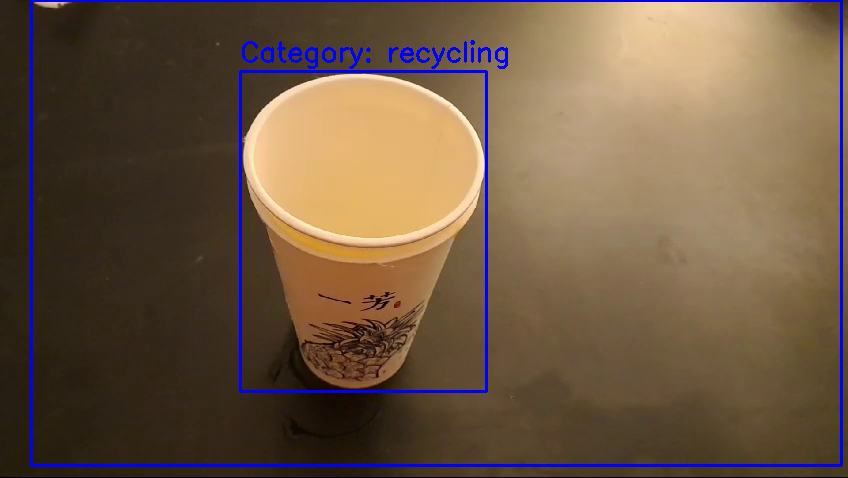


0: 384x640 1 cup, 1 dining table, 12.4ms
Speed: 2.7ms preprocess, 12.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     240.85      71.767      486.82      390.89]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     32.306      1.0419      841.18      465.57]
Predicted category: recycling


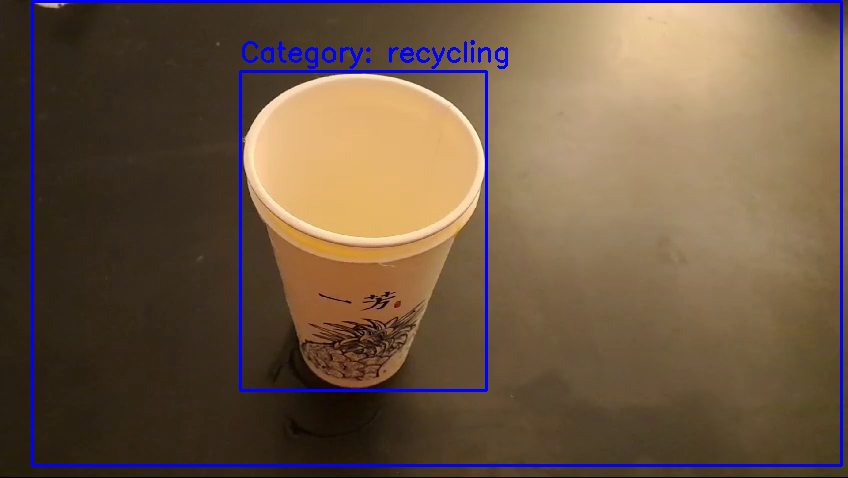


0: 384x640 1 cup, 1 dining table, 12.1ms
Speed: 2.7ms preprocess, 12.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     241.46      71.389      486.88      390.17]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     29.019      1.0434      840.91      465.26]
Predicted category: recycling


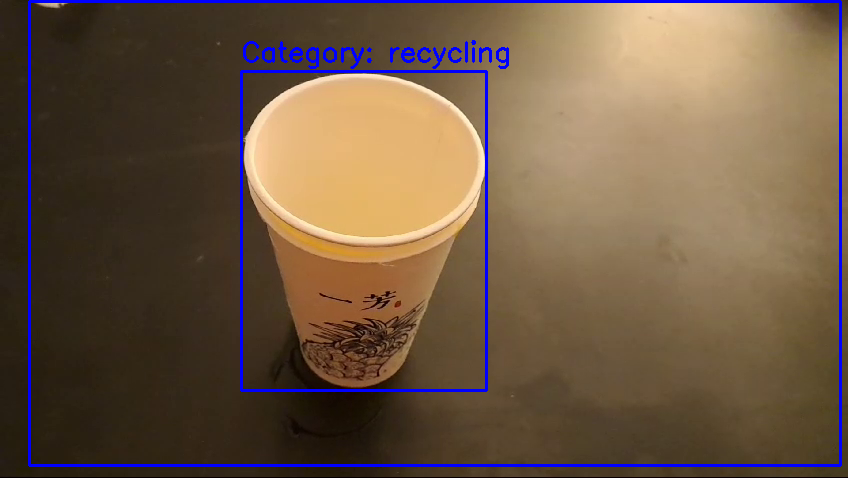


0: 384x640 1 cup, 1 dining table, 10.0ms
Speed: 2.8ms preprocess, 10.0ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     241.49      70.771       486.9      390.91]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     30.762     0.98781      841.45      464.97]
Predicted category: recycling


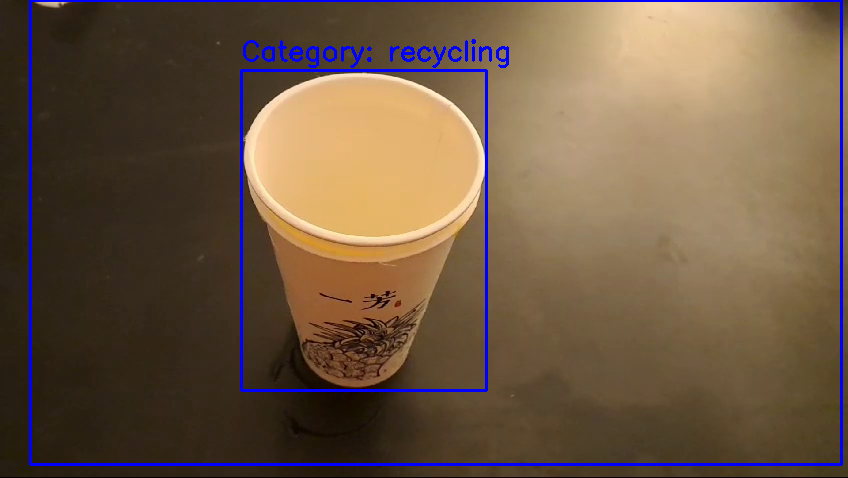


0: 384x640 1 cup, 1 dining table, 12.0ms
Speed: 6.5ms preprocess, 12.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     241.79      70.773         487      390.57]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     30.308     0.90609      841.51      465.37]
Predicted category: recycling


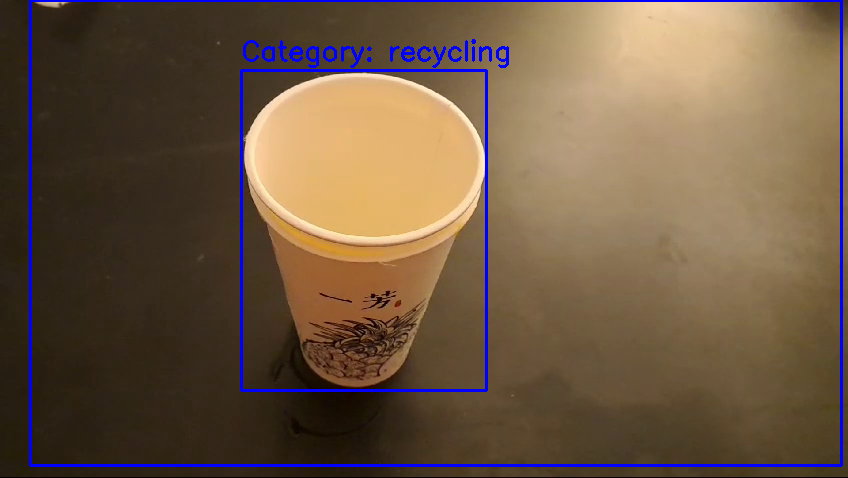


0: 384x640 1 cup, 1 dining table, 20.0ms
Speed: 2.6ms preprocess, 20.0ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     241.67      70.412      487.09      390.23]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     29.804     0.93819      841.59      465.15]
Predicted category: recycling


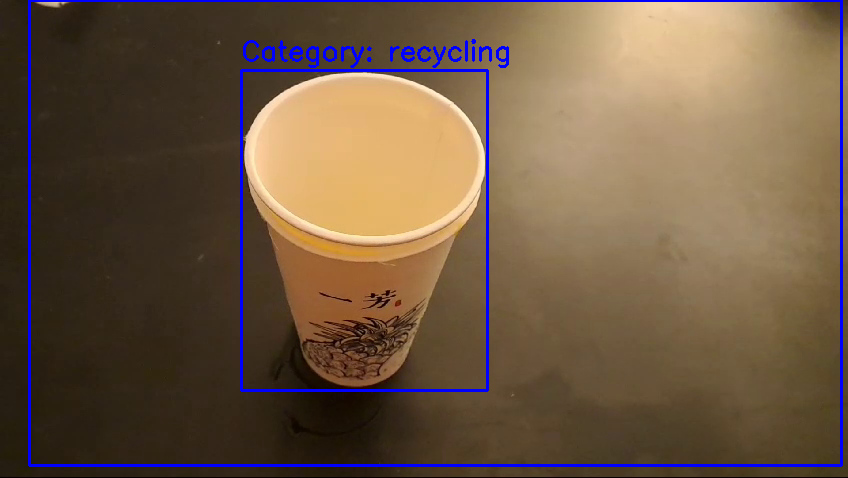


0: 384x640 1 cup, 1 dining table, 9.2ms
Speed: 2.7ms preprocess, 9.2ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     241.61       70.37       487.1       390.2]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     30.832     0.98688      841.56      465.08]
Predicted category: recycling


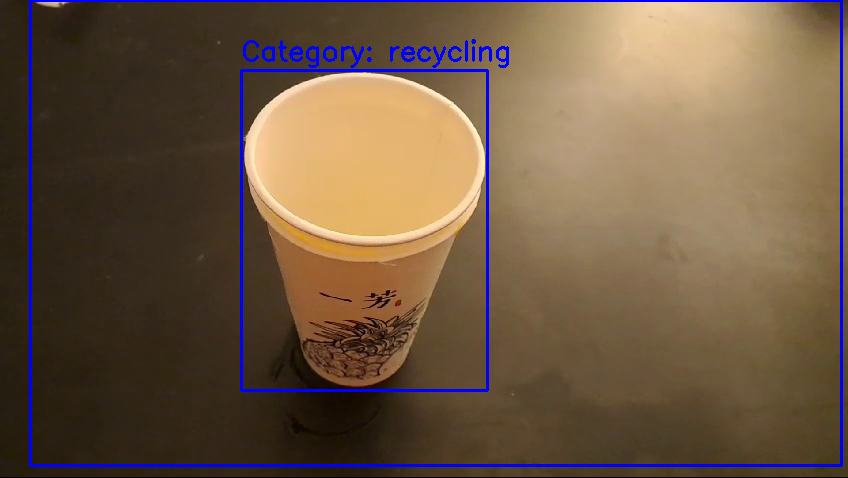


0: 384x640 1 cup, 1 dining table, 9.7ms
Speed: 2.7ms preprocess, 9.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     241.94       70.08      487.11      389.23]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     30.026     0.71826      841.48         465]
Predicted category: recycling


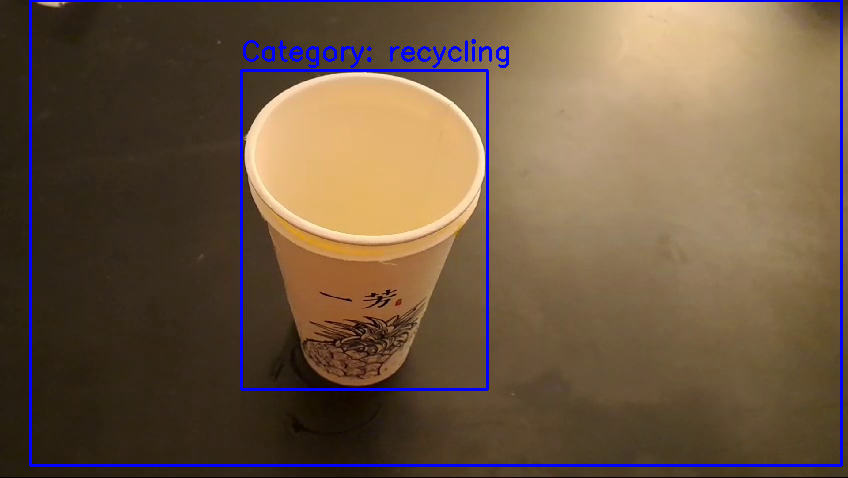


0: 384x640 1 cup, 1 dining table, 18.9ms
Speed: 2.8ms preprocess, 18.9ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     242.38      69.782      487.09      388.74]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     31.678     0.78826      841.54       464.9]
Predicted category: recycling


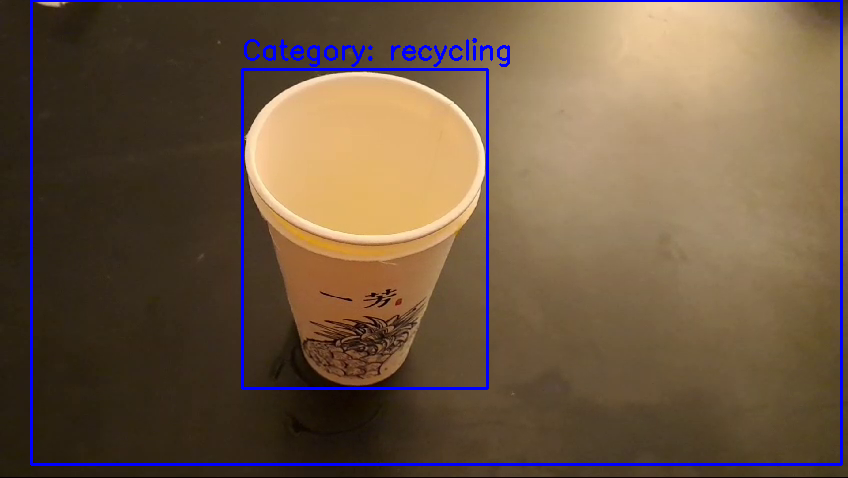


0: 384x640 1 cup, 1 dining table, 9.4ms
Speed: 2.7ms preprocess, 9.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     242.52      69.294      487.04      388.62]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     29.369       0.861      841.26      464.97]
Predicted category: recycling


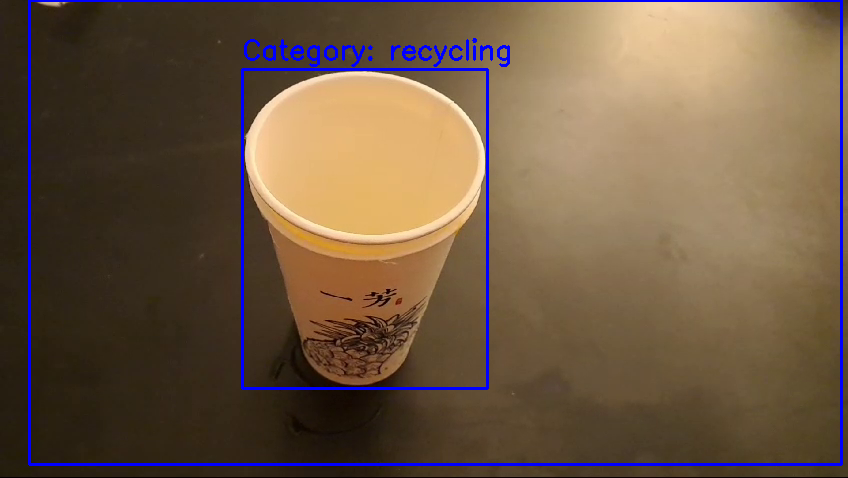


0: 384x640 1 cup, 1 dining table, 13.5ms
Speed: 2.8ms preprocess, 13.5ms inference, 5.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     242.52      68.954      487.27      387.68]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     36.462      1.1459      841.04      465.39]
Predicted category: recycling


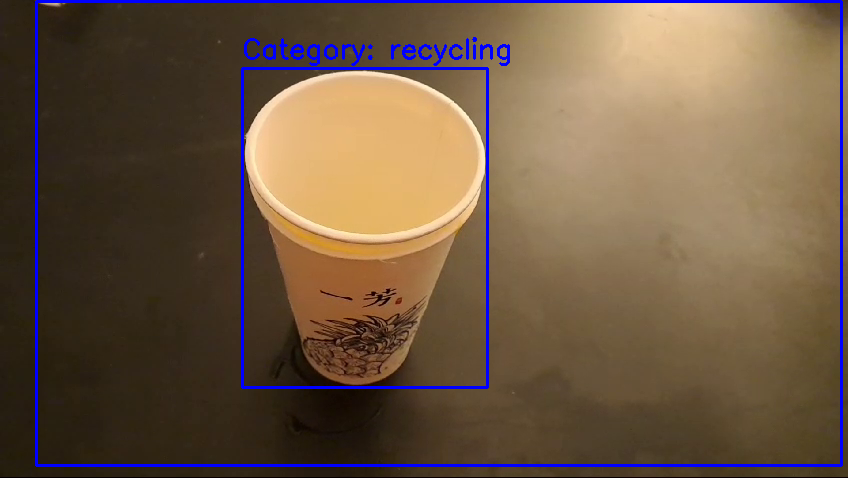


0: 384x640 1 cup, 1 dining table, 12.4ms
Speed: 2.9ms preprocess, 12.4ms inference, 5.2ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     242.76      68.536      487.61      387.42]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     38.806      1.1993      841.15      465.45]
Predicted category: recycling


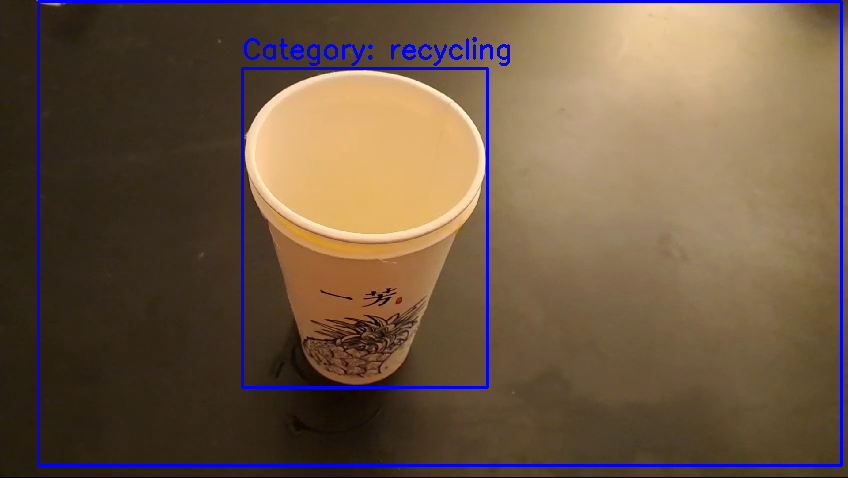


0: 384x640 1 cup, 1 dining table, 14.1ms
Speed: 2.8ms preprocess, 14.1ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     242.84      68.328       487.5       386.7]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     40.569      1.1939      841.28      465.36]
Predicted category: recycling


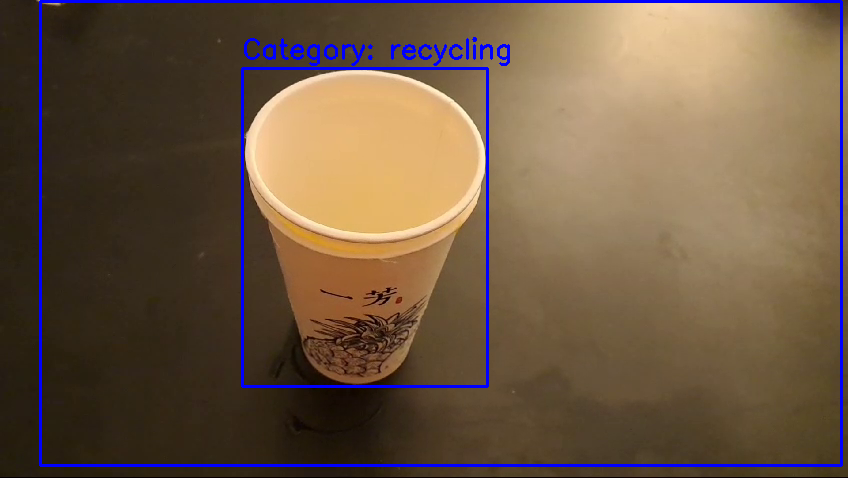


0: 384x640 1 cup, 1 dining table, 10.1ms
Speed: 2.6ms preprocess, 10.1ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [      243.5      68.159      488.19      389.25]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     40.318       1.348      841.11      465.06]
Predicted category: recycling


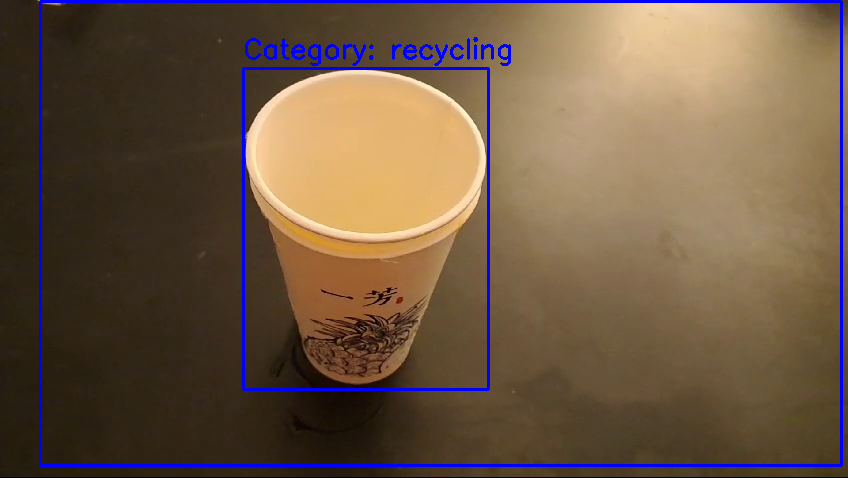


0: 384x640 1 cup, 1 dining table, 9.5ms
Speed: 2.7ms preprocess, 9.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     243.94      68.052      488.83      387.35]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     33.411       1.066       840.8      465.08]
Predicted category: recycling


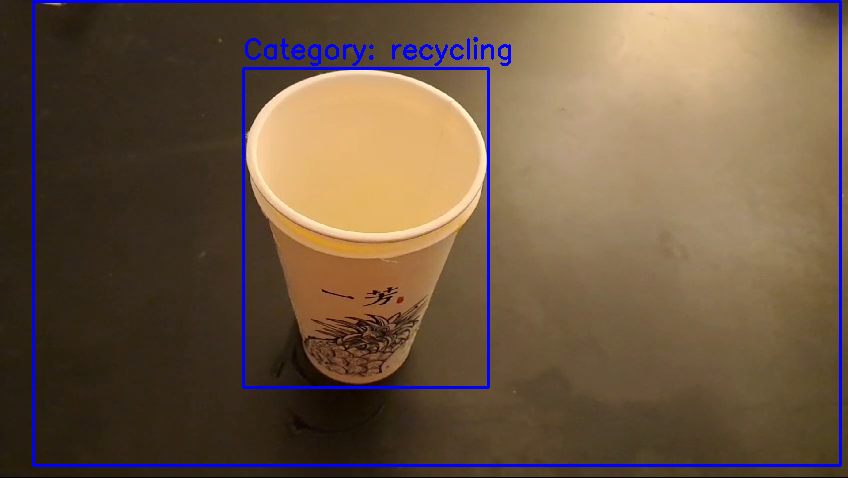


0: 384x640 1 cup, 1 dining table, 9.4ms
Speed: 2.6ms preprocess, 9.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     244.35      68.018      489.45      387.55]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     33.587      1.2837       841.1      465.22]
Predicted category: recycling


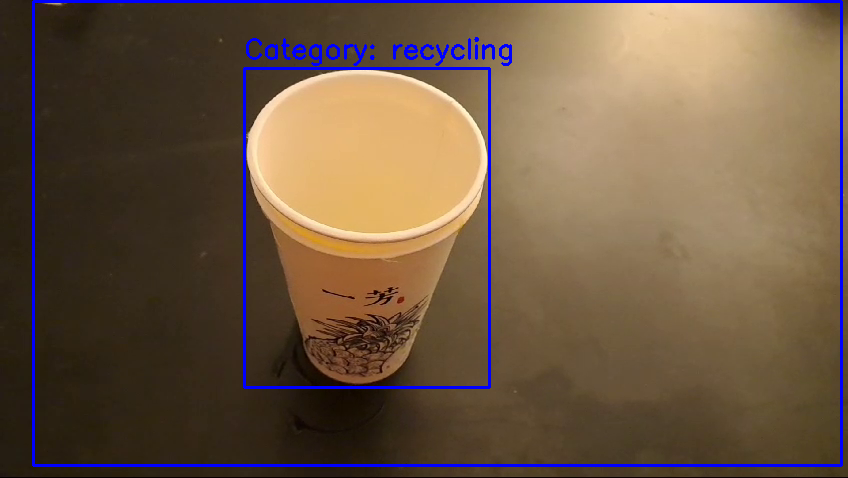


0: 384x640 1 cup, 1 dining table, 9.7ms
Speed: 2.8ms preprocess, 9.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     245.52      68.523      489.49      387.18]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     34.455      1.4335       841.3      465.37]
Predicted category: recycling


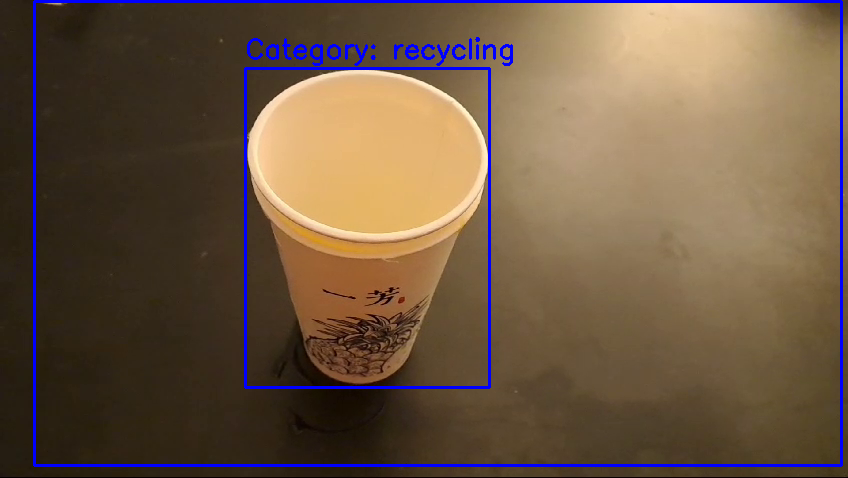


0: 384x640 1 cup, 1 dining table, 9.3ms
Speed: 2.7ms preprocess, 9.3ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     246.18      68.426      489.98      386.66]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     32.708      1.3822      840.88      465.11]
Predicted category: recycling


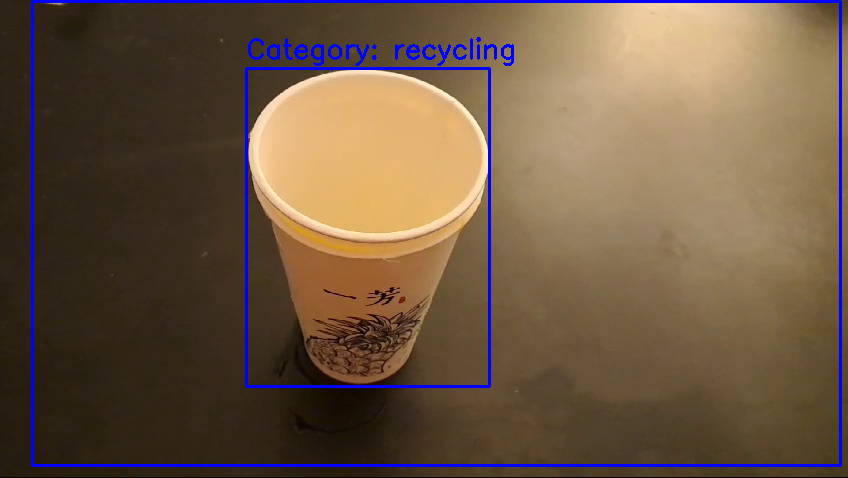


0: 384x640 1 cup, 1 dining table, 9.0ms
Speed: 2.6ms preprocess, 9.0ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [        247      68.572      490.54      386.42]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     32.276      1.3933      840.89      467.27]
Predicted category: recycling


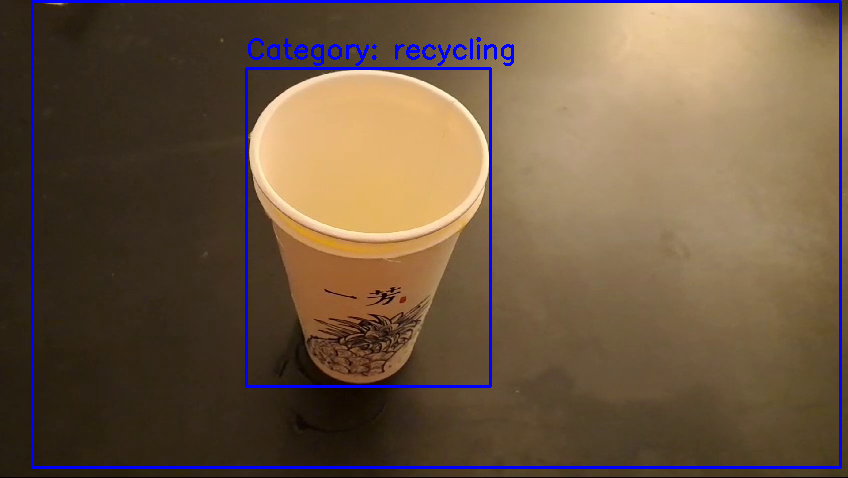


0: 384x640 1 cup, 1 dining table, 9.0ms
Speed: 2.8ms preprocess, 9.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     248.23      68.422      491.55      385.88]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     36.077      1.4001      840.85      465.02]
Predicted category: recycling


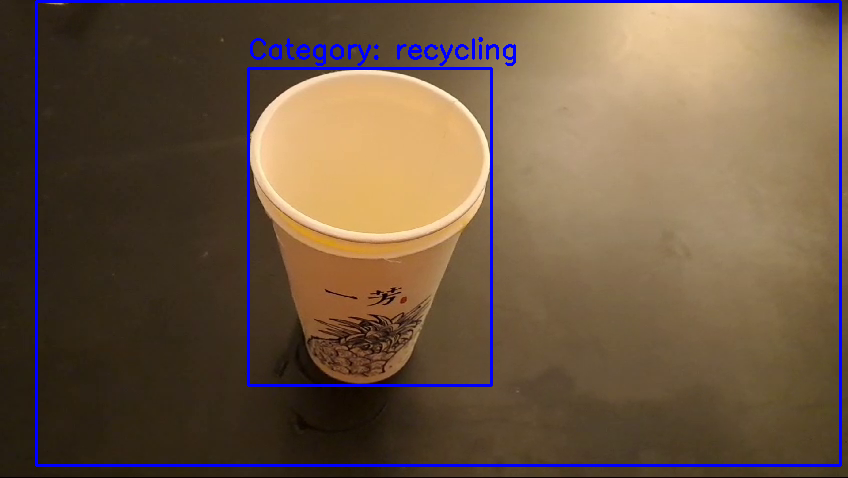


0: 384x640 1 cup, 1 dining table, 9.1ms
Speed: 2.7ms preprocess, 9.1ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     248.58      68.531      492.68      386.24]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     31.162      1.3093      840.72      464.88]
Predicted category: recycling


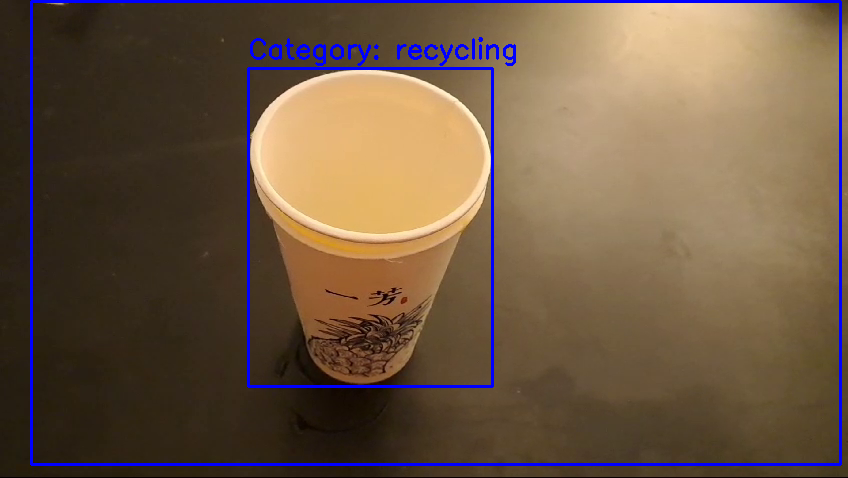


0: 384x640 1 cup, 1 dining table, 9.2ms
Speed: 2.8ms preprocess, 9.2ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     248.89      68.474      493.09      386.33]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [      31.62      1.4495      840.63      464.88]
Predicted category: recycling


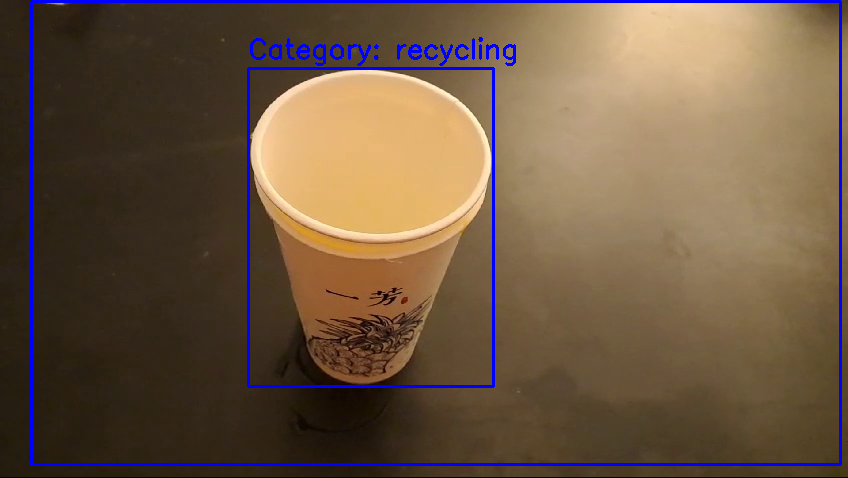


0: 384x640 1 cup, 1 dining table, 9.9ms
Speed: 2.6ms preprocess, 9.9ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     249.47      68.559      493.35      386.15]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     32.787      1.4548      840.14      464.54]
Predicted category: recycling


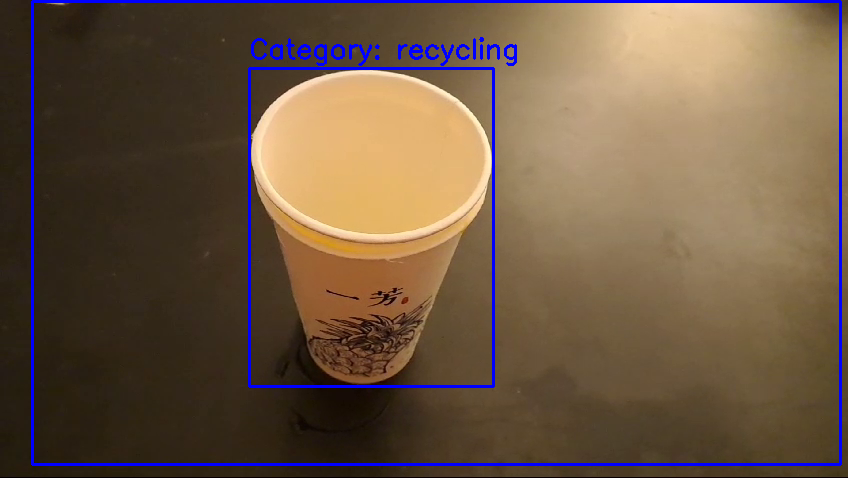


0: 384x640 1 cup, 1 dining table, 9.2ms
Speed: 2.8ms preprocess, 9.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     249.73      68.513      493.62      386.03]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [      28.22      1.3467      840.09      466.09]
Predicted category: recycling


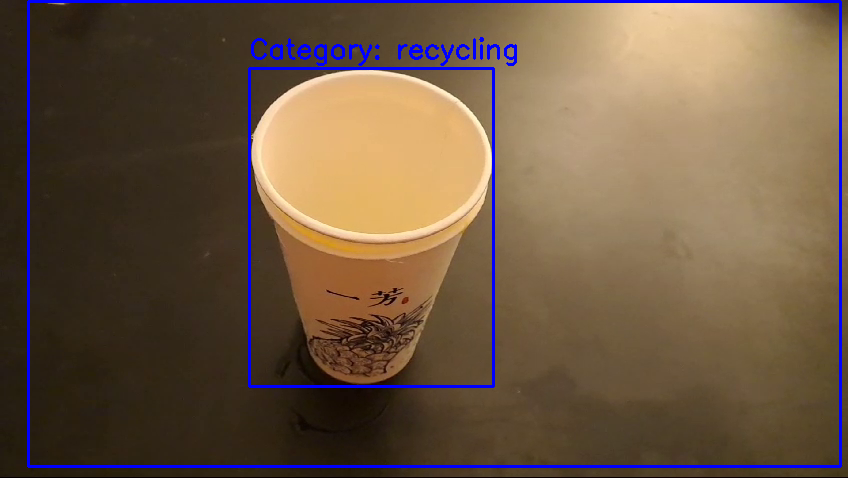


0: 384x640 1 cup, 1 dining table, 9.4ms
Speed: 2.5ms preprocess, 9.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [      249.9      68.508       493.7      385.98]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     36.393      1.6085      840.16      464.66]
Predicted category: recycling


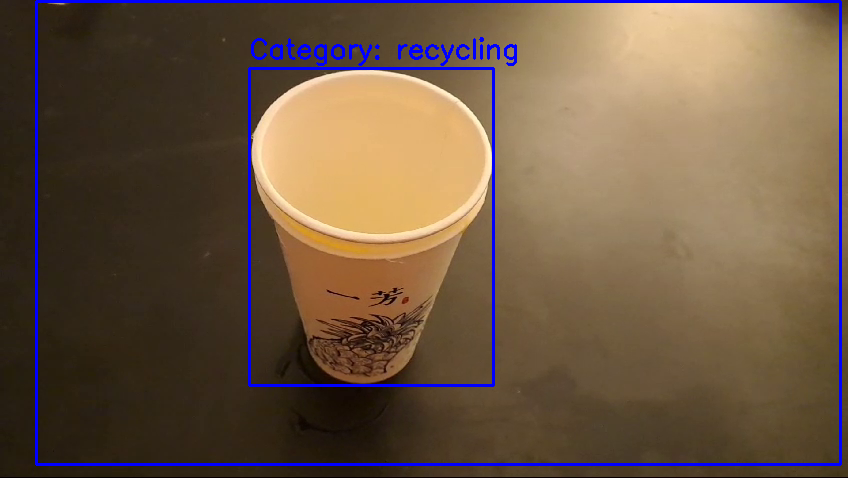


0: 384x640 1 cup, 1 dining table, 14.6ms
Speed: 2.9ms preprocess, 14.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     249.86      68.297      493.56      385.63]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     35.019      1.5838      840.07      464.63]
Predicted category: recycling


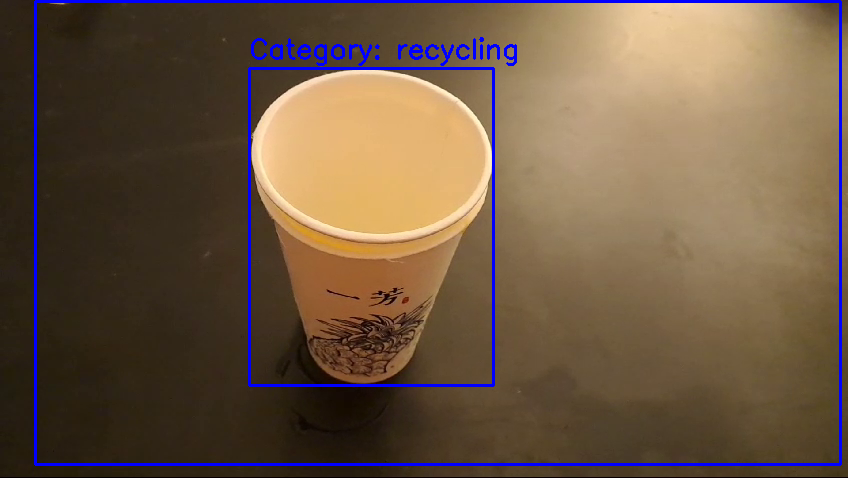


0: 384x640 1 cup, 1 dining table, 10.7ms
Speed: 3.2ms preprocess, 10.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     249.78      68.038       493.6      386.01]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     32.839      1.6773      839.97      464.52]
Predicted category: recycling


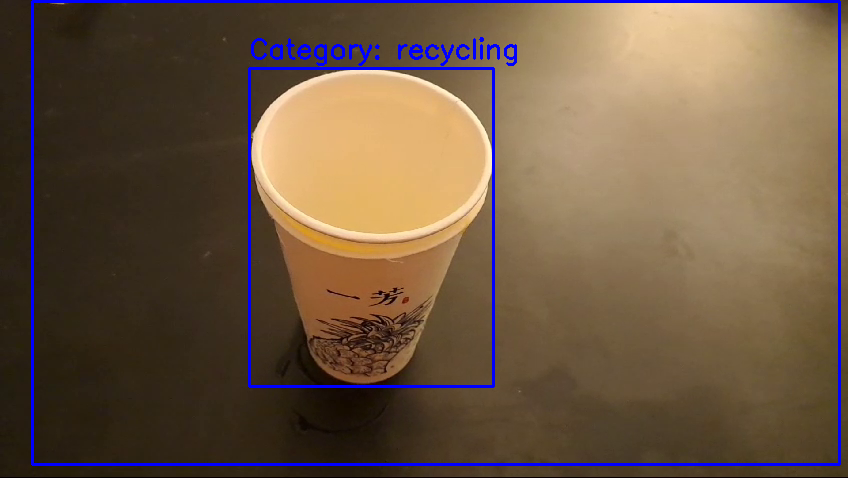


0: 384x640 1 cup, 1 dining table, 13.5ms
Speed: 2.9ms preprocess, 13.5ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     249.81      67.541      494.19      386.12]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     32.642      1.5832       839.7      464.82]
Predicted category: recycling


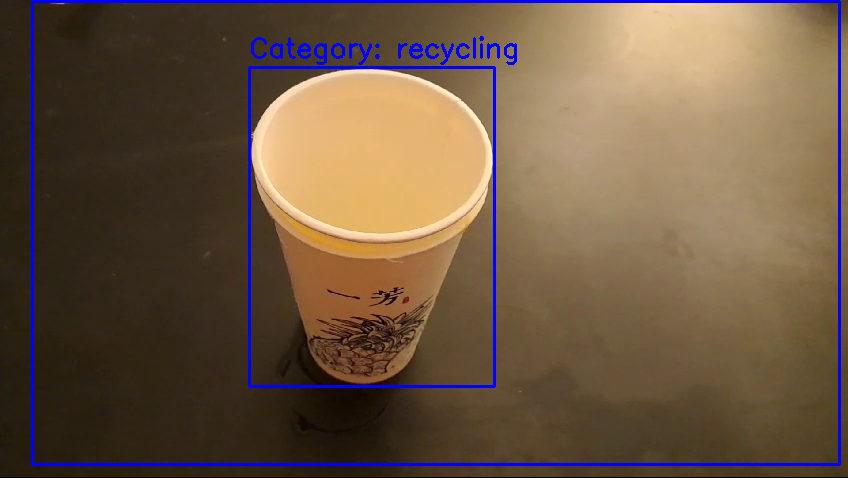


0: 384x640 1 cup, 1 dining table, 9.4ms
Speed: 2.7ms preprocess, 9.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     250.33      67.125      494.68      385.63]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     30.354      1.2557      839.47      466.53]
Predicted category: recycling


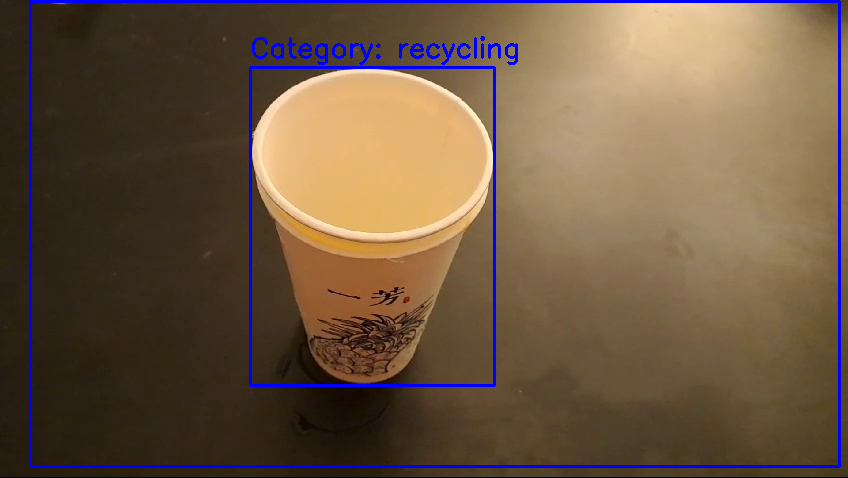


0: 384x640 1 cup, 1 dining table, 9.0ms
Speed: 2.6ms preprocess, 9.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     249.76      67.132      494.69      385.76]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     30.746      1.2941      839.92       466.4]
Predicted category: recycling


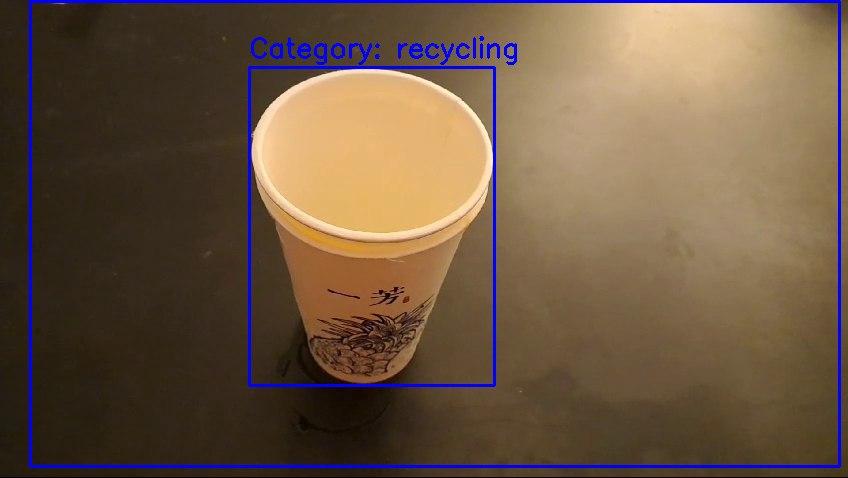


0: 384x640 1 cup, 1 dining table, 9.5ms
Speed: 2.5ms preprocess, 9.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     250.86      67.385      495.82      385.79]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     32.521      1.1927      839.56      467.47]
Predicted category: recycling


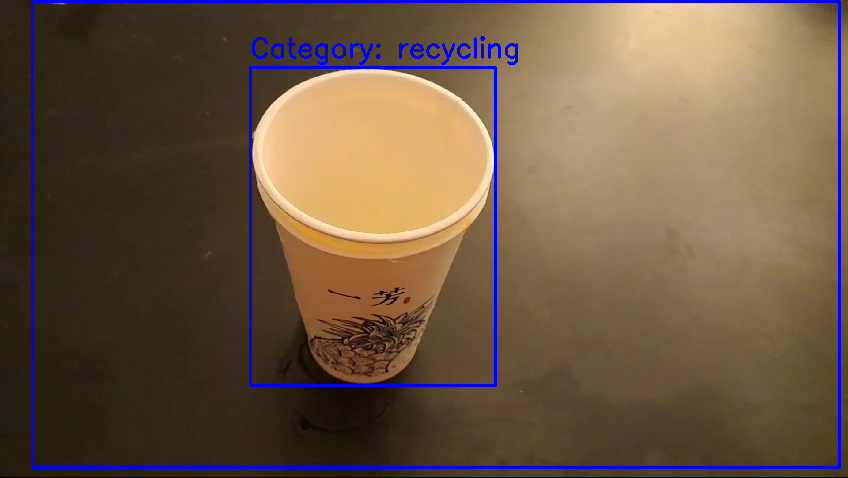


0: 384x640 1 cup, 1 dining table, 15.5ms
Speed: 4.1ms preprocess, 15.5ms inference, 2.9ms postprocess per image at shape (1, 3, 384, 640)
Predicted classes: paper_cups_recycling
Detected box: [     250.06      65.702      495.93      385.65]
Predicted category: recycling
Predicted classes: paper_cups_recycling
Detected box: [     32.003      1.2126      839.43      467.58]
Predicted category: recycling


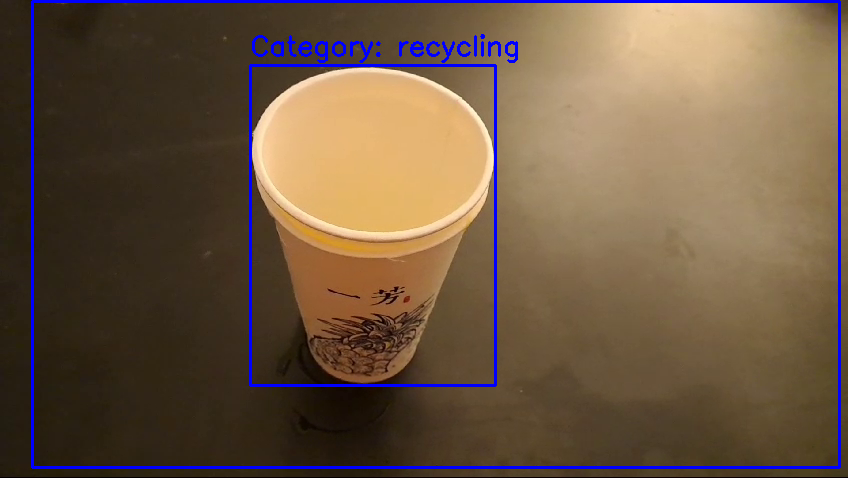

In [9]:
# Load YOLOv8 model
yolo_model = YOLO('yolov8n.pt')

num_class = 30
batch_size = 64
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Load your custom classification model
class CustomResNet(Module):
    def __init__(self):
        super().__init__()
        resnet = models.resnet34(pretrained=True)
        num_ftrs = resnet.fc.in_features
        resnet.fc = nn.Linear(num_ftrs, num_class)
        self.model = resnet

    def forward(self, image):
        x = self.model(image)
        return x

model = CustomResNet()
model.load_state_dict(torch.load('model.pth'))
model = model.to(device)
model.eval()

# Define the transformation for classification model
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Initialize video capture
cap = cv2.VideoCapture("test_sort2.mp4")

# Get the width and height of the frames
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

iou_threshold = 0.65

# Initialize VideoWriter object
out = cv2.VideoWriter('output_video.mp4', cv2.VideoWriter_fourcc(*'mp4v'), 30, (frame_width, frame_height))

while True:
    ret, frame = cap.read()
    if not ret:
        break

    # Perform object detection with YOLOv8
    results = yolo_model(frame)

    for result in results:
        detected_boxes = []
        boxes = result.boxes.xyxy.cpu().numpy()  # Bounding boxes
        if result.boxes is None:
            continue
        for box in boxes:
            x1, y1, x2, y2 = map(int, box)
            current_box = [x1, y1, x2, y2]

            # Check IoU with previously detected boxes
            if all(calculate_iou(current_box, prev_box) < iou_threshold for prev_box in detected_boxes):
                detected_boxes.append(current_box)

                # Extract the detected object
                detected_object = frame[y1:y2, x1:x2]

                # Convert the detected object to PIL image
                img = Image.fromarray(cv2.cvtColor(detected_object, cv2.COLOR_BGR2RGB))

                # Preprocess the detected object
                img = transform(img).unsqueeze(0).to(device)  # Add batch dimension

                # Classify the detected object
                with torch.no_grad():
                    outputs = model(img)
                    _, predicted = torch.max(outputs, 1)
                    class_id = predicted.item()

                predicted_labels = index_to_class[class_id]
                category = get_category(predicted_labels)
                print(f'Predicted classes: {predicted_labels}')
                print(f'Detected box: {box}')
                print(f'Predicted category: {category}')

                # Draw bounding box and classification result
                cv2.rectangle(frame, (x1, y1), (x2, y2), (255, 0, 0), 2)
                cv2.putText(frame, f'Category: {category}', (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (255, 0, 0), 2)

    # Display the result
    cv2_imshow(frame)
    # Write the frame to the output video
    out.write(frame)

    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

cap.release()
out.release()
cv2.destroyAllWindows()


In [ ]:
# Display the output video
cap = cv2.VideoCapture('output_video.mp4')
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break
    cv2.imshow('Output Video', frame)
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break
cap.release()
cv2.destroyAllWindows()